# Build a Conditional GAN

#### Packages and Visualization

In [1]:
import torch
from torch import nn
from tqdm.auto import tqdm
from torchvision import transforms
from torchvision.datasets import MNIST
from torchvision.utils import make_grid
from torch.utils.data import DataLoader
from torchvision import transforms, datasets
import matplotlib.pyplot as plt
torch.manual_seed(0)

def show_tensor_images(image_tensor, num_images=25, size=(1, 28, 28), nrow=5, show=True):
    '''
    Function for visualizing images: Given a tensor of images, number of images, and
    size per image, plots and prints the images in an uniform grid.
    '''
    image_tensor = (image_tensor + 1) / 2
    image_unflat = image_tensor.detach().cpu()
    image_grid = make_grid(image_unflat[:num_images], nrow=nrow)
    plt.imshow(image_grid.permute(1, 2, 0).squeeze())
    if show:
        plt.show()

C:\Users\wn00217454\Anaconda3\envs\cv\lib\site-packages\tqdm\auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm
C:\Users\wn00217454\Anaconda3\envs\cv\lib\site-packages\torchvision\io\image.py:13: UserWarning: Failed to load image Python extension: 'Could not find module 'C:\Users\wn00217454\Anaconda3\envs\cv\Lib\site-packages\torchvision\image.pyd' (or one of its dependencies). Try using the full path with constructor syntax.'If you don't plan on using image functionality from `torchvision.io`, you can ignore this warning. Otherwise, there might be something wrong with your environment. Did you have `libjpeg` or `libpng` installed before building `torchvision` from source?
  warn(


#### Generator and Noise

In [2]:
class Generator(nn.Module):

    
    def __init__(self, input_dim=10, im_chan=3, hidden_dim=64):
        super(Generator, self).__init__()
        self.input_dim = input_dim
        # Build the neural network
        self.gen = nn.Sequential(
            self.make_gen_block(input_dim, hidden_dim * 4),
            self.make_gen_block(hidden_dim * 4, hidden_dim * 2, kernel_size=4, stride=1),
            self.make_gen_block(hidden_dim * 2, hidden_dim),
            self.make_gen_block(hidden_dim, hidden_dim),
            self.make_gen_block(hidden_dim, hidden_dim),
            self.make_gen_block(hidden_dim, hidden_dim),
            self.make_gen_block(hidden_dim, im_chan, kernel_size=4, final_layer=True),
        )

    def make_gen_block(self, input_channels, output_channels, kernel_size=3, stride=2, final_layer=False):
        '''
        Function to return a sequence of operations corresponding to a generator block of DCGAN;
        a transposed convolution, a batchnorm (except in the final layer), and an activation.
        Parameters:
            input_channels: how many channels the input feature representation has
            output_channels: how many channels the output feature representation should have
            kernel_size: the size of each convolutional filter, equivalent to (kernel_size, kernel_size)
            stride: the stride of the convolution
            final_layer: a boolean, true if it is the final layer and false otherwise 
                      (affects activation and batchnorm)
        '''
        if not final_layer:
            return nn.Sequential(
                nn.ConvTranspose2d(input_channels, output_channels, kernel_size, stride),
                nn.BatchNorm2d(output_channels),
                nn.ReLU(inplace=True),
            )
        else:
            return nn.Sequential(
                nn.ConvTranspose2d(input_channels, output_channels, kernel_size, stride),
                nn.Tanh(),
            )

    def forward(self, noise):
        '''
        Function for completing a forward pass of the generator: Given a noise tensor, 
        returns generated images.
        Parameters:
            noise: a noise tensor with dimensions (n_samples, input_dim)
        '''
        x = noise.view(len(noise), self.input_dim, 1, 1)
        return self.gen(x)

def get_noise(n_samples, input_dim, device='cpu'):
    '''
    Function for creating noise vectors: Given the dimensions (n_samples, input_dim)
    creates a tensor of that shape filled with random numbers from the normal distribution.
    Parameters:
        n_samples: the number of samples to generate, a scalar
        input_dim: the dimension of the input vector, a scalar
        device: the device type
    '''
    return torch.randn(n_samples, input_dim, device=device)

#### Discriminator

In [3]:
class Discriminator(nn.Module):
    
    def __init__(self, im_chan=1, hidden_dim=64):
        super(Discriminator, self).__init__()
        self.disc = nn.Sequential(
            self.make_disc_block(im_chan, hidden_dim),
            self.make_disc_block(hidden_dim, hidden_dim * 2),
            self.make_disc_block(hidden_dim * 2, 1, final_layer=True),
        )

    def make_disc_block(self, input_channels, output_channels, kernel_size=4, stride=2, final_layer=False):
        '''
        Function to return a sequence of operations corresponding to a discriminator block of the DCGAN; 
        a convolution, a batchnorm (except in the final layer), and an activation (except in the final layer).
        Parameters:
            input_channels: how many channels the input feature representation has
            output_channels: how many channels the output feature representation should have
            kernel_size: the size of each convolutional filter, equivalent to (kernel_size, kernel_size)
            stride: the stride of the convolution
            final_layer: a boolean, true if it is the final layer and false otherwise 
                      (affects activation and batchnorm)
        '''
        if not final_layer:
            return nn.Sequential(
                nn.Conv2d(input_channels, output_channels, kernel_size, stride),
                nn.BatchNorm2d(output_channels),
                nn.LeakyReLU(0.2, inplace=True),
            )
        else:
            return nn.Sequential(
                nn.Conv2d(input_channels, output_channels, kernel_size, stride),
            )

    def forward(self, image):
        '''
        Function for completing a forward pass of the discriminator: Given an image tensor, 
        returns a 1-dimension tensor representing fake/real.
        Parameters:
            image: a flattened image tensor with dimension (im_chan)
        '''
        disc_pred = self.disc(image)
        return disc_pred.view(len(disc_pred), -1)

## Class Input

In conditional GANs, the input vector for the generator will also need to include the class information. The class is represented using a one-hot encoded vector where its length is the number of classes and each index represents a class. The vector is all 0's and a 1 on the chosen class.

In [4]:
import torch.nn.functional as F
def get_one_hot_labels(labels, n_classes):
    '''
    Function for creating one-hot vectors for the labels, returns a tensor of shape (?, num_classes).
    Parameters:
        labels: tensor of labels from the dataloader, size (?)
        n_classes: the total number of classes in the dataset, an integer scalar
    '''
    
    return F.one_hot(labels, n_classes)

In [5]:
assert (
    get_one_hot_labels(
        labels=torch.Tensor([[0, 2, 1]]).long(),
        n_classes=3
    ).tolist() == 
    [[
      [1, 0, 0], 
      [0, 0, 1], 
      [0, 1, 0]
    ]]
)
# Check that the device of get_one_hot_labels matches the input device
if torch.cuda.is_available():
    assert str(get_one_hot_labels(torch.Tensor([[0]]).long().cuda(), 1).device).startswith("cuda")
    
print("Success!")

Success!


In [6]:
def combine_vectors(x, y):
    '''
    Function for combining two vectors with shapes (n_samples, ?) and (n_samples, ?).
    Parameters:
      x: (n_samples, ?) the first vector. 
        In this assignment, this will be the noise vector of shape (n_samples, z_dim), 
        but you shouldn't need to know the second dimension's size.
      y: (n_samples, ?) the second vector.
        Once again, in this assignment this will be the one-hot class vector 
        with the shape (n_samples, n_classes), but you shouldn't assume this in your code.
    '''
    combined = torch.cat((x.float(), y.float()), 1)
    return combined

In [7]:
combined = combine_vectors(torch.tensor([[1, 2], [3, 4]]), torch.tensor([[5, 6], [7, 8]]))
if torch.cuda.is_available():
    # Check that it doesn't break with cuda
    cuda_check = combine_vectors(torch.tensor([[1, 2], [3, 4]]).cuda(), torch.tensor([[5, 6], [7, 8]]).cuda())
    assert str(cuda_check.device).startswith("cuda")
# Check exact order of elements
assert torch.all(combined == torch.tensor([[1, 2, 5, 6], [3, 4, 7, 8]]))
# Tests that items are of float type
assert (type(combined[0][0].item()) == float)
# Check shapes
combined = combine_vectors(torch.randn(1, 4, 5), torch.randn(1, 8, 5));
assert tuple(combined.shape) == (1, 12, 5)
assert tuple(combine_vectors(torch.randn(1, 10, 12).long(), torch.randn(1, 20, 12).long()).shape) == (1, 30, 12)
# Check that the float transformation doesn't happen after the inputs are concatenated
assert tuple(combine_vectors(torch.randn(1, 10, 12).long(), torch.randn(1, 20, 12)).shape) == (1, 30, 12)
print("Success!")

Success!


## Training

In [9]:
criterion = nn.BCEWithLogitsLoss()
n_epochs = 150
z_dim =  128 #64
display_step = 30
batch_size = 128
lr = 0.0002
device = 'cpu'

transform = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize((0.5,), (0.5,)),
])

dataloader = DataLoader(
    MNIST('.', download=True, transform=transform),
    batch_size=batch_size,
    shuffle=True)

In [10]:
def get_input_dimensions(z_dim, mnist_shape, n_classes):
    '''
    Function for getting the size of the conditional input dimensions 
    from z_dim, the image shape, and number of classes.
    Parameters:
        z_dim: the dimension of the noise vector, a scalar
        mnist_shape: the shape of each MNIST image as (C, W, H), which is (1, 28, 28)
        n_classes: the total number of classes in the dataset, an integer scalar
                (10 for MNIST)
    Returns: 
        generator_input_dim: the input dimensionality of the conditional generator, 
                          which takes the noise and class vectors
        discriminator_im_chan: the number of input channels to the discriminator
                            (e.g. C x 28 x 28 for MNIST)
    '''
    generator_input_dim = z_dim + n_classes
    discriminator_im_chan = mnist_shape[0] + n_classes
    return generator_input_dim, discriminator_im_chan

In [12]:
input_shape = (3, 224, 224)
n_classes = 88
generator_input_dim, discriminator_im_chan = get_input_dimensions(z_dim, input_shape, n_classes)


gen = Generator(input_dim=generator_input_dim).to(device)
gen_opt = torch.optim.Adam(gen.parameters(), lr=lr)
disc = Discriminator(im_chan=discriminator_im_chan).to(device)
disc_opt = torch.optim.Adam(disc.parameters(), lr=lr)

def weights_init(m):
    if isinstance(m, nn.Conv2d) or isinstance(m, nn.ConvTranspose2d):
        torch.nn.init.normal_(m.weight, 0.0, 0.02)
    if isinstance(m, nn.BatchNorm2d):
        torch.nn.init.normal_(m.weight, 0.0, 0.02)
        torch.nn.init.constant_(m.bias, 0)
gen = gen.apply(weights_init)
disc = disc.apply(weights_init)

In [ ]:
(z_dim, mnist_shape, n_classes), (generator_input_dim, discriminator_im_chan)

In [14]:
# Define the path to the training data
data_dir = r"C:\Users\wnxxxxxx\computer_vision\thesis\data\expand_labelled_dataset"

# Define the transformations to apply to each image
transform = transforms.Compose([
    transforms.Resize((224, 224)),
    transforms.ToTensor(),
])

# Use ImageFolder to create a dataset
dataset = datasets.ImageFolder(root=data_dir, transform=transform)

# Create a DataLoader for the dataset
dataloader = DataLoader(dataset, batch_size = batch_size, shuffle = True, num_workers = 4)
(generator_input_dim, discriminator_im_chan)

(216, 91)

  4%|███▏                                                                               | 1/26 [01:28<36:41, 88.05s/it]

Congratulations! If you've gotten here, it's working. Please let this train until you're happy with how the generated numbers look, and then go on to the exploration!


 15%|████████████▊                                                                      | 4/26 [02:49<13:44, 37.50s/it]

Epoch 1, step 30: Generator loss: 0.6997807244459788, discriminator loss: 0.6907260358333588


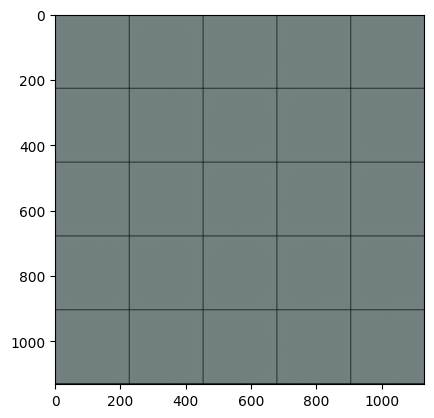

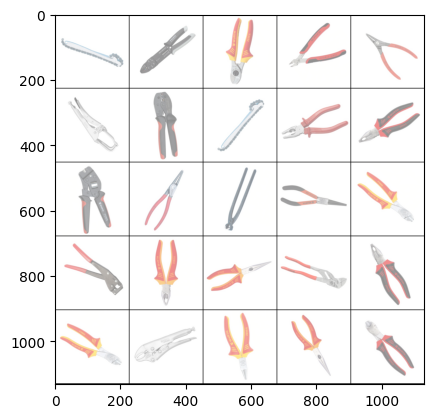

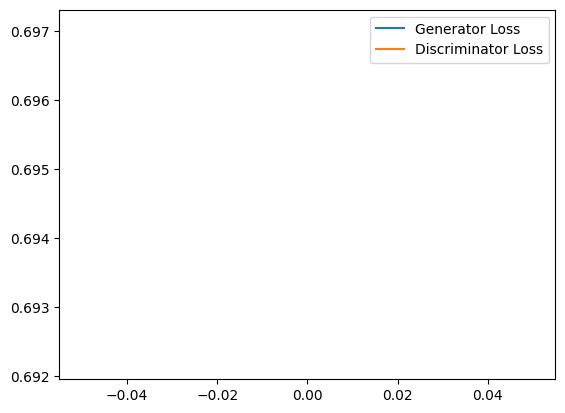

 31%|█████████████████████████▌                                                         | 8/26 [04:47<09:39, 32.21s/it]

Epoch 2, step 60: Generator loss: 0.7120099465052286, discriminator loss: 0.6786929190158844


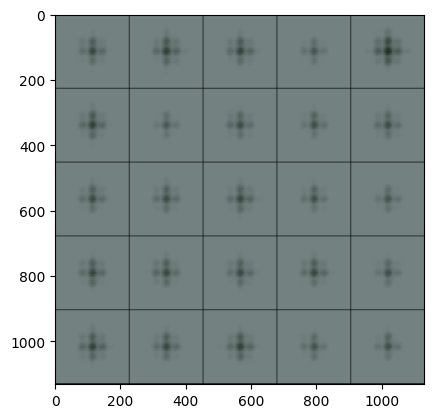

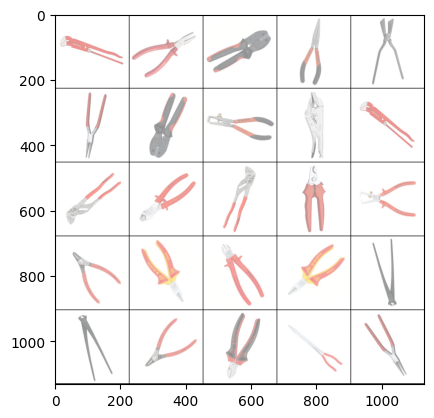

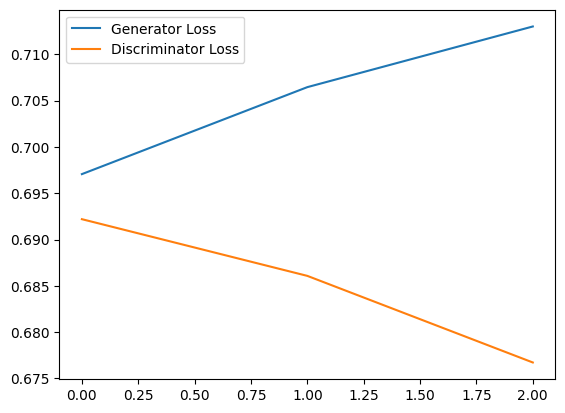

 46%|█████████████████████████████████████▊                                            | 12/26 [06:51<07:19, 31.41s/it]

Epoch 3, step 90: Generator loss: 0.7212314744790395, discriminator loss: 0.6758257269859314


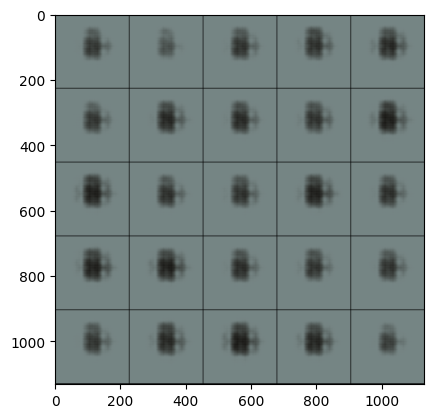

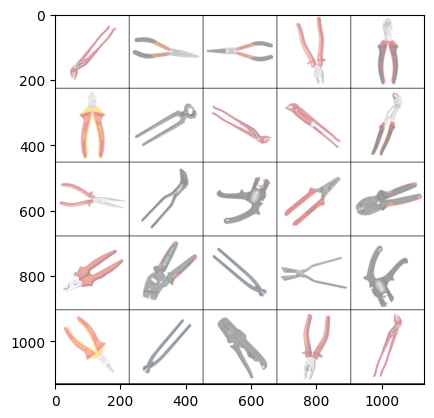

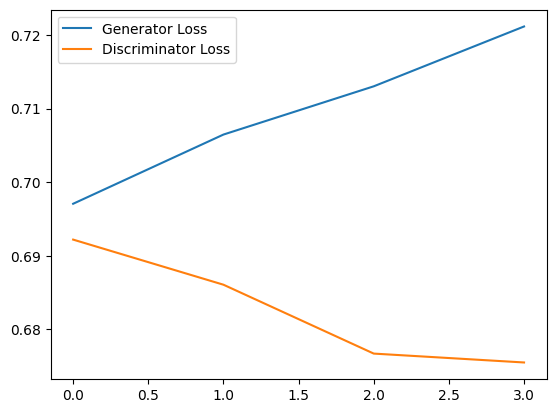

 62%|██████████████████████████████████████████████████▍                               | 16/26 [08:56<05:11, 31.16s/it]

Epoch 4, step 120: Generator loss: 0.7201894919077555, discriminator loss: 0.6737964888413747


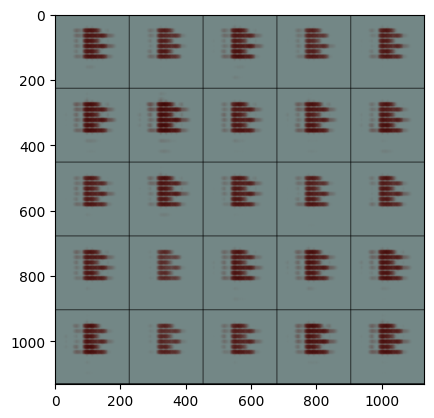

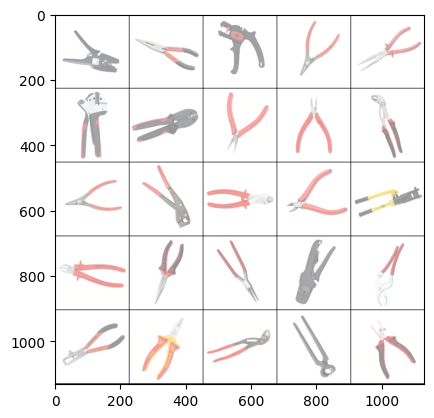

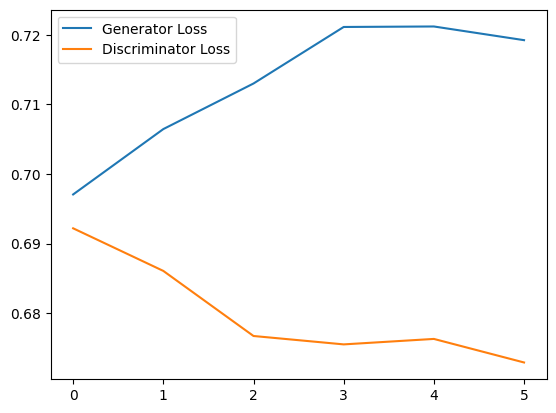

 77%|███████████████████████████████████████████████████████████████                   | 20/26 [10:59<03:06, 31.05s/it]

Epoch 5, step 150: Generator loss: 0.7599765618642171, discriminator loss: 0.6424673755963644


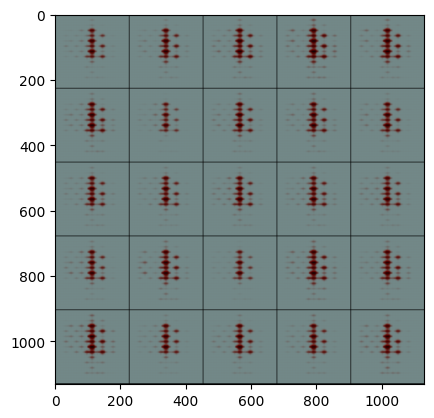

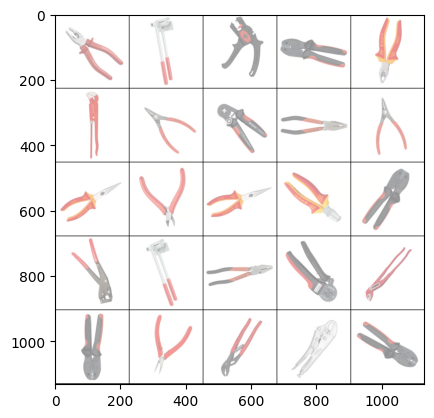

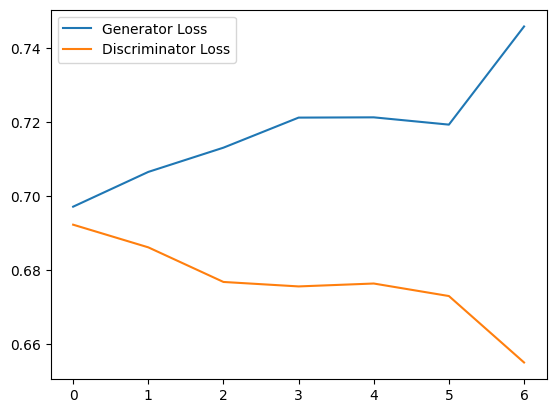

 92%|███████████████████████████████████████████████████████████████████████████▋      | 24/26 [13:01<01:01, 30.83s/it]

Epoch 6, step 180: Generator loss: 0.8080838322639465, discriminator loss: 0.610842756430308


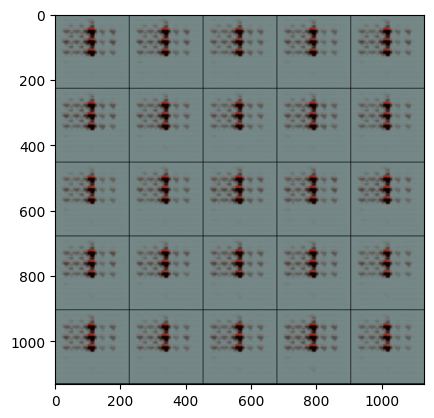

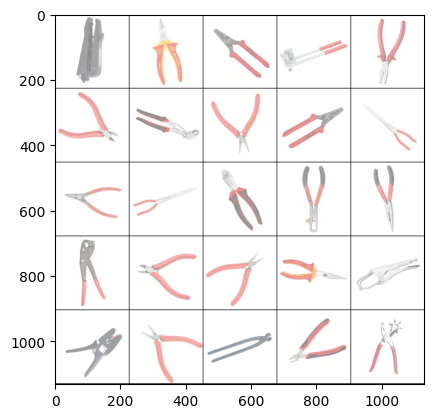

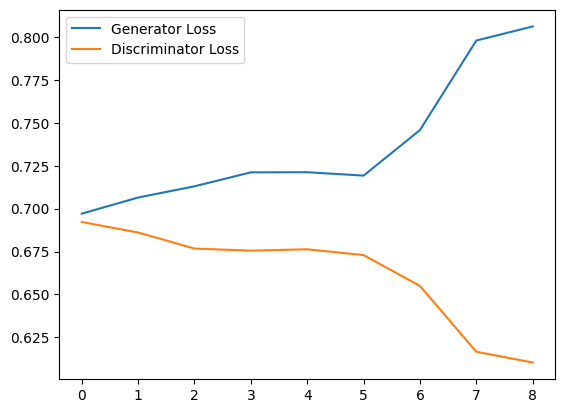

  8%|██████▍                                                                            | 2/26 [01:40<18:46, 46.93s/it]

Epoch 8, step 210: Generator loss: 0.7300479074319204, discriminator loss: 0.6625759919484456


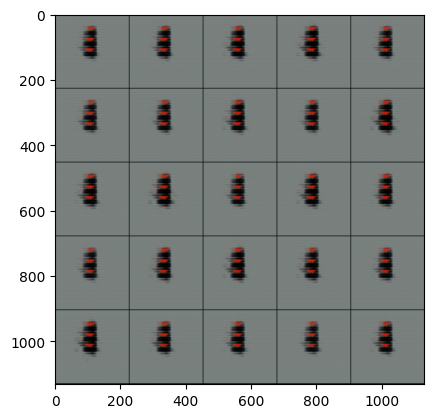

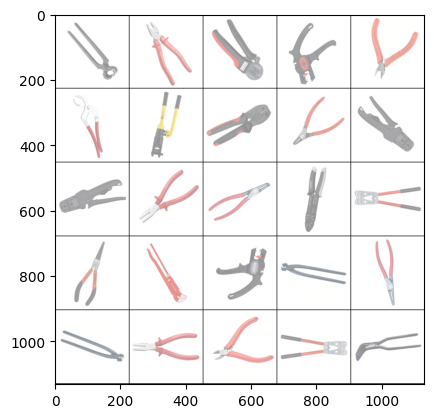

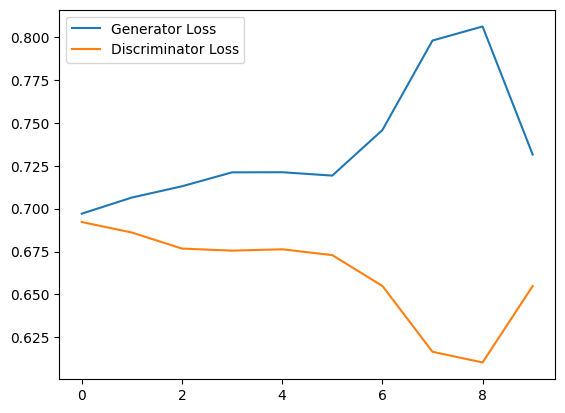

 23%|███████████████████▏                                                               | 6/26 [03:44<11:02, 33.13s/it]

Epoch 9, step 240: Generator loss: 0.7239620308081309, discriminator loss: 0.6679280440012614


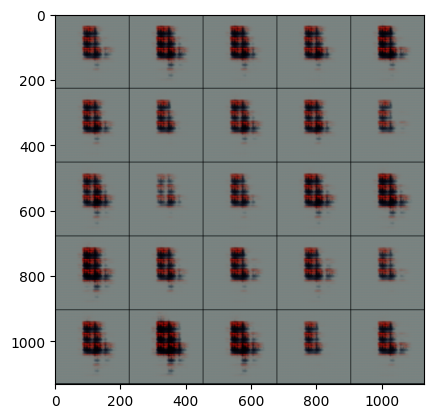

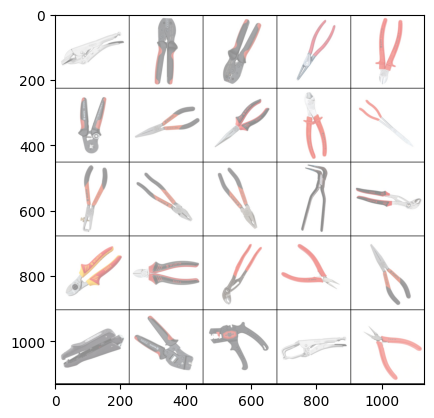

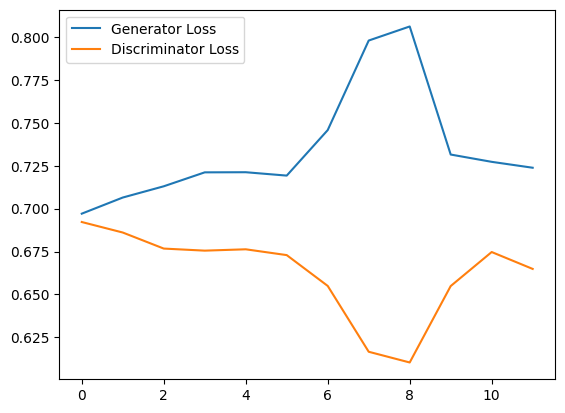

 38%|███████████████████████████████▌                                                  | 10/26 [05:49<08:25, 31.62s/it]

Epoch 10, step 270: Generator loss: 0.732286141316096, discriminator loss: 0.6624253074328105


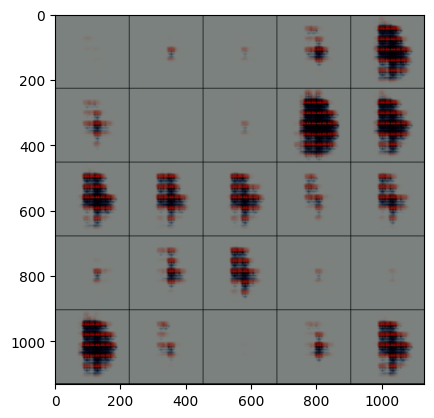

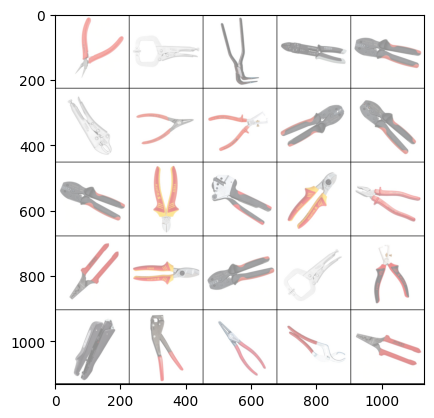

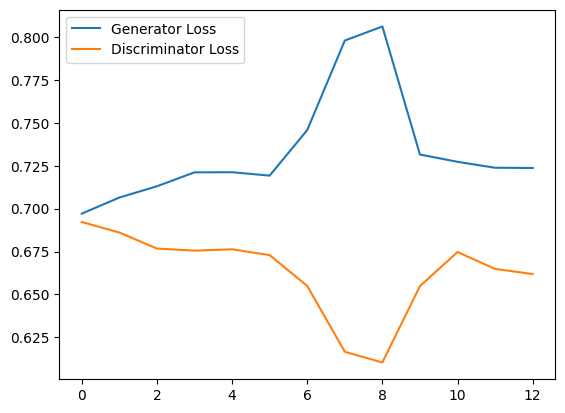

 54%|████████████████████████████████████████████▏                                     | 14/26 [07:51<06:12, 31.01s/it]

Epoch 11, step 300: Generator loss: 0.7353169898192088, discriminator loss: 0.6519385159015656


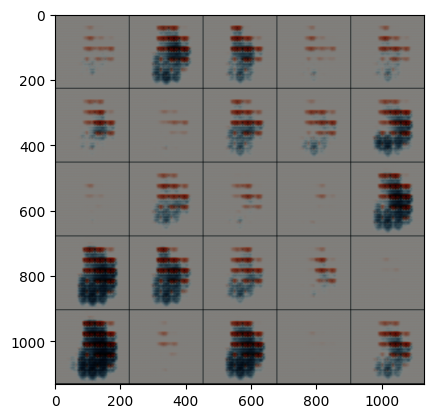

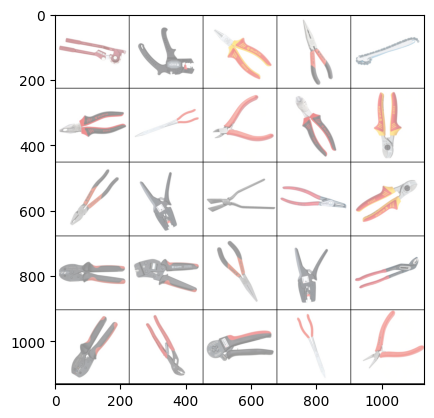

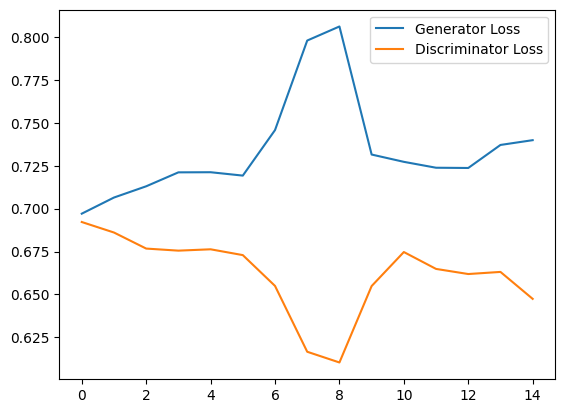

 69%|████████████████████████████████████████████████████████▊                         | 18/26 [09:56<04:07, 30.96s/it]

Epoch 12, step 330: Generator loss: 0.769817179441452, discriminator loss: 0.6452068050702413


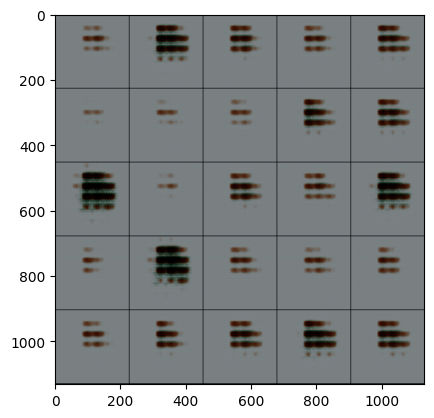

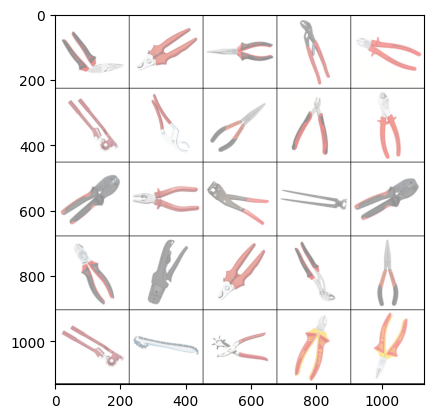

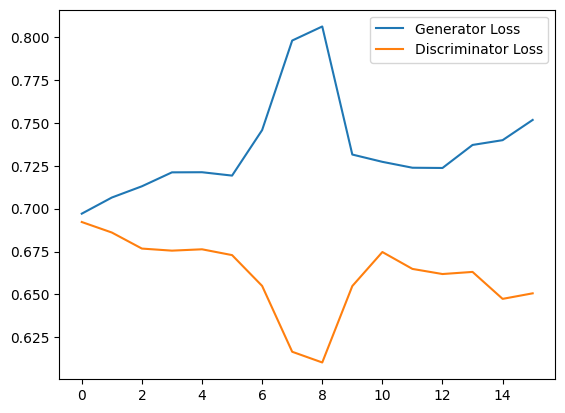

 85%|█████████████████████████████████████████████████████████████████████▍            | 22/26 [11:59<02:03, 30.82s/it]

Epoch 13, step 360: Generator loss: 0.788196611404419, discriminator loss: 0.618349947532018


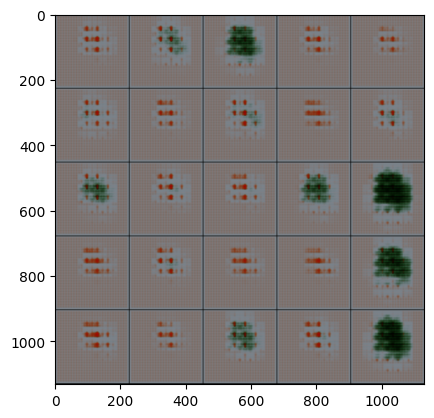

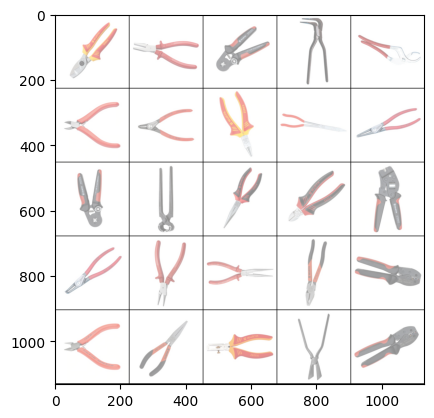

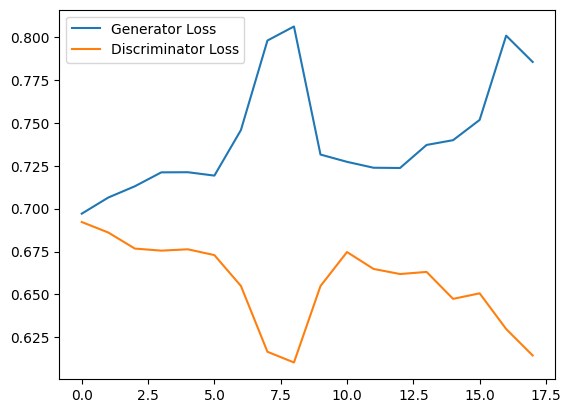

  0%|                                                                                           | 0/26 [00:00<?, ?it/s]

Epoch 15, step 390: Generator loss: 0.9195604681968689, discriminator loss: 0.5769563396771749


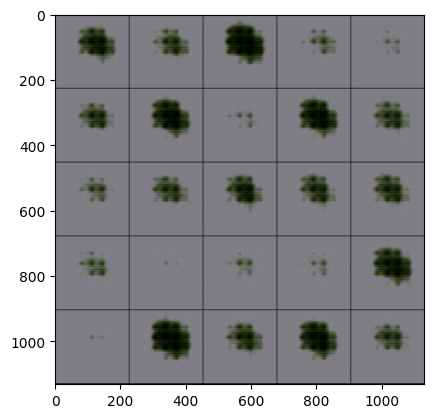

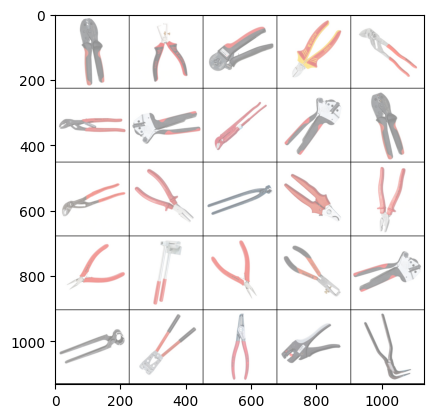

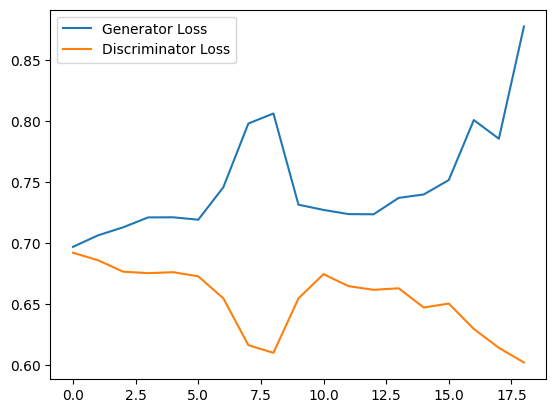

 15%|████████████▊                                                                      | 4/26 [02:41<13:12, 36.04s/it]

Epoch 16, step 420: Generator loss: 0.8420073668162028, discriminator loss: 0.6111917078495026


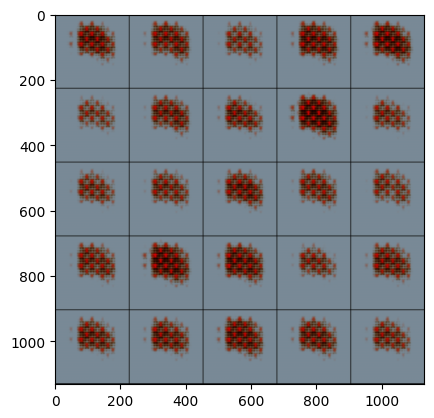

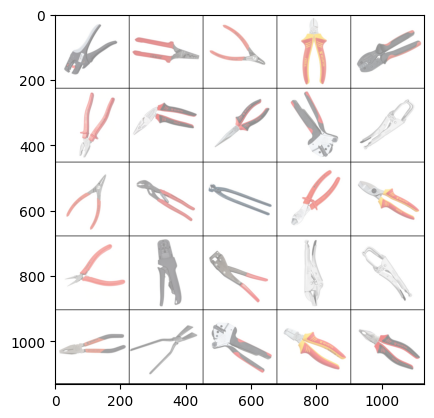

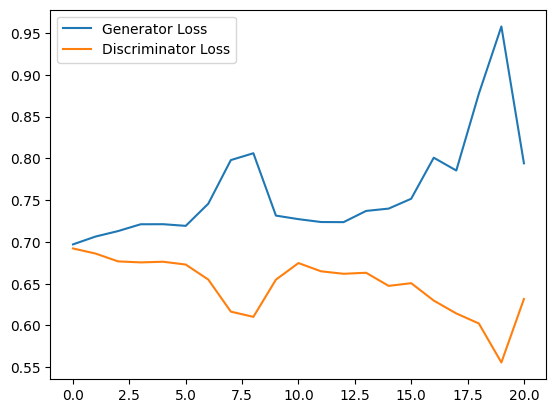

 31%|█████████████████████████▌                                                         | 8/26 [04:53<09:49, 32.74s/it]

Epoch 17, step 450: Generator loss: 1.0450015544891358, discriminator loss: 0.4830038468043009


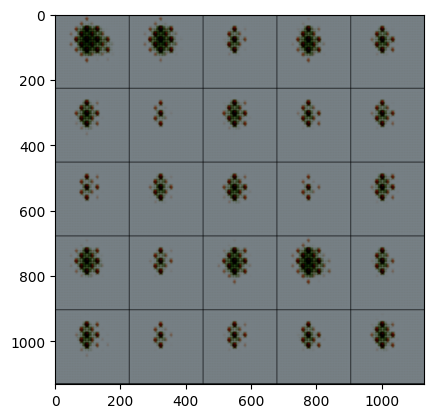

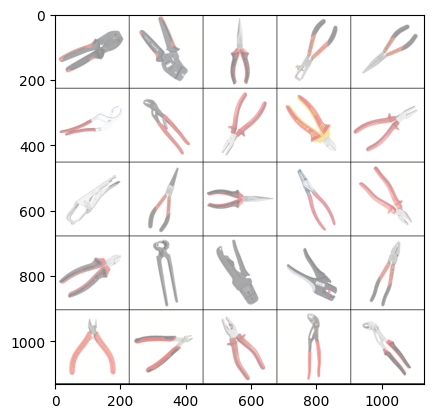

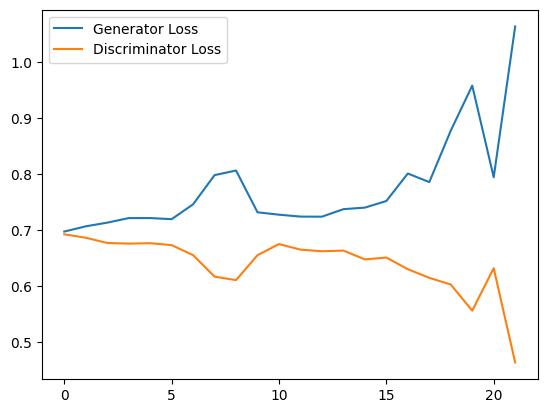

 46%|█████████████████████████████████████▊                                            | 12/26 [06:57<07:25, 31.84s/it]

Epoch 18, step 480: Generator loss: 1.031964800755183, discriminator loss: 0.5204731315374375


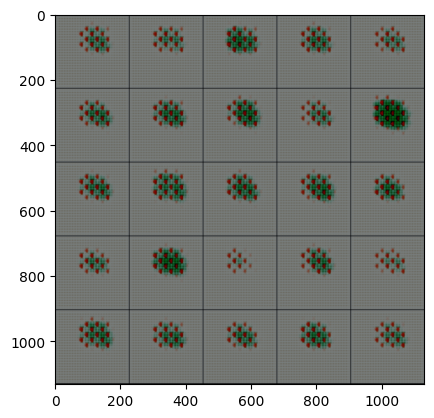

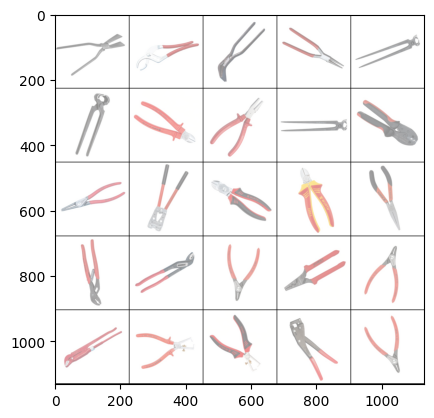

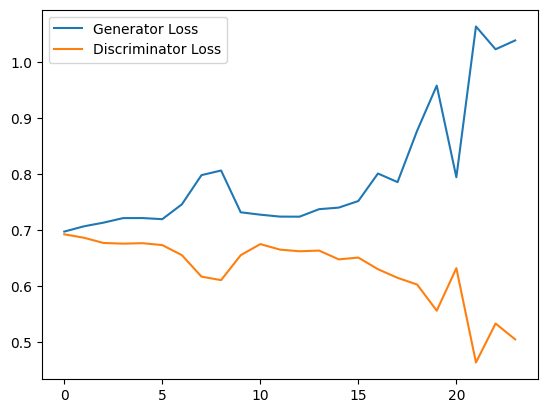

 62%|██████████████████████████████████████████████████▍                               | 16/26 [09:02<05:15, 31.55s/it]

Epoch 19, step 510: Generator loss: 0.907649564743042, discriminator loss: 0.5492728690306345


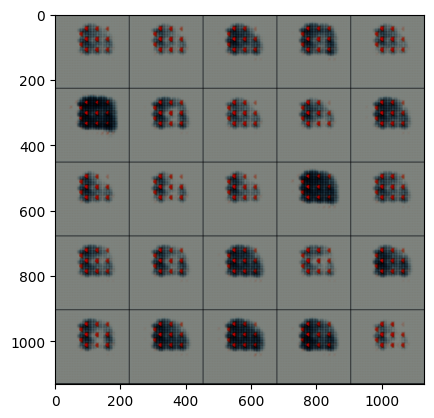

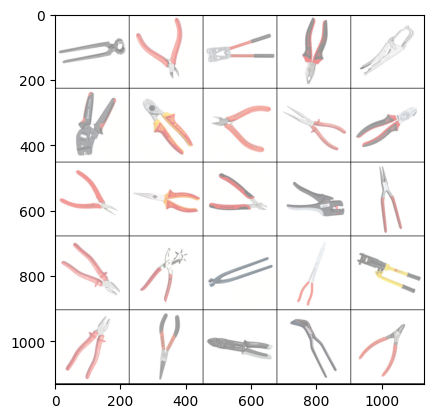

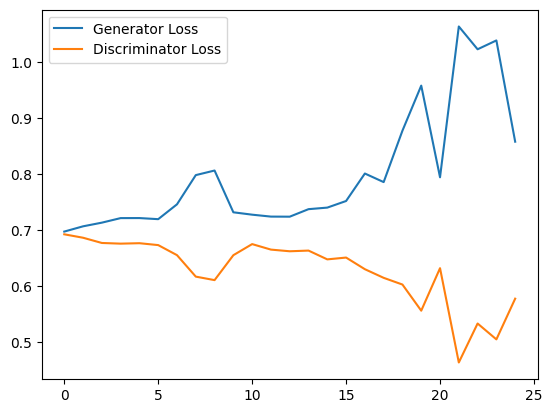

 77%|███████████████████████████████████████████████████████████████                   | 20/26 [11:11<03:09, 31.54s/it]

Epoch 20, step 540: Generator loss: 0.928205531835556, discriminator loss: 0.57773859500885


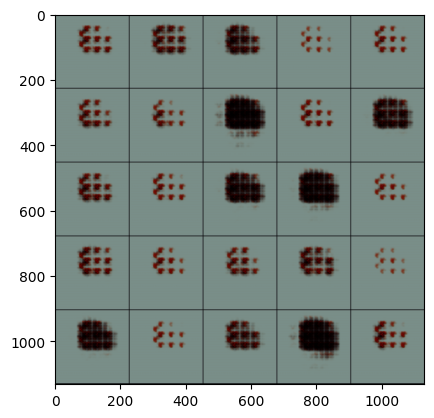

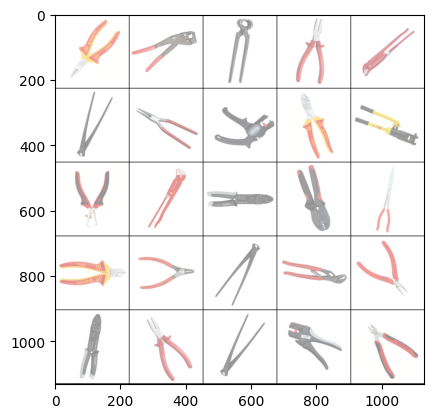

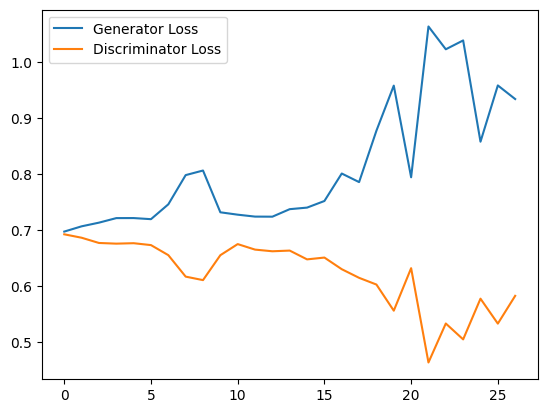

 92%|███████████████████████████████████████████████████████████████████████████▋      | 24/26 [13:18<01:03, 31.74s/it]

Epoch 21, step 570: Generator loss: 0.8685718913873036, discriminator loss: 0.5915061394373576


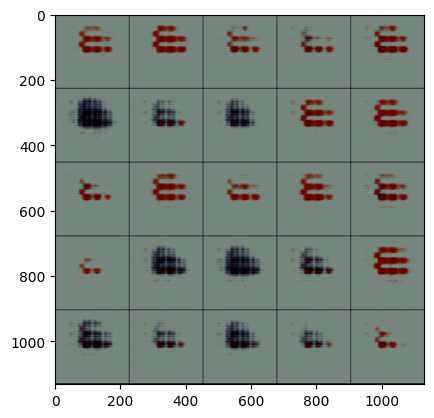

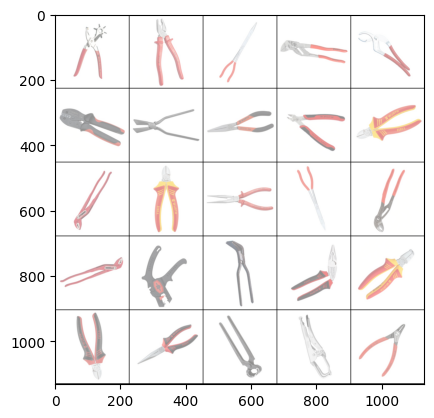

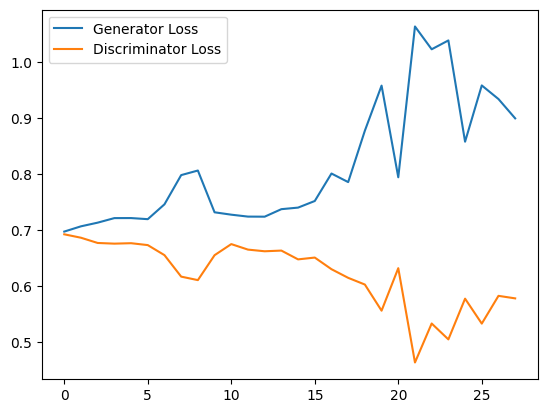

  8%|██████▍                                                                            | 2/26 [01:40<18:50, 47.11s/it]

Epoch 23, step 600: Generator loss: 0.7664331674575806, discriminator loss: 0.6718974908192953


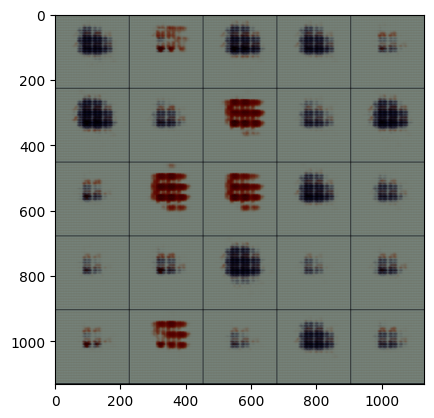

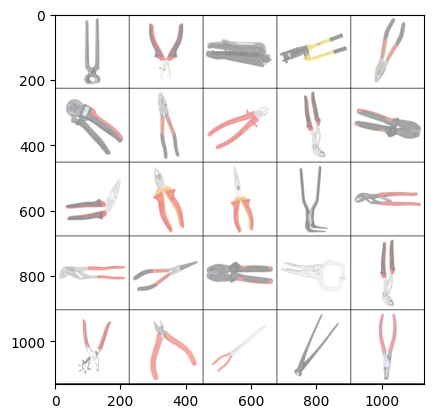

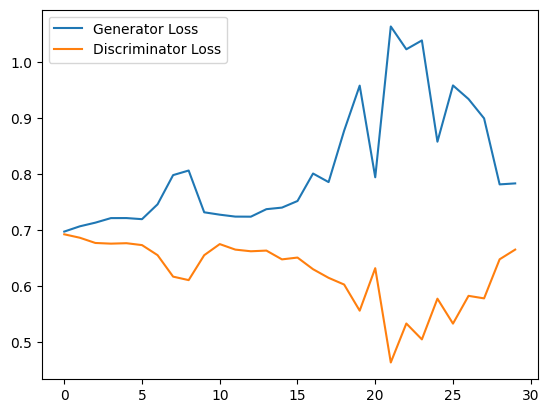

 23%|███████████████████▏                                                               | 6/26 [03:43<11:04, 33.23s/it]

Epoch 24, step 630: Generator loss: 0.758062207698822, discriminator loss: 0.6537774602572123


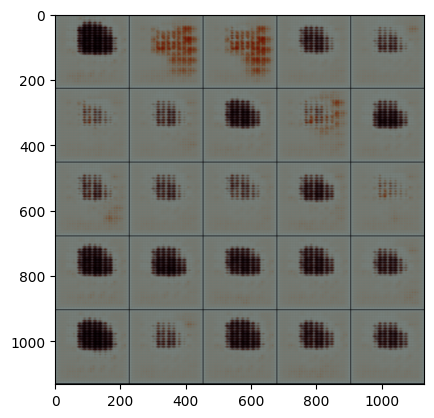

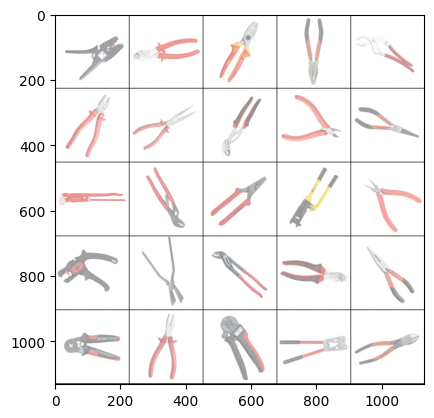

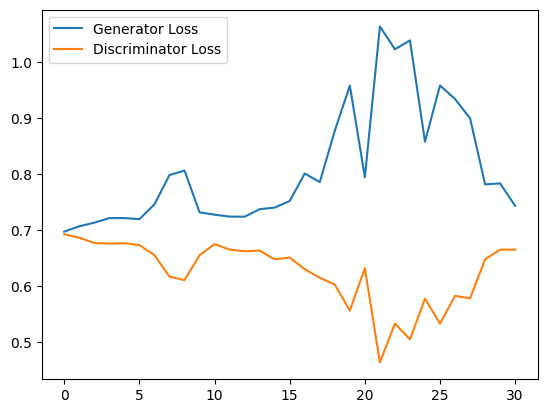

 38%|███████████████████████████████▌                                                  | 10/26 [05:49<08:27, 31.69s/it]

Epoch 25, step 660: Generator loss: 0.759998991092046, discriminator loss: 0.6674289206663767


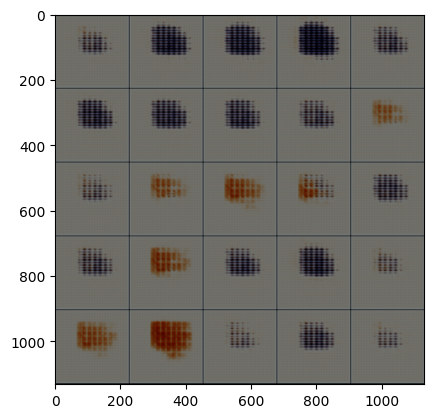

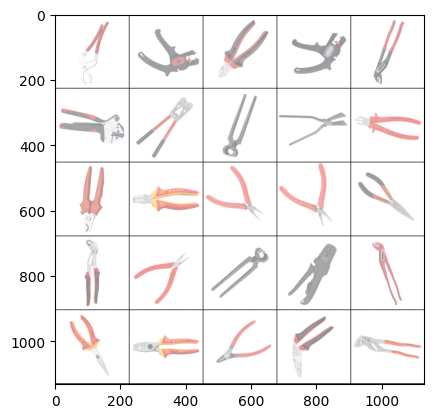

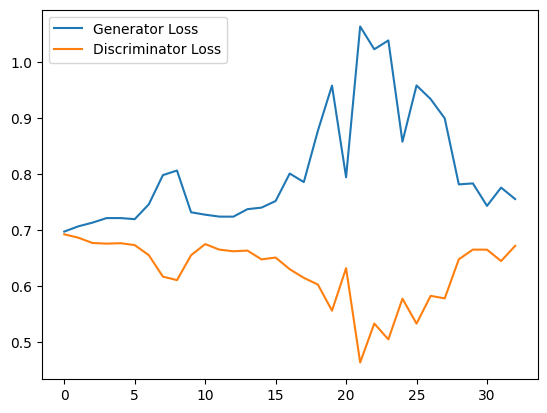

 54%|████████████████████████████████████████████▏                                     | 14/26 [08:00<06:19, 31.67s/it]

Epoch 26, step 690: Generator loss: 0.7326832811037699, discriminator loss: 0.6859818975130717


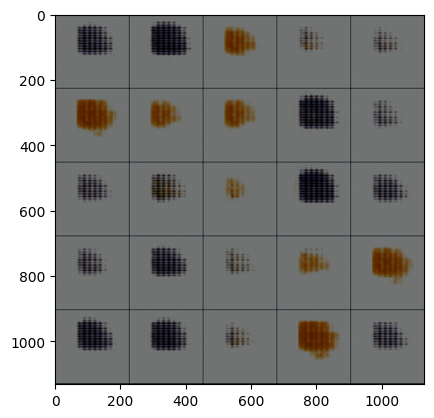

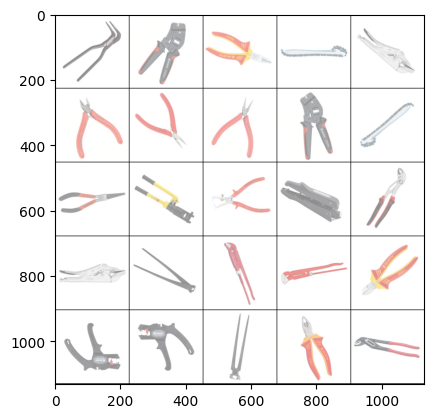

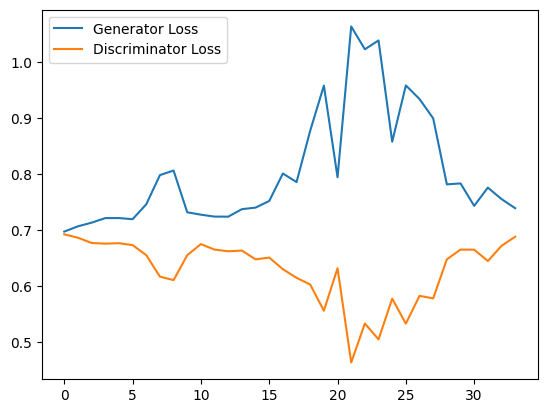

 69%|████████████████████████████████████████████████████████▊                         | 18/26 [10:13<04:16, 32.03s/it]

Epoch 27, step 720: Generator loss: 0.731620744864146, discriminator loss: 0.672209252913793


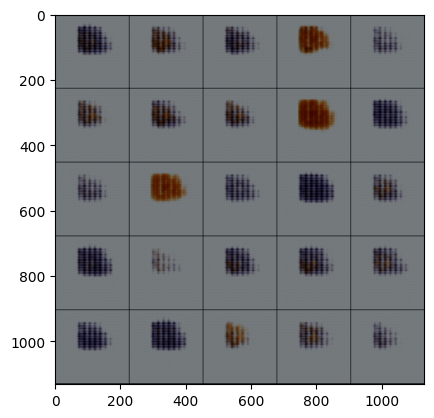

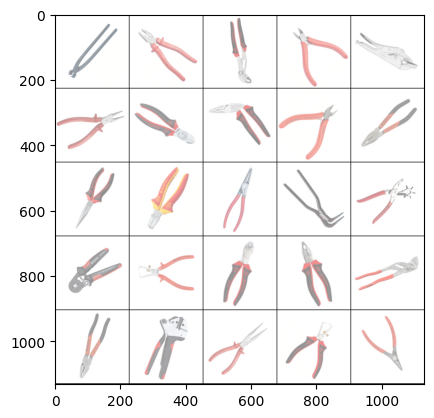

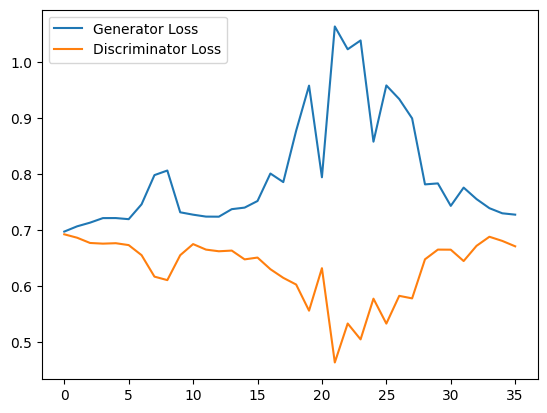

 85%|█████████████████████████████████████████████████████████████████████▍            | 22/26 [12:13<02:06, 31.61s/it]

Epoch 28, step 750: Generator loss: 0.7563172916571299, discriminator loss: 0.654545521736145


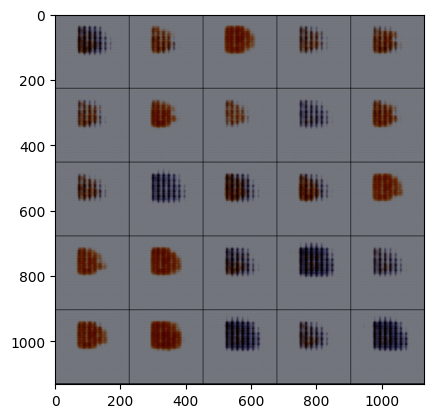

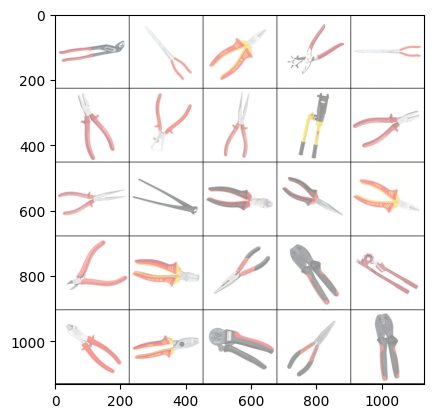

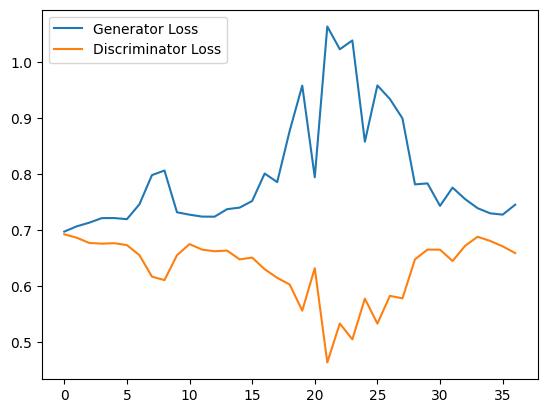

  0%|                                                                                           | 0/26 [00:00<?, ?it/s]

Epoch 30, step 780: Generator loss: 0.8854203740755717, discriminator loss: 0.6072865962982178


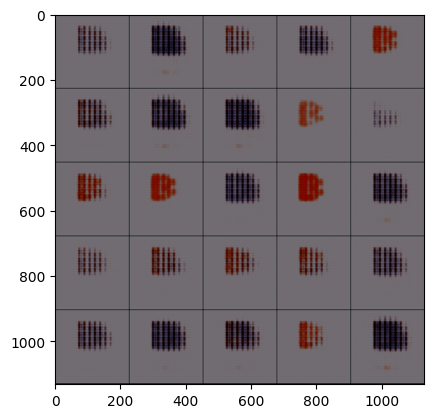

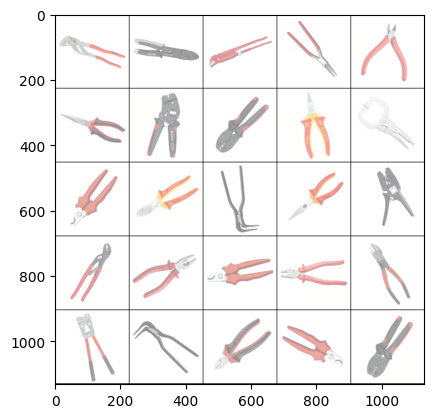

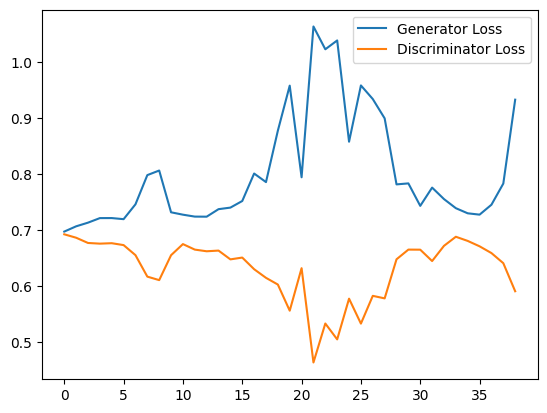

 15%|████████████▊                                                                      | 4/26 [02:41<13:20, 36.40s/it]

Epoch 31, step 810: Generator loss: 0.7900117198626201, discriminator loss: 0.6875268459320069


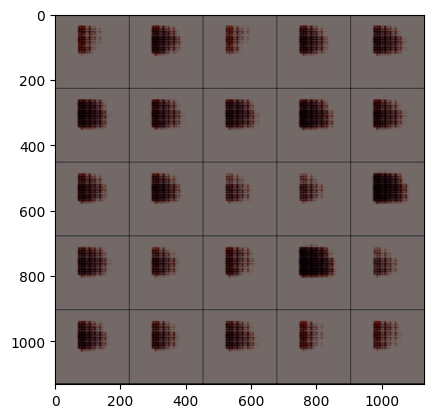

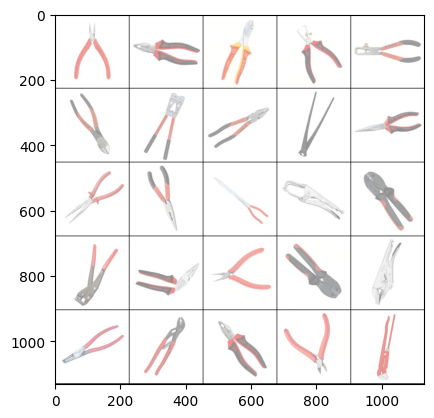

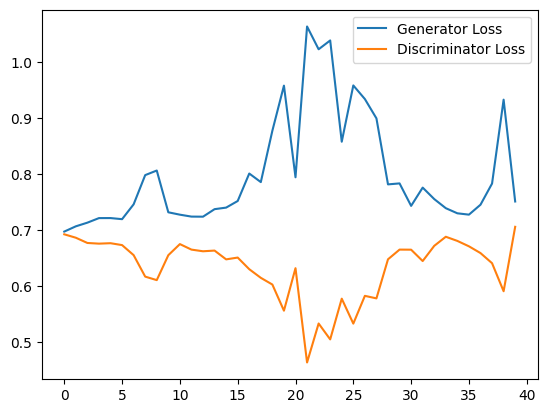

 31%|█████████████████████████▌                                                         | 8/26 [04:46<09:44, 32.46s/it]

Epoch 32, step 840: Generator loss: 0.7901656170686086, discriminator loss: 0.6400915682315826


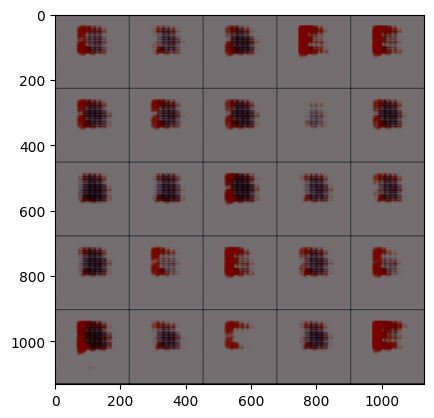

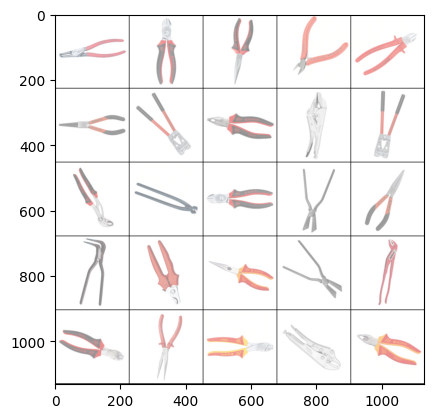

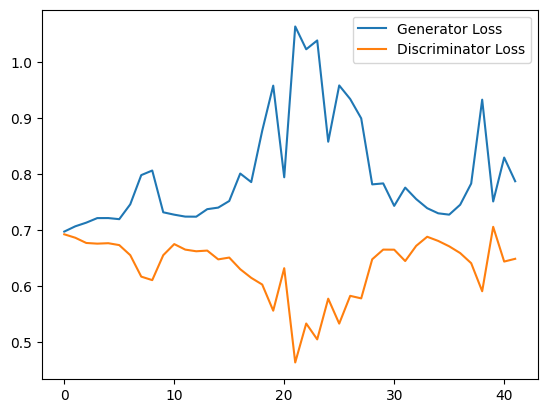

 46%|█████████████████████████████████████▊                                            | 12/26 [06:51<07:23, 31.70s/it]

Epoch 33, step 870: Generator loss: 0.8556563119093578, discriminator loss: 0.6108033021291097


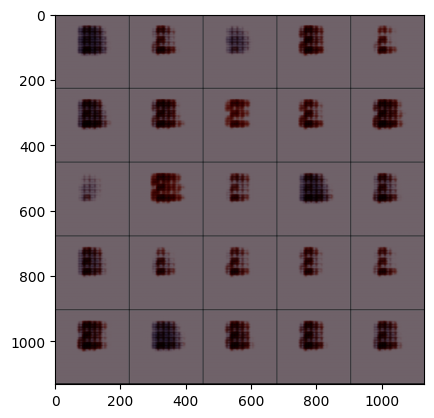

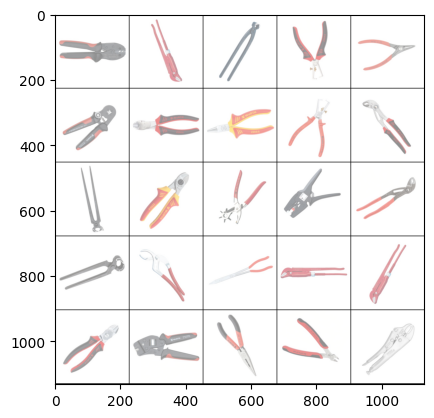

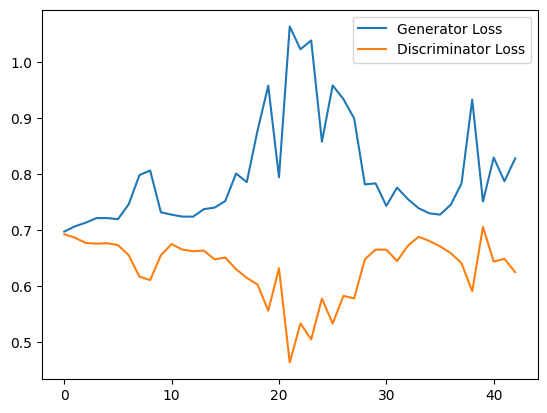

 62%|██████████████████████████████████████████████████▍                               | 16/26 [09:02<05:19, 31.97s/it]

Epoch 34, step 900: Generator loss: 0.8304755508899688, discriminator loss: 0.6219029287497203


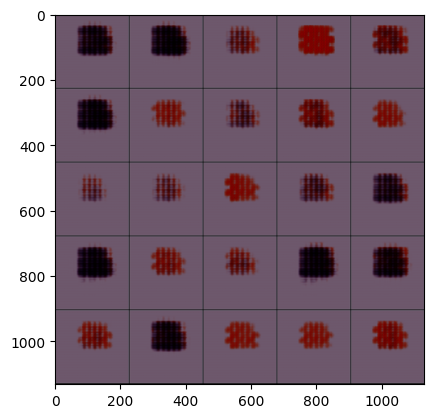

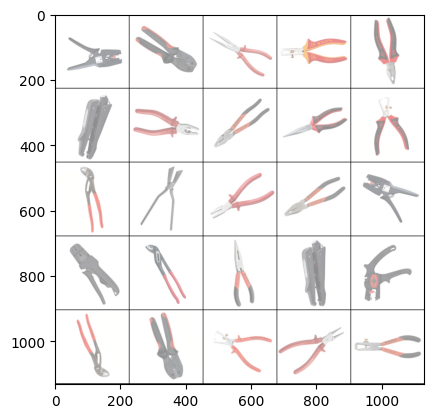

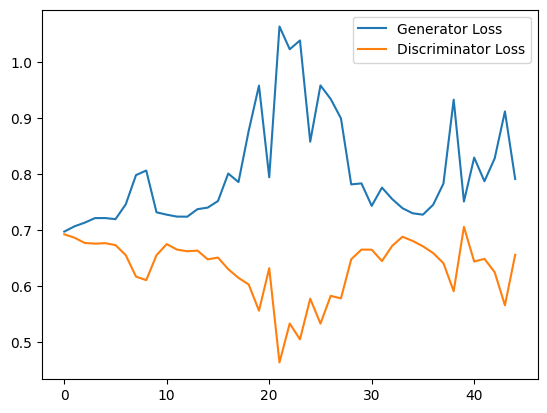

 77%|███████████████████████████████████████████████████████████████                   | 20/26 [11:08<03:10, 31.82s/it]

Epoch 35, step 930: Generator loss: 0.8397056380907695, discriminator loss: 0.6319834570089976


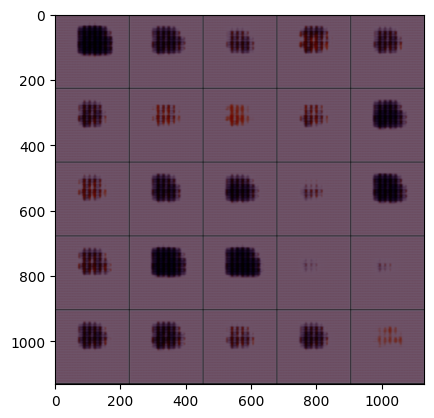

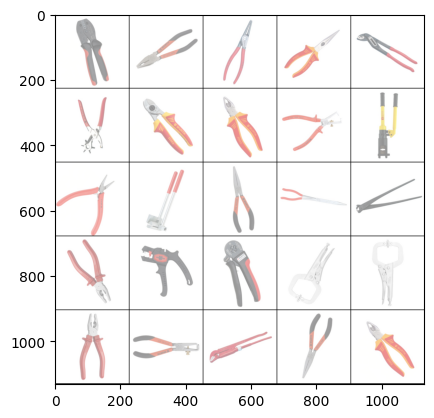

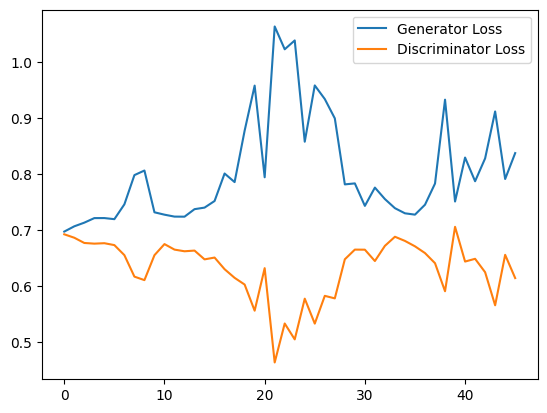

 92%|███████████████████████████████████████████████████████████████████████████▋      | 24/26 [13:40<01:02, 31.41s/it]

Epoch 36, step 960: Generator loss: 0.7845661362012227, discriminator loss: 0.6607054869333903


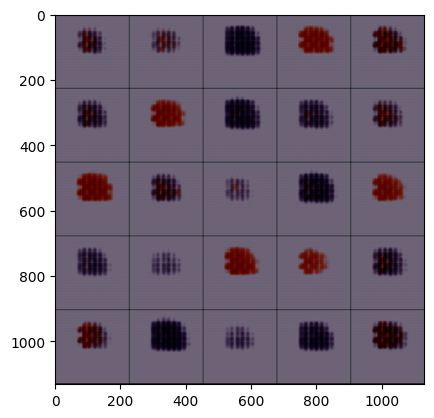

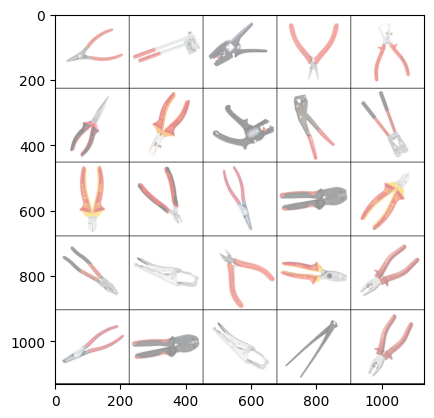

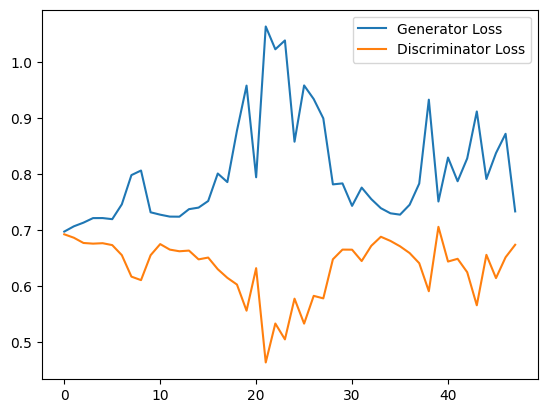

  8%|██████▍                                                                            | 2/26 [01:42<19:11, 47.99s/it]

Epoch 38, step 990: Generator loss: 0.749569712082545, discriminator loss: 0.6864780386288961


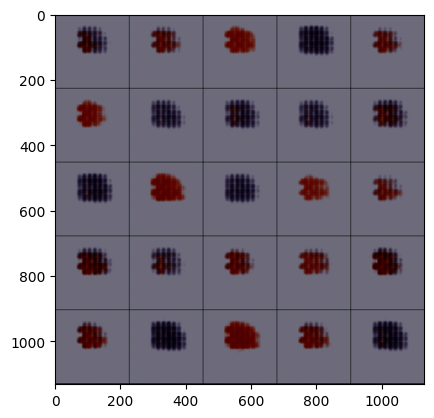

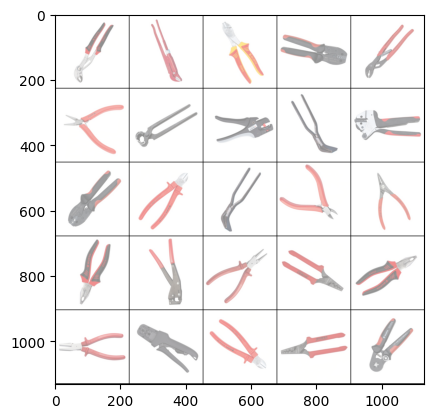

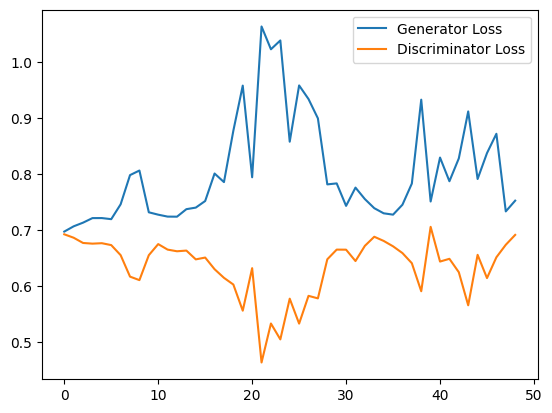

 23%|███████████████████▏                                                               | 6/26 [03:47<11:16, 33.85s/it]

Epoch 39, step 1020: Generator loss: 0.7633261859416962, discriminator loss: 0.6540245453516642


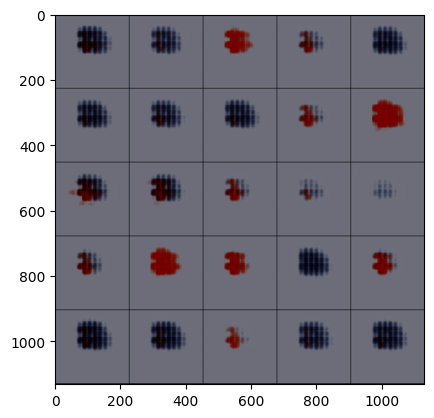

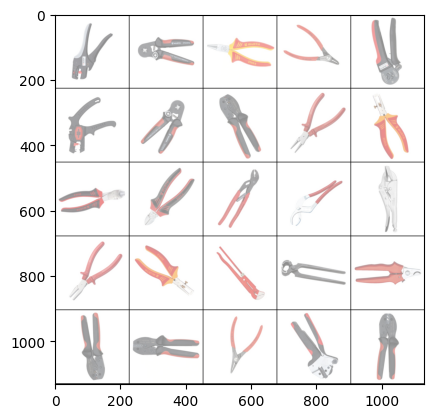

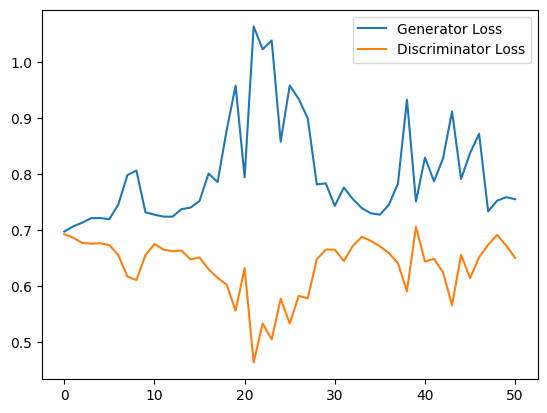

 38%|███████████████████████████████▌                                                  | 10/26 [05:53<08:31, 31.95s/it]

Epoch 40, step 1050: Generator loss: 0.8209935824076334, discriminator loss: 0.5945495148499806


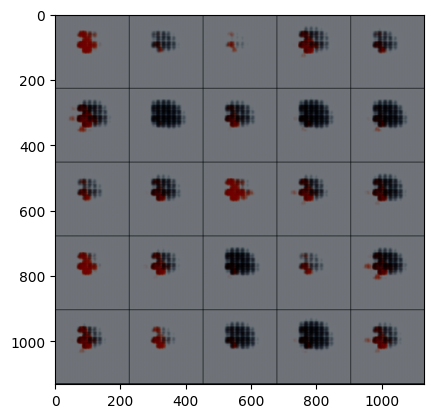

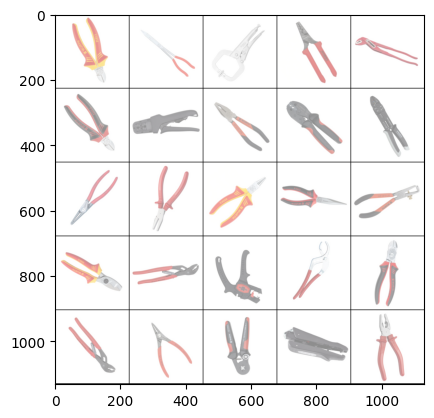

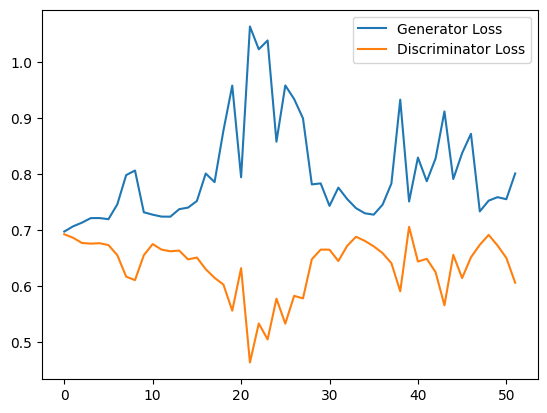

 54%|████████████████████████████████████████████▏                                     | 14/26 [08:04<06:22, 31.91s/it]

Epoch 41, step 1080: Generator loss: 0.8260199586550395, discriminator loss: 0.6023622334003449


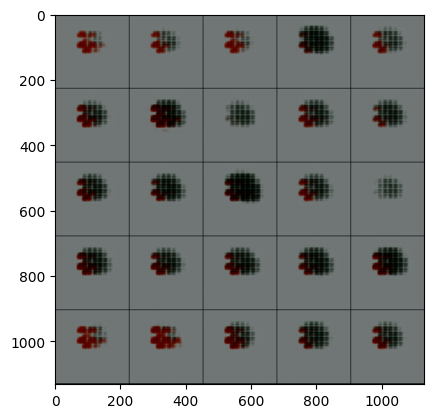

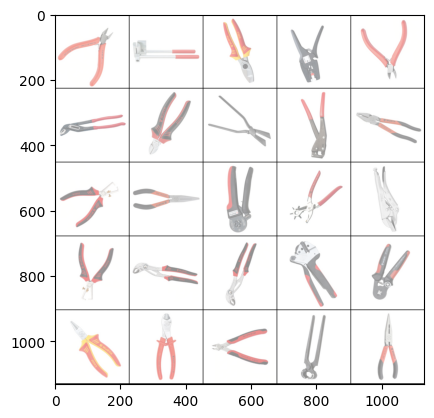

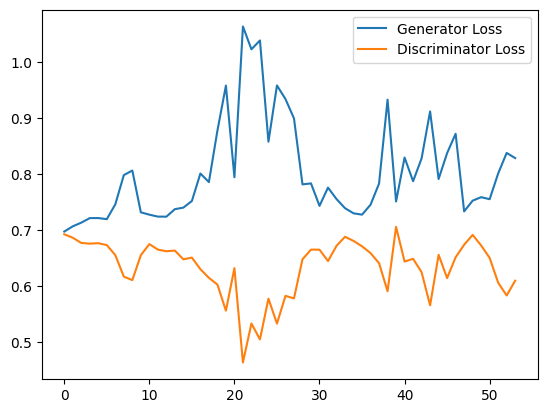

 69%|████████████████████████████████████████████████████████▊                         | 18/26 [10:09<04:14, 31.81s/it]

Epoch 42, step 1110: Generator loss: 0.8538888613382976, discriminator loss: 0.5950570702552795


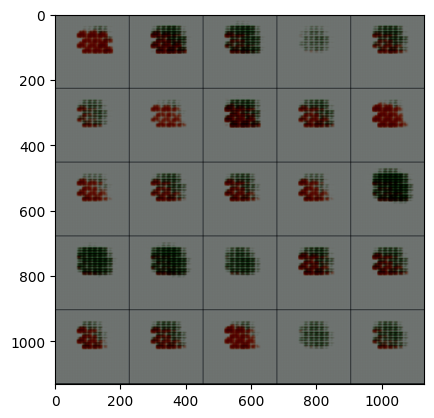

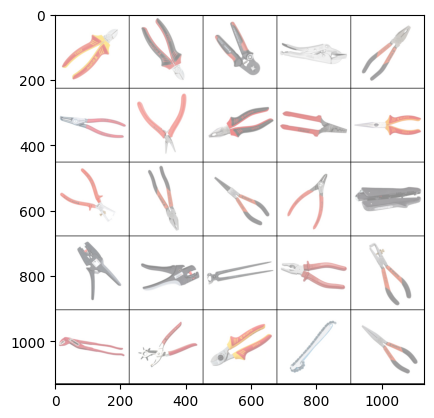

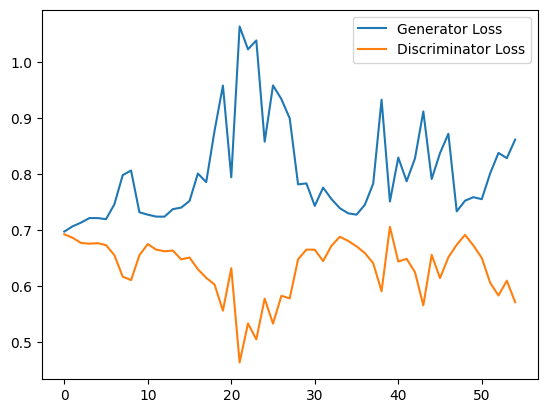

 85%|█████████████████████████████████████████████████████████████████████▍            | 22/26 [12:13<02:06, 31.54s/it]

Epoch 43, step 1140: Generator loss: 0.8171050429344178, discriminator loss: 0.6336524665355683


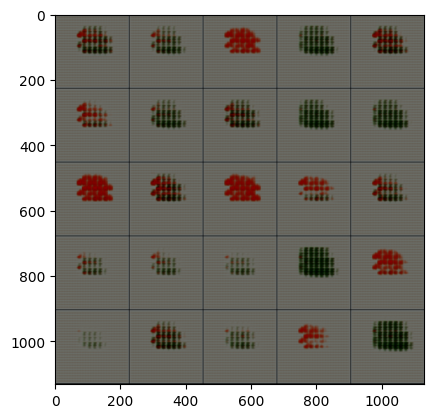

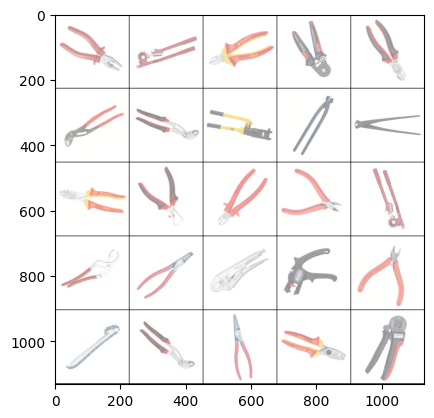

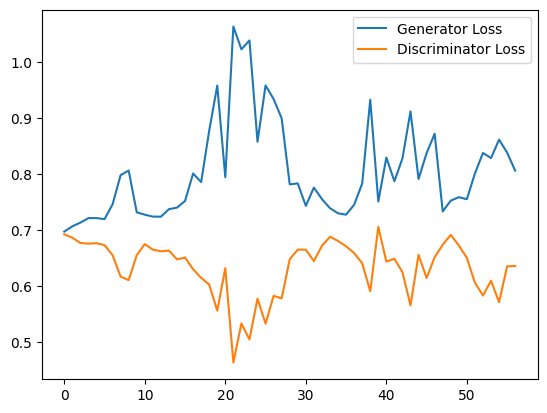

  0%|                                                                                           | 0/26 [00:00<?, ?it/s]

Epoch 45, step 1170: Generator loss: 0.8726166367530823, discriminator loss: 0.6044485986232757


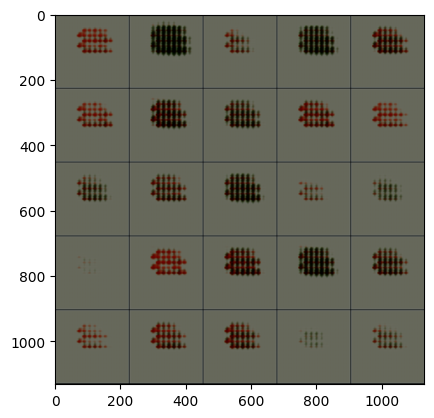

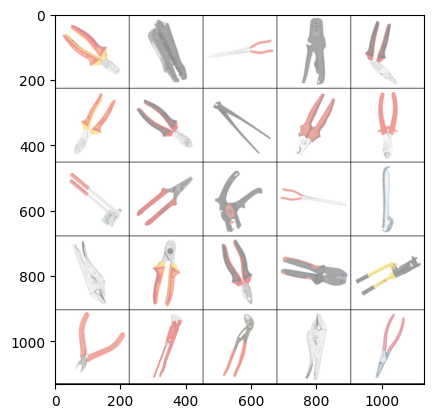

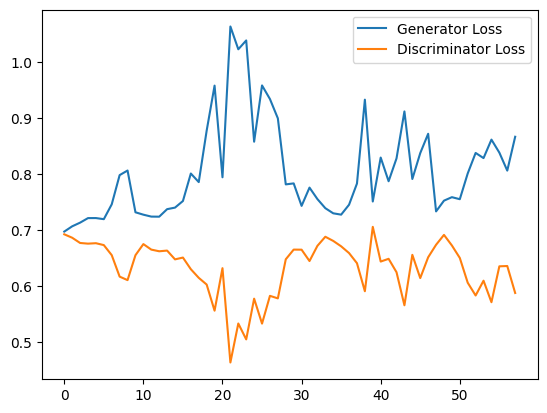

 15%|████████████▊                                                                      | 4/26 [02:47<13:44, 37.47s/it]

Epoch 46, step 1200: Generator loss: 0.785550328095754, discriminator loss: 0.6486567536989848


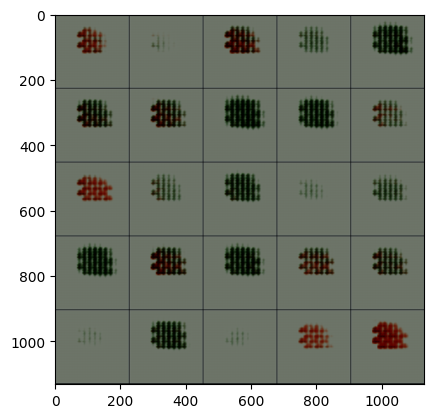

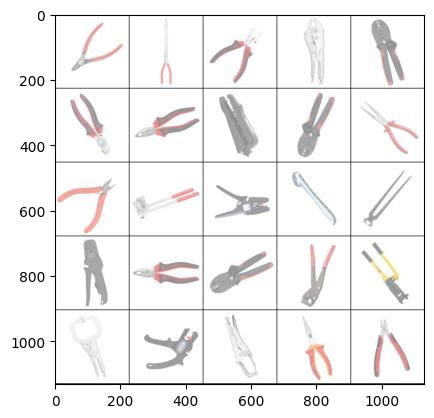

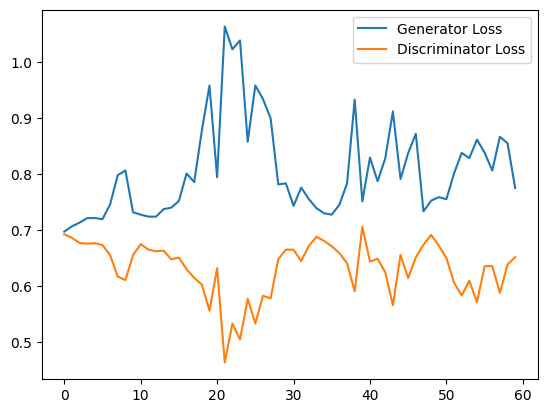

 31%|█████████████████████████▌                                                         | 8/26 [04:56<10:03, 33.51s/it]

Epoch 47, step 1230: Generator loss: 0.8045757651329041, discriminator loss: 0.6388831992944082


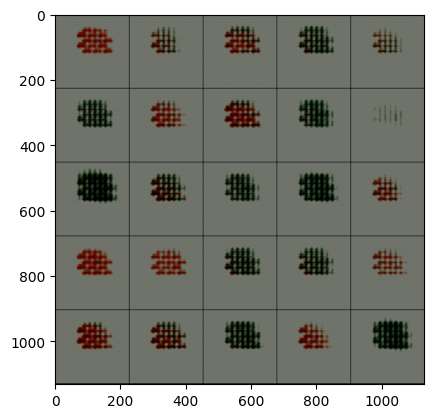

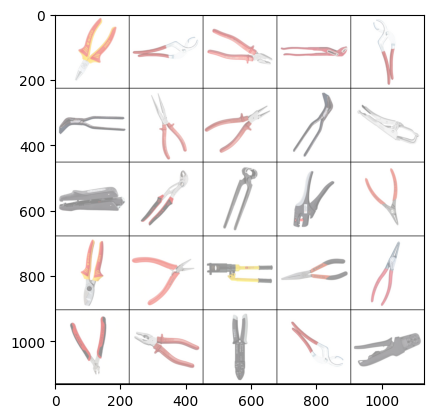

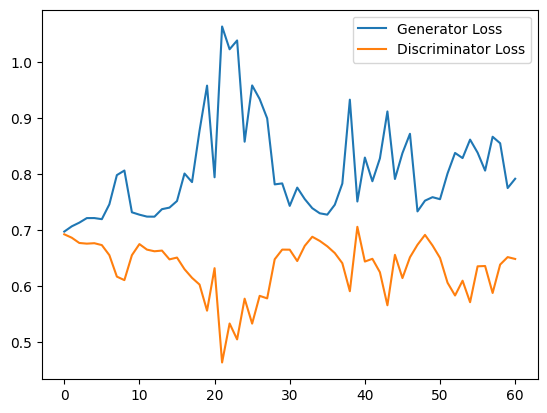

 46%|█████████████████████████████████████▊                                            | 12/26 [07:02<07:29, 32.11s/it]

Epoch 48, step 1260: Generator loss: 0.8162815709908803, discriminator loss: 0.6301267246405283


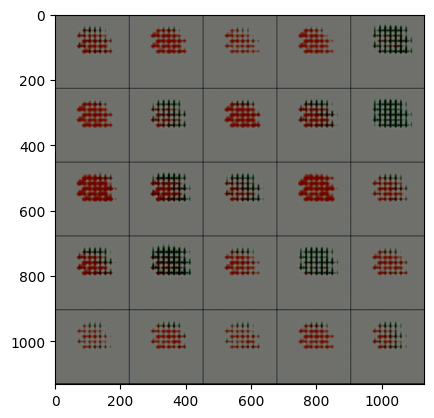

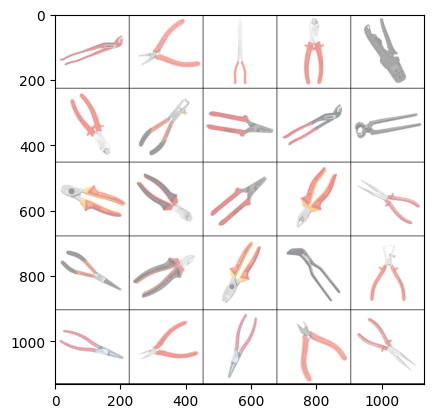

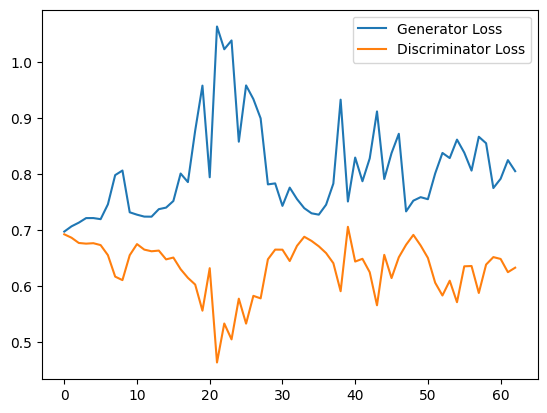

 62%|██████████████████████████████████████████████████▍                               | 16/26 [09:18<05:30, 33.02s/it]

Epoch 49, step 1290: Generator loss: 0.8487177689870199, discriminator loss: 0.6084514657656351


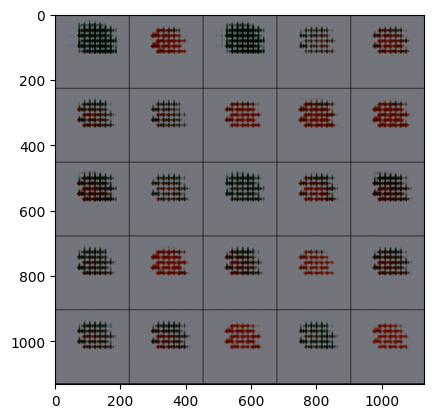

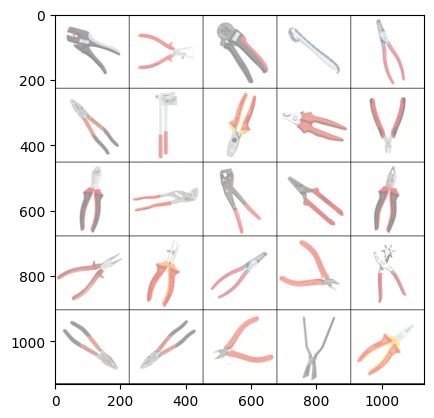

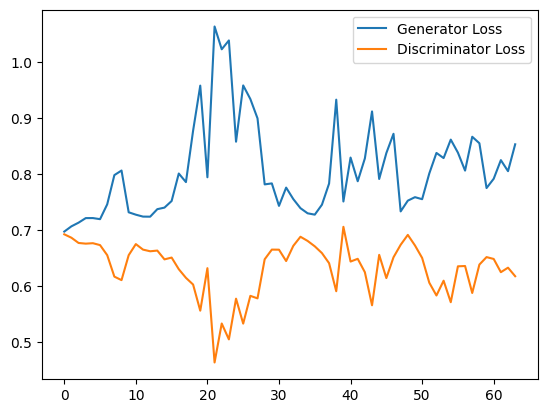

 77%|███████████████████████████████████████████████████████████████                   | 20/26 [11:19<03:12, 32.01s/it]

Epoch 50, step 1320: Generator loss: 0.8438213666280111, discriminator loss: 0.6069283167521159


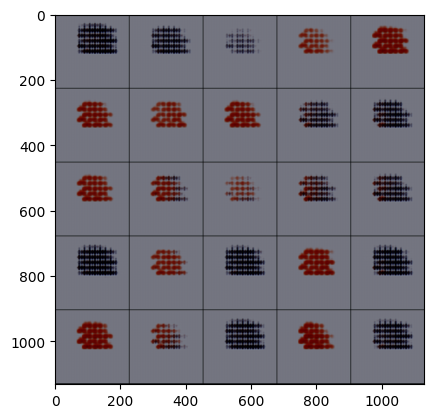

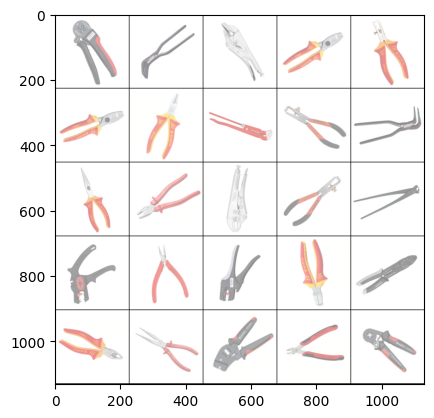

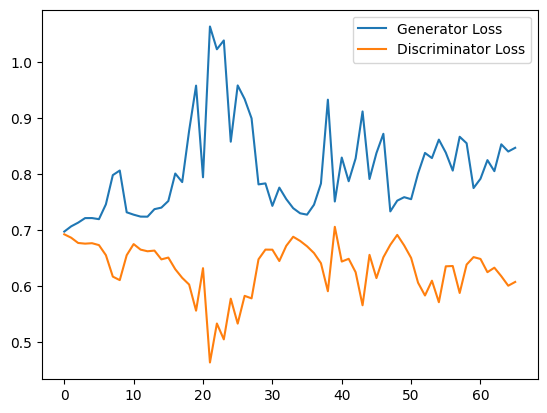

 92%|███████████████████████████████████████████████████████████████████████████▋      | 24/26 [13:39<01:05, 32.51s/it]

Epoch 51, step 1350: Generator loss: 0.848374742269516, discriminator loss: 0.6392749428749085


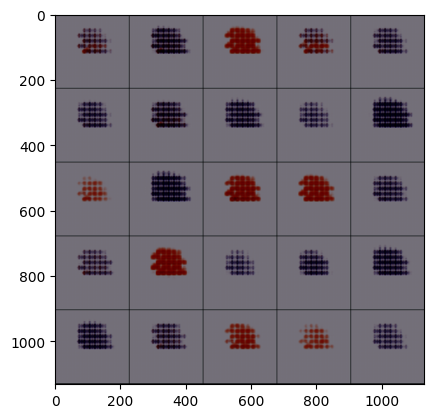

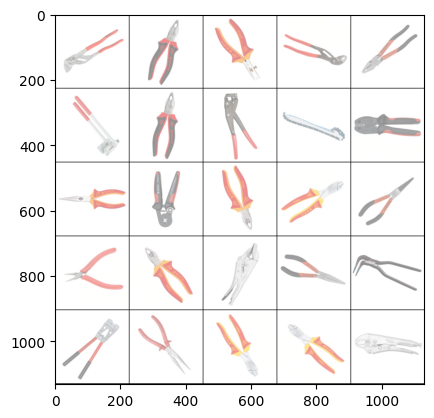

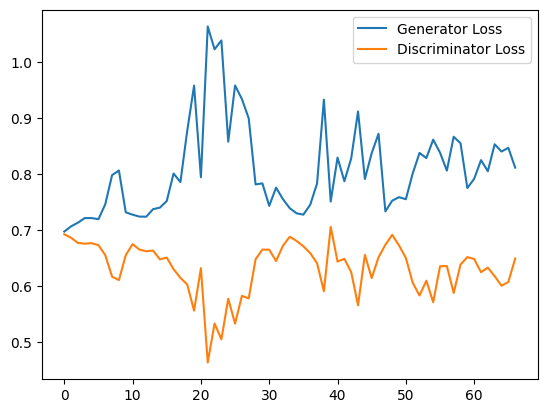

  8%|██████▍                                                                            | 2/26 [01:41<19:04, 47.68s/it]

Epoch 53, step 1380: Generator loss: 0.830758394797643, discriminator loss: 0.6197891354560852


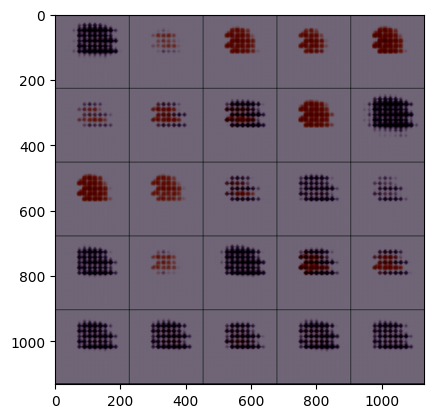

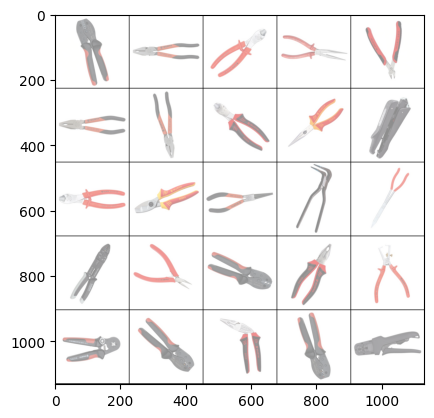

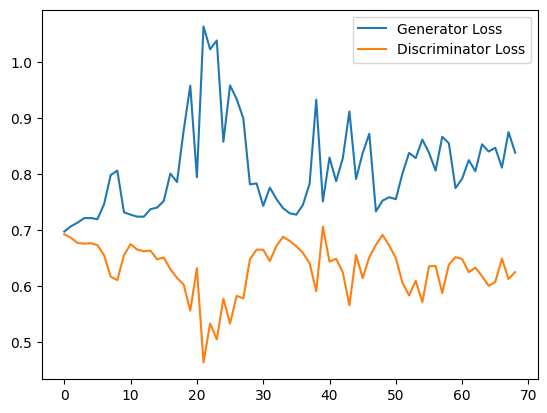

 23%|███████████████████▏                                                               | 6/26 [03:48<11:22, 34.15s/it]

Epoch 54, step 1410: Generator loss: 0.8024340629577636, discriminator loss: 0.6583527565002442


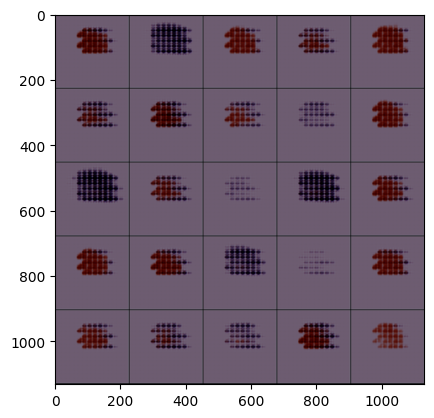

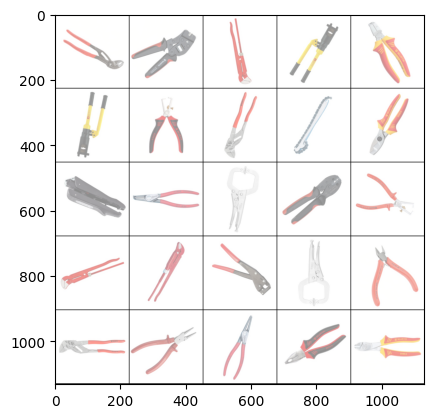

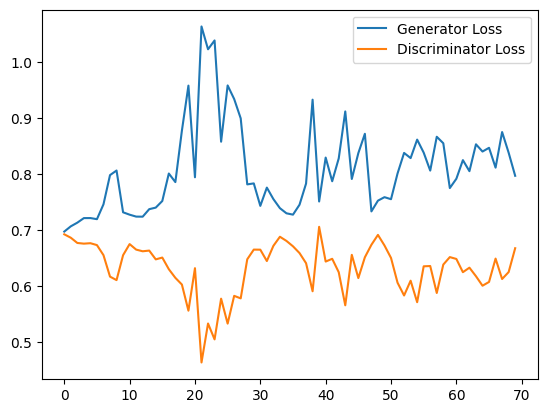

 38%|███████████████████████████████▌                                                  | 10/26 [05:57<08:39, 32.49s/it]

Epoch 55, step 1440: Generator loss: 0.7942401985327403, discriminator loss: 0.638180011510849


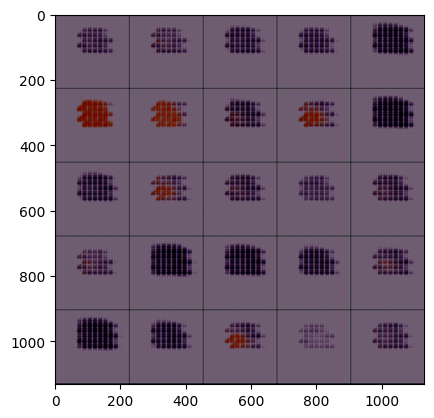

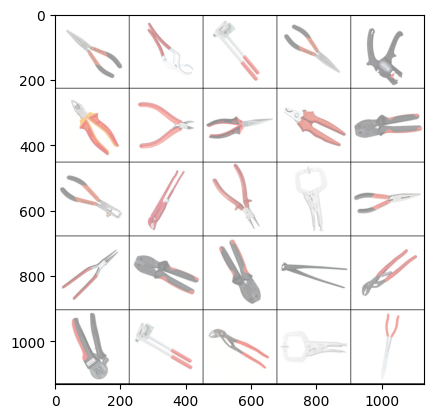

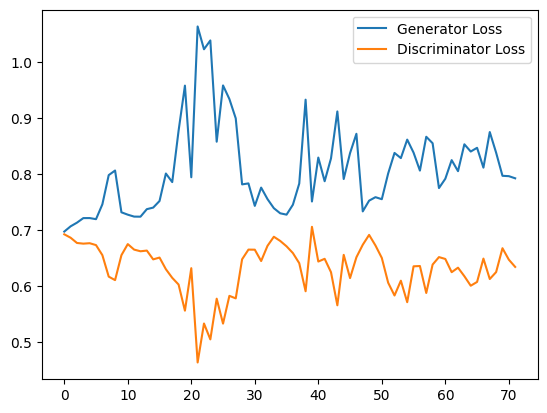

 54%|████████████████████████████████████████████▏                                     | 14/26 [08:11<06:25, 32.14s/it]

Epoch 56, step 1470: Generator loss: 0.8759858071804046, discriminator loss: 0.5893758575121562


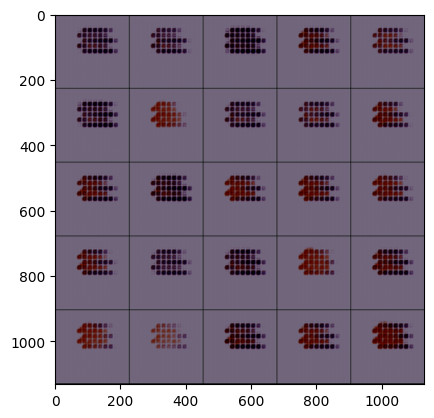

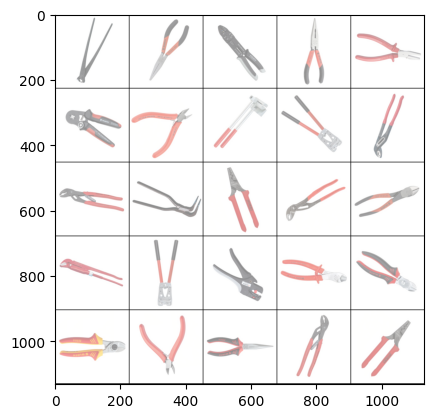

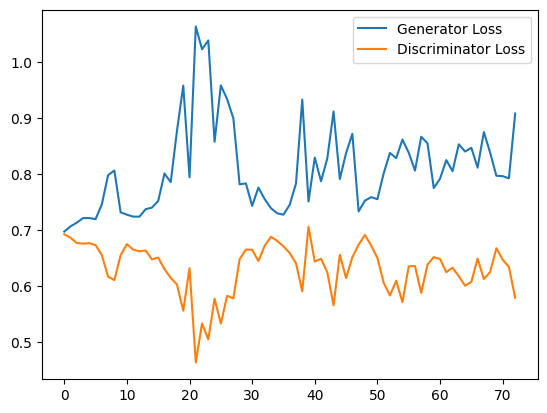

 69%|████████████████████████████████████████████████████████▊                         | 18/26 [10:28<04:27, 33.45s/it]

Epoch 57, step 1500: Generator loss: 0.8608002205689748, discriminator loss: 0.5856388807296753


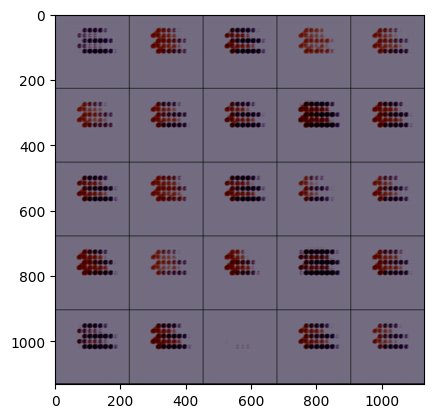

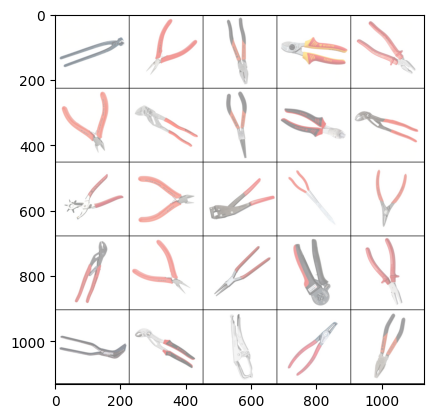

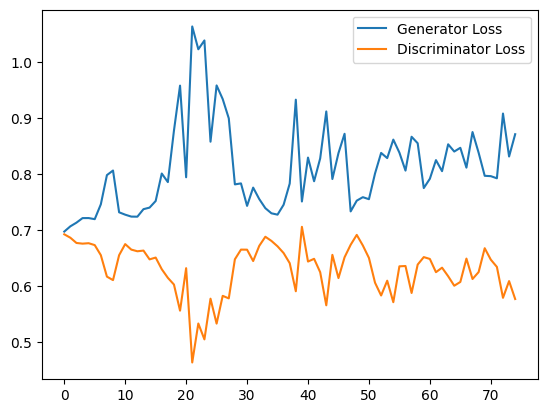

 85%|█████████████████████████████████████████████████████████████████████▍            | 22/26 [12:50<02:06, 31.55s/it]

Epoch 58, step 1530: Generator loss: 0.8724665721257527, discriminator loss: 0.5870816429456075


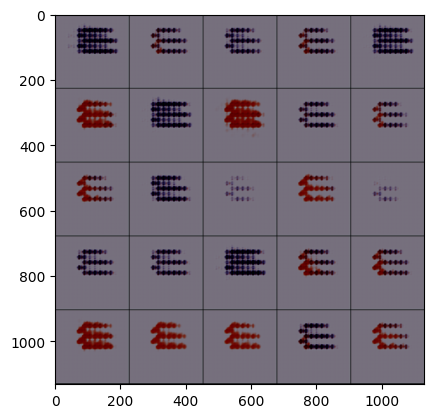

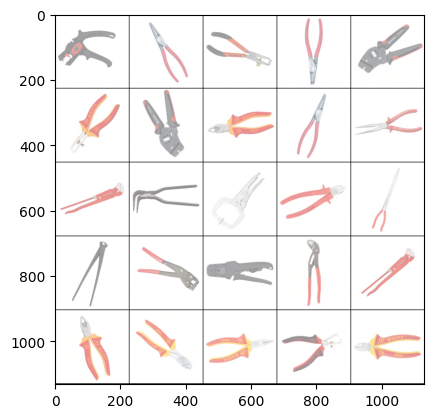

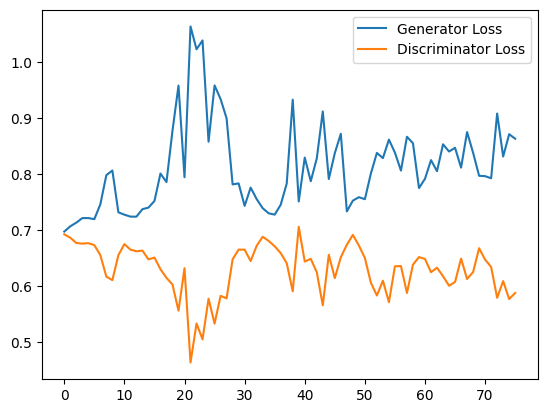

  0%|                                                                                           | 0/26 [00:00<?, ?it/s]

Epoch 60, step 1560: Generator loss: 0.9005869527657827, discriminator loss: 0.5781545579433441


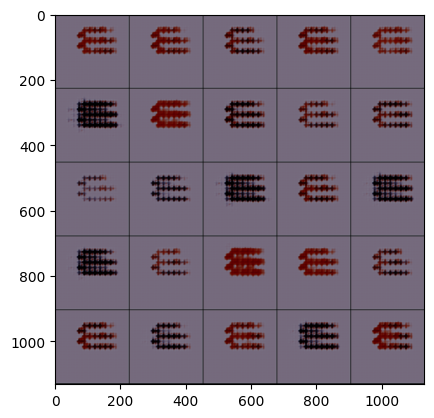

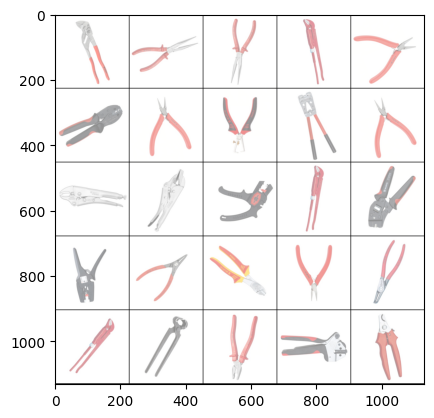

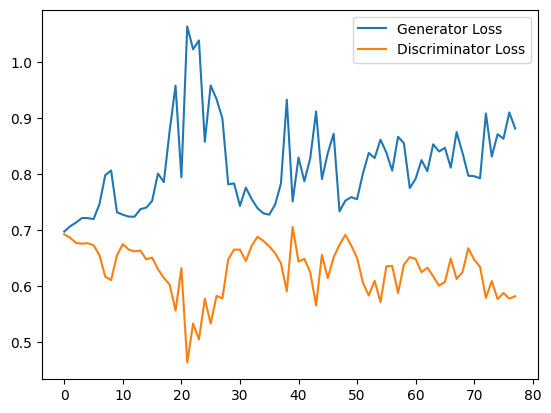

 15%|████████████▊                                                                      | 4/26 [02:44<13:24, 36.58s/it]

Epoch 61, step 1590: Generator loss: 1.0097478449344635, discriminator loss: 0.5308017541964849


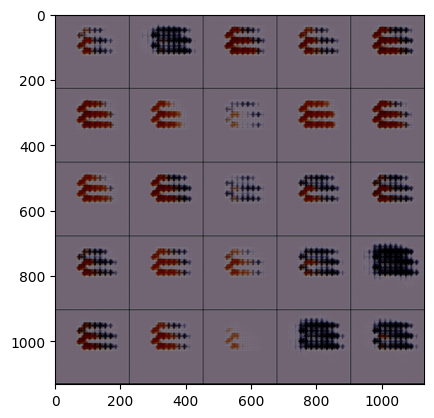

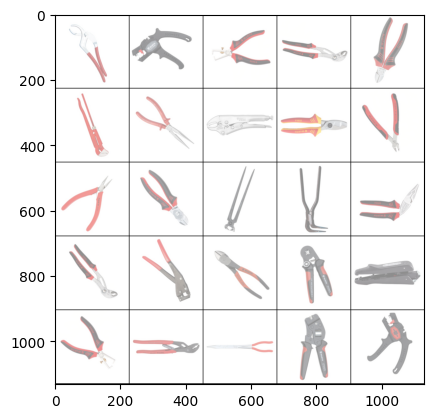

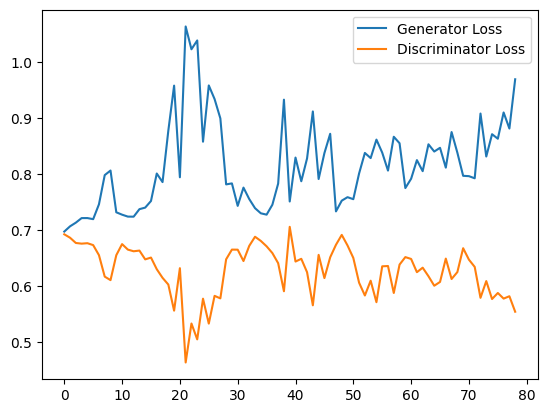

 31%|█████████████████████████▌                                                         | 8/26 [04:48<09:41, 32.32s/it]

Epoch 62, step 1620: Generator loss: 0.9939586599667867, discriminator loss: 0.5470650961001714


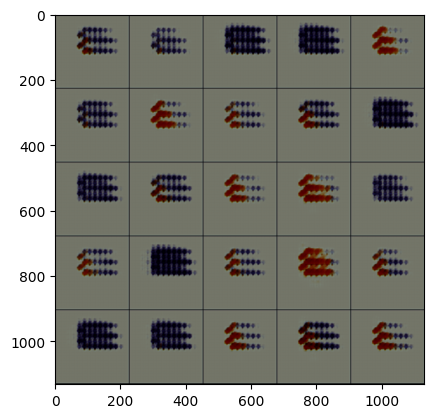

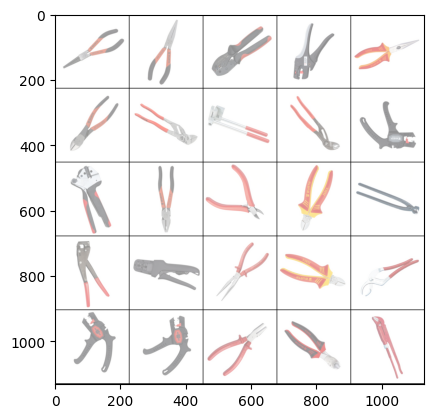

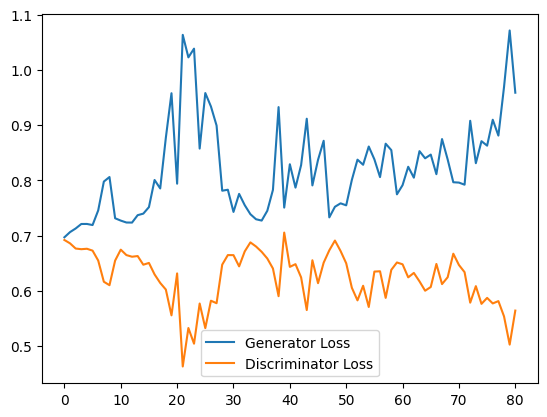

 46%|█████████████████████████████████████▊                                            | 12/26 [06:53<07:20, 31.46s/it]

Epoch 63, step 1650: Generator loss: 1.025576255718867, discriminator loss: 0.5370412091414134


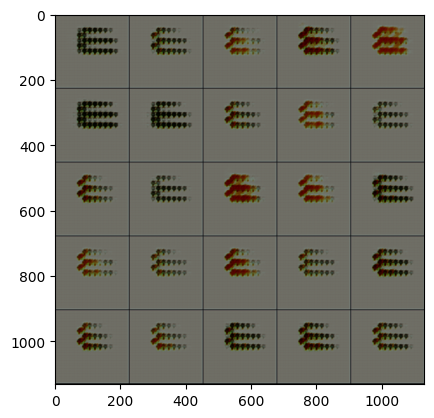

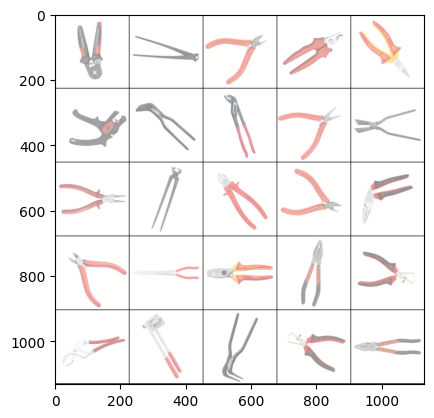

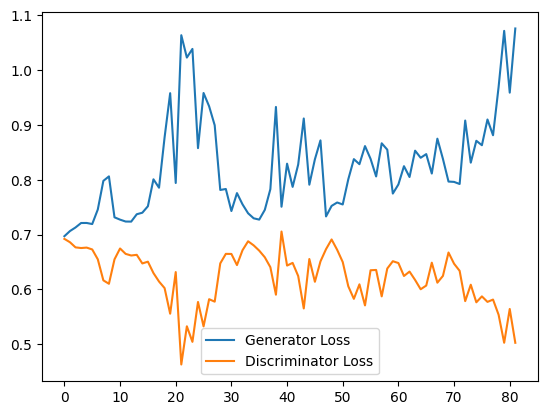

 62%|██████████████████████████████████████████████████▍                               | 16/26 [08:58<05:13, 31.36s/it]

Epoch 64, step 1680: Generator loss: 1.0138203620910644, discriminator loss: 0.5266867051521937


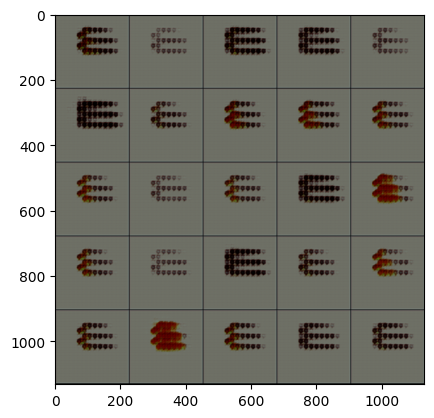

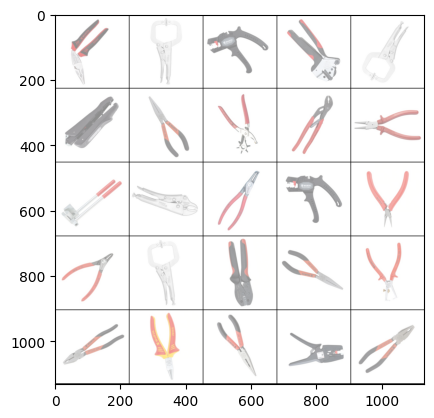

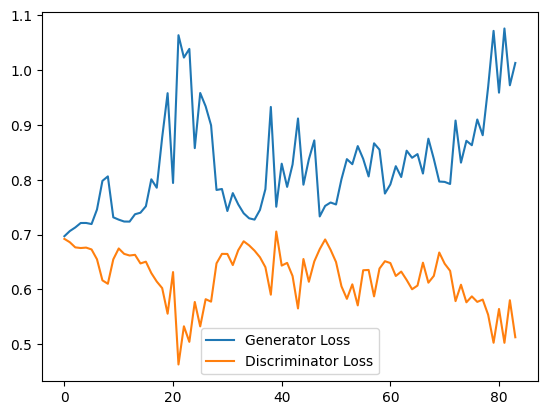

 77%|███████████████████████████████████████████████████████████████                   | 20/26 [11:03<03:07, 31.21s/it]

Epoch 65, step 1710: Generator loss: 1.0153656323750815, discriminator loss: 0.5532362461090088


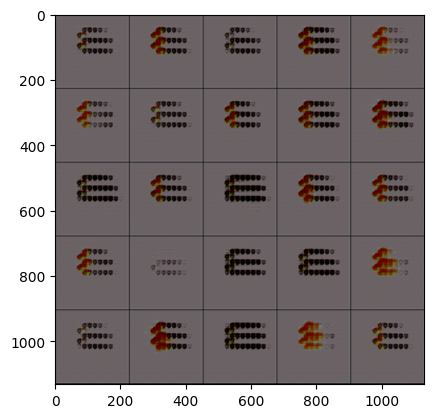

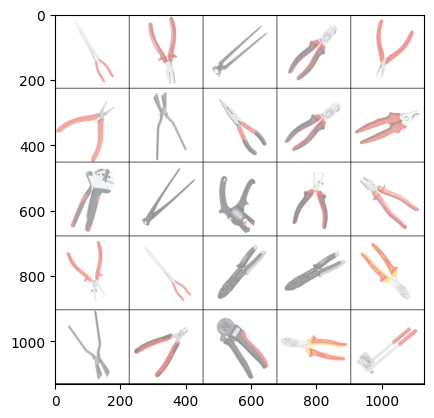

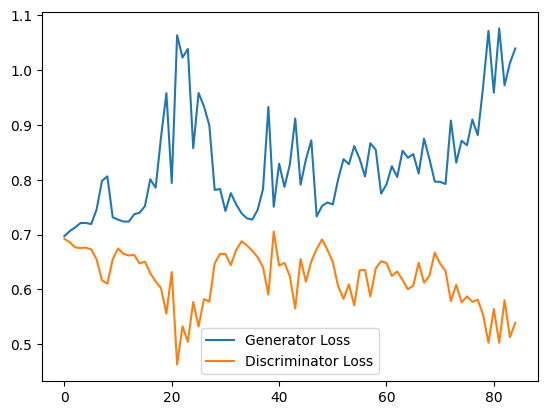

 92%|███████████████████████████████████████████████████████████████████████████▋      | 24/26 [13:07<01:02, 31.06s/it]

Epoch 66, step 1740: Generator loss: 0.9873059888680776, discriminator loss: 0.5582702259222666


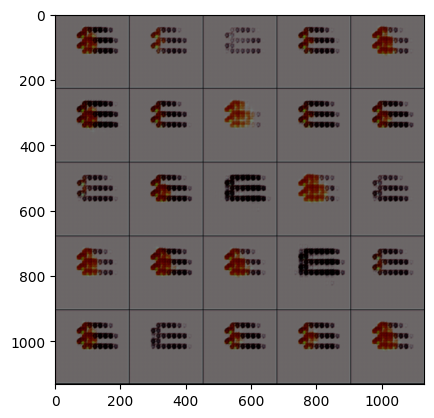

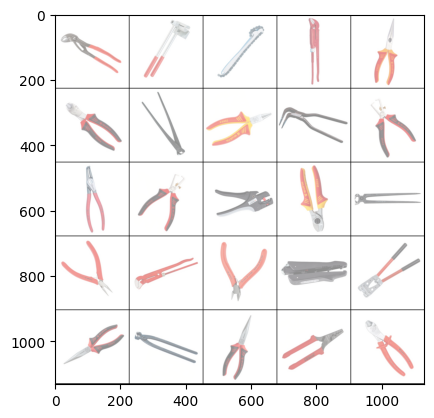

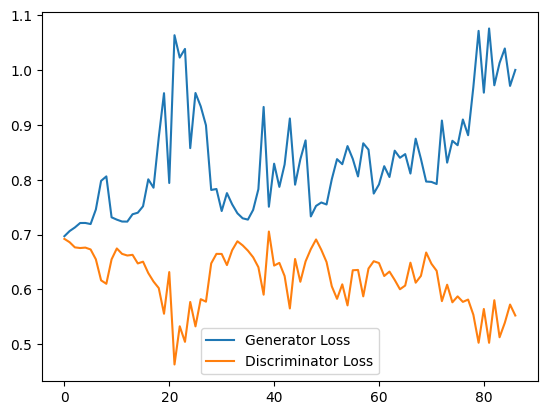

  8%|██████▍                                                                            | 2/26 [01:41<18:56, 47.36s/it]

Epoch 68, step 1770: Generator loss: 0.9666415731112162, discriminator loss: 0.5638545672098796


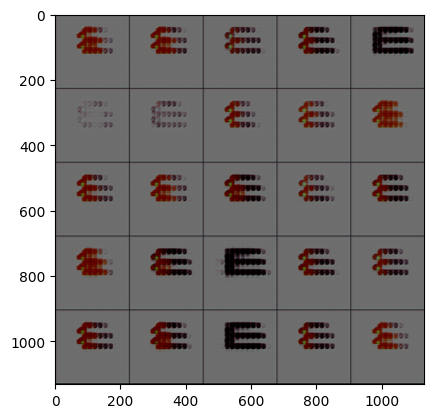

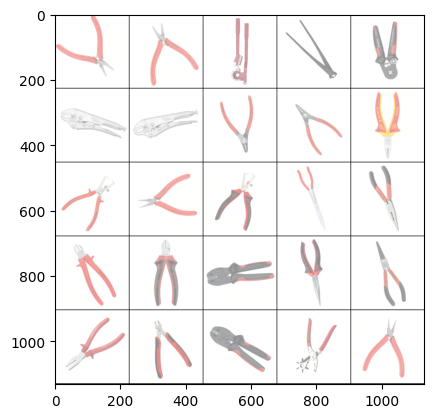

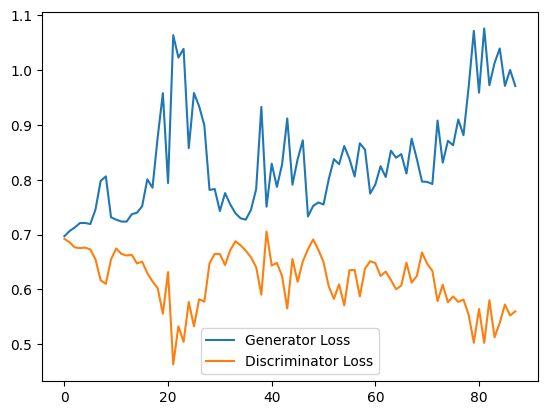

 23%|███████████████████▏                                                               | 6/26 [03:45<11:07, 33.39s/it]

Epoch 69, step 1800: Generator loss: 0.8988532106081645, discriminator loss: 0.6100517670313518


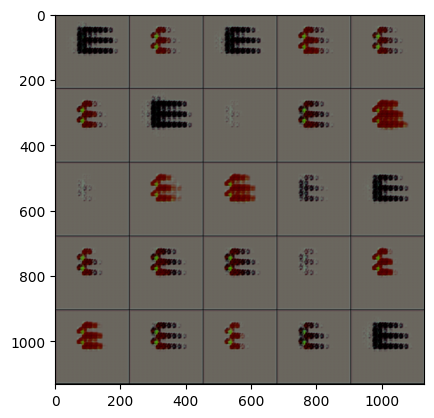

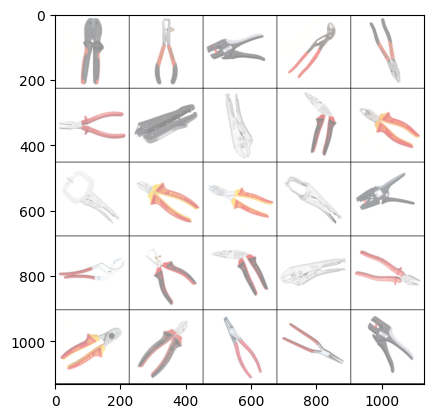

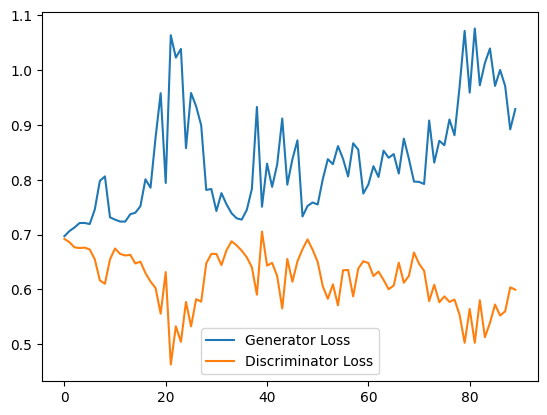

 38%|███████████████████████████████▌                                                  | 10/26 [05:51<08:28, 31.80s/it]

Epoch 70, step 1830: Generator loss: 0.9626012583573659, discriminator loss: 0.5717132230599721


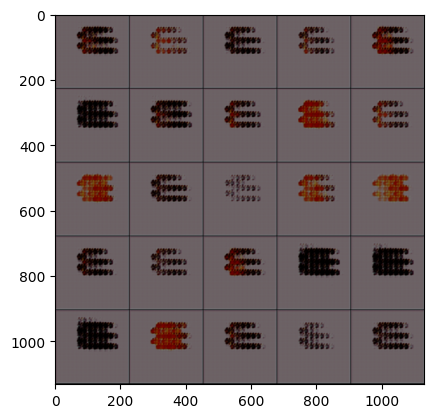

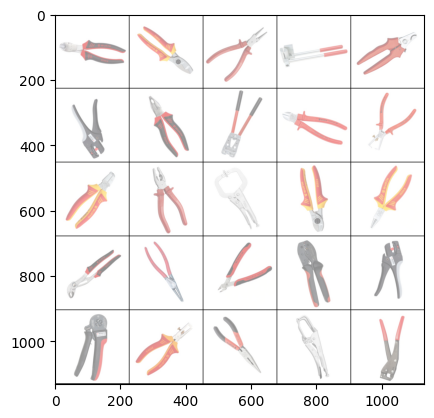

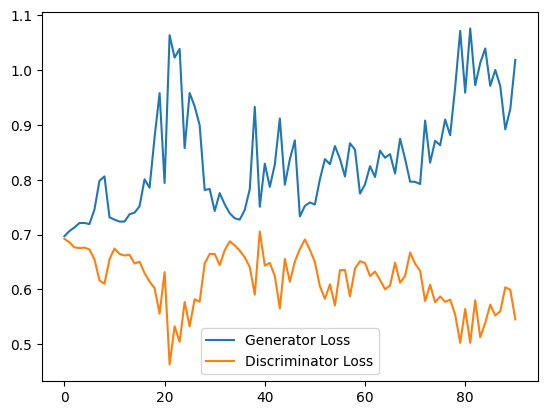

 54%|████████████████████████████████████████████▏                                     | 14/26 [08:01<06:20, 31.73s/it]

Epoch 71, step 1860: Generator loss: 0.9801109611988068, discriminator loss: 0.5637911995251973


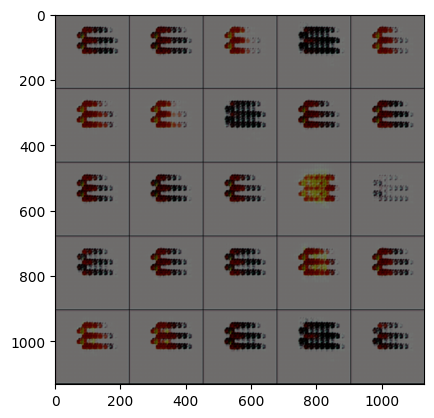

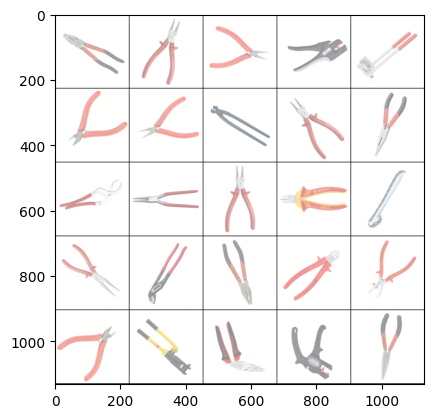

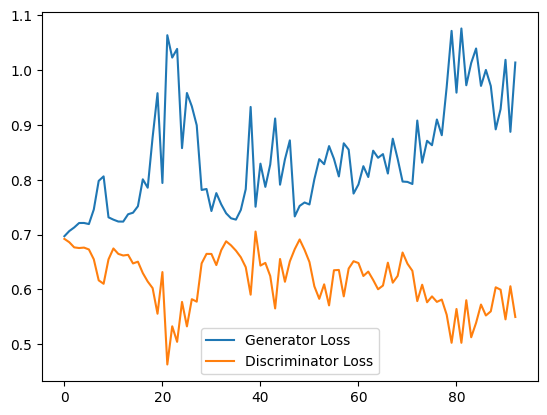

 69%|████████████████████████████████████████████████████████▊                         | 18/26 [10:08<04:14, 31.78s/it]

Epoch 72, step 1890: Generator loss: 0.8277938922246297, discriminator loss: 0.6517843226591746


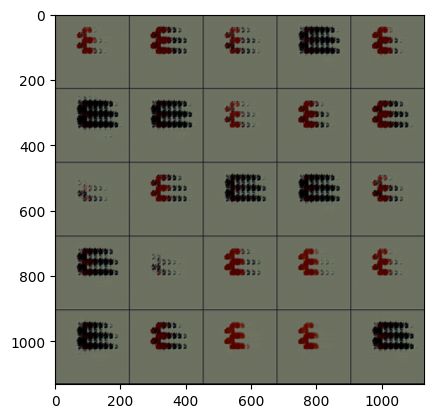

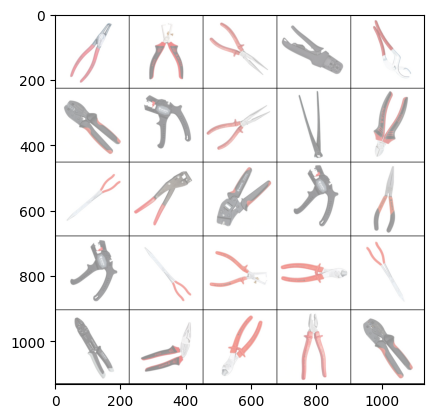

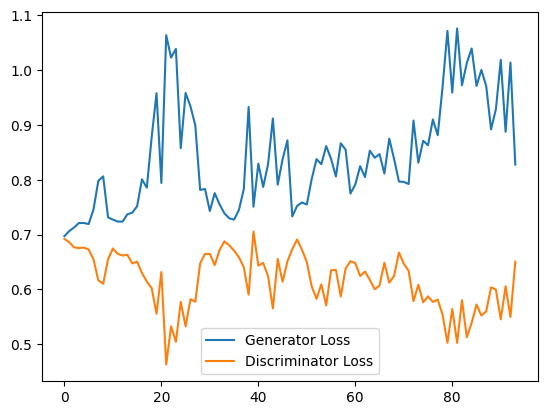

 85%|█████████████████████████████████████████████████████████████████████▍            | 22/26 [12:12<02:06, 31.52s/it]

Epoch 73, step 1920: Generator loss: 0.9391769488652547, discriminator loss: 0.5783535897731781


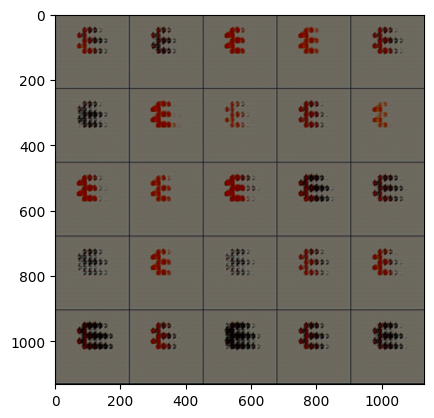

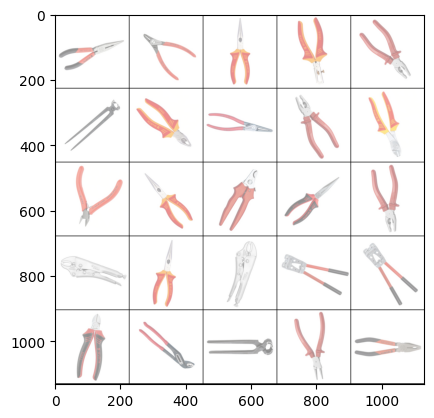

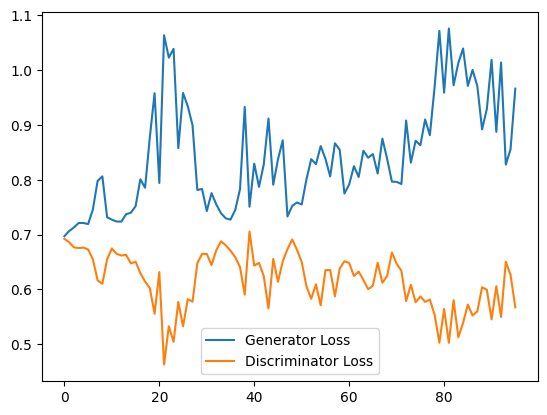

  0%|                                                                                           | 0/26 [00:00<?, ?it/s]

Epoch 75, step 1950: Generator loss: 0.8469224592049917, discriminator loss: 0.6174377302328745


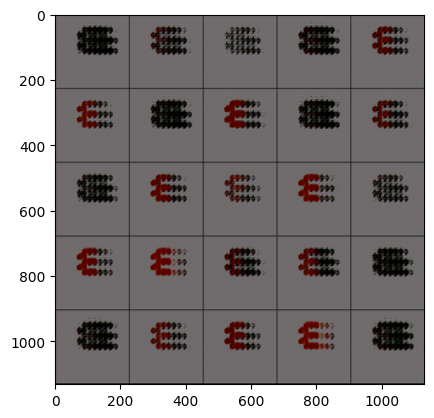

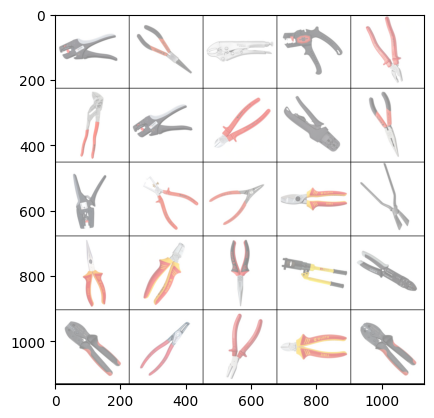

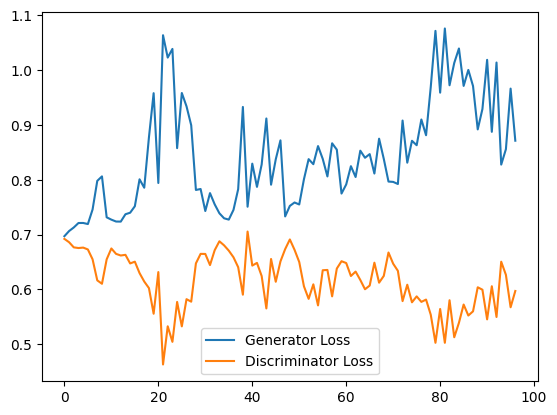

 15%|████████████▊                                                                      | 4/26 [02:44<13:31, 36.88s/it]

Epoch 76, step 1980: Generator loss: 0.935332735379537, discriminator loss: 0.5595509072144826


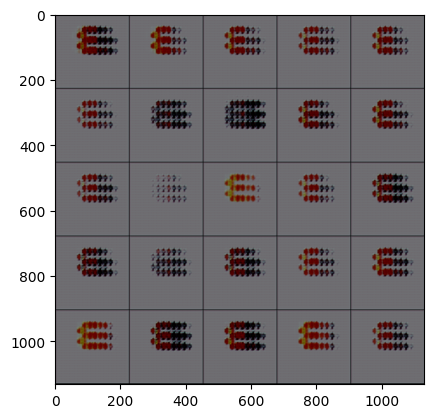

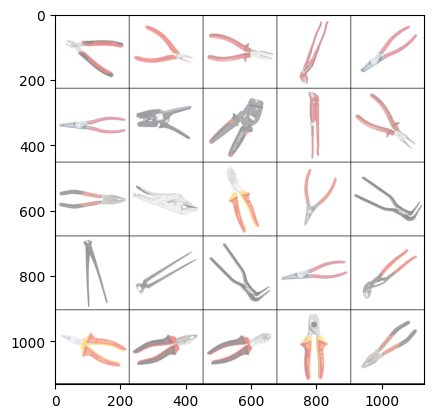

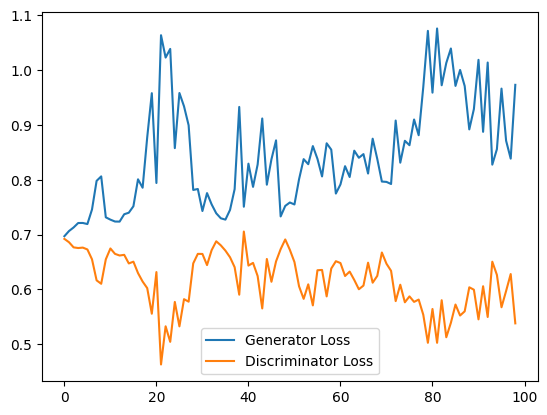

 31%|█████████████████████████▌                                                         | 8/26 [04:47<09:40, 32.22s/it]

Epoch 77, step 2010: Generator loss: 0.9651149988174439, discriminator loss: 0.5807154556115468


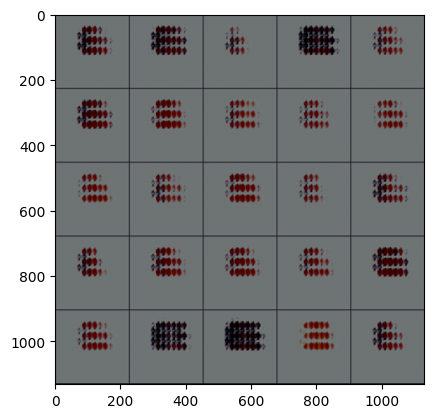

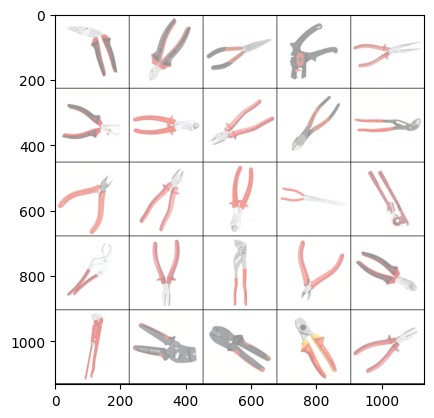

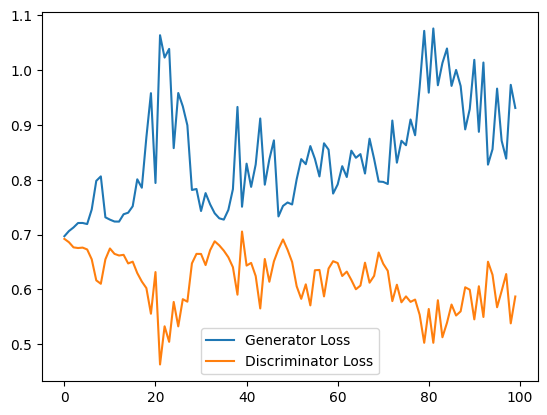

 46%|█████████████████████████████████████▊                                            | 12/26 [06:52<07:20, 31.48s/it]

Epoch 78, step 2040: Generator loss: 0.9077451527118683, discriminator loss: 0.6020696441332499


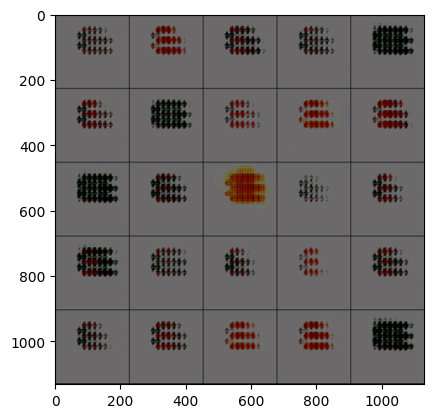

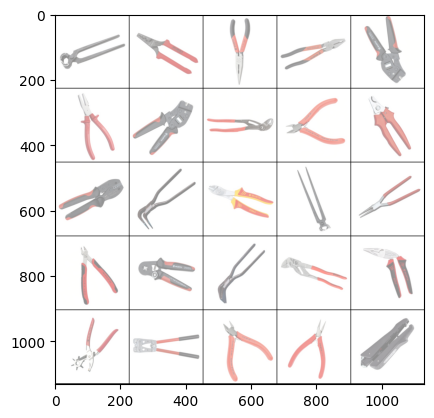

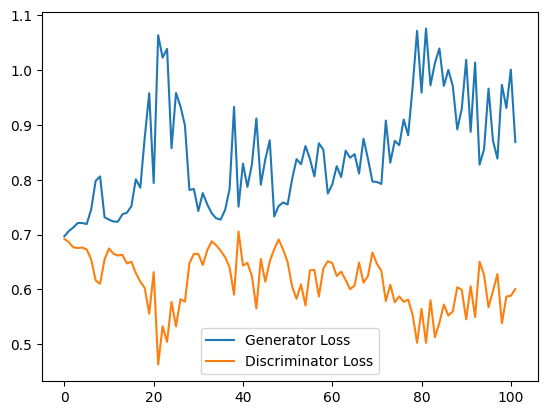

 62%|██████████████████████████████████████████████████▍                               | 16/26 [09:04<05:22, 32.29s/it]

Epoch 79, step 2070: Generator loss: 0.8577685217062633, discriminator loss: 0.6182634770870209


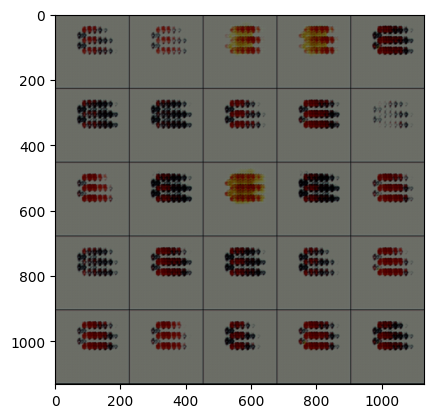

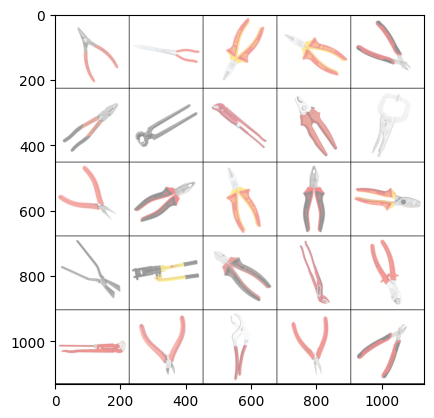

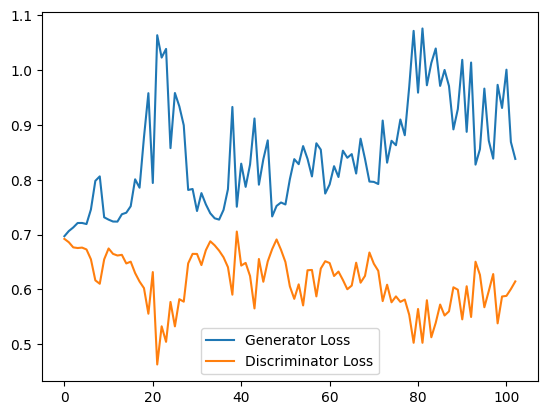

 77%|███████████████████████████████████████████████████████████████                   | 20/26 [11:11<03:09, 31.61s/it]

Epoch 80, step 2100: Generator loss: 0.889642224709193, discriminator loss: 0.5907691816488901


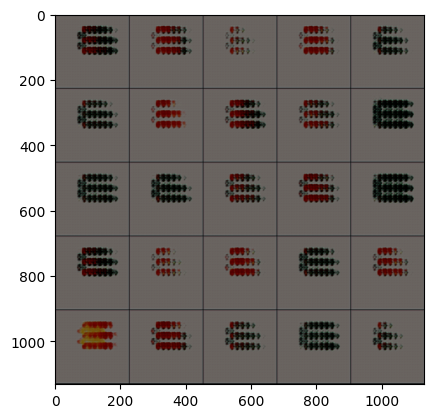

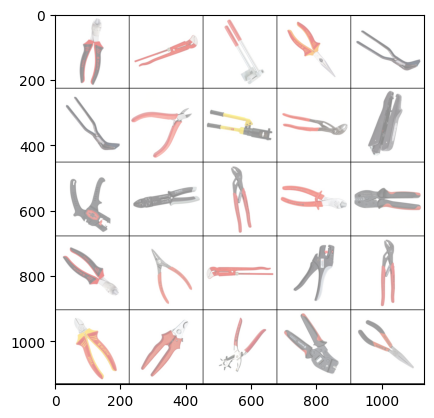

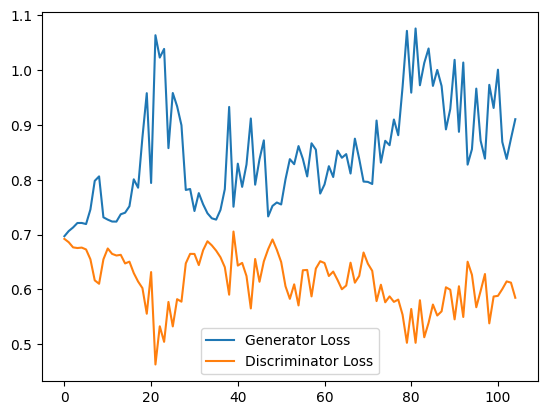

 92%|███████████████████████████████████████████████████████████████████████████▋      | 24/26 [13:18<01:03, 31.64s/it]

Epoch 81, step 2130: Generator loss: 0.9858340620994568, discriminator loss: 0.5797112733125687


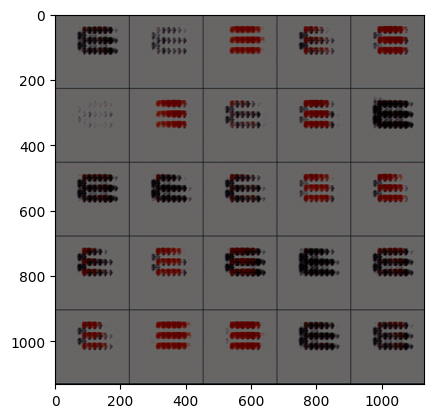

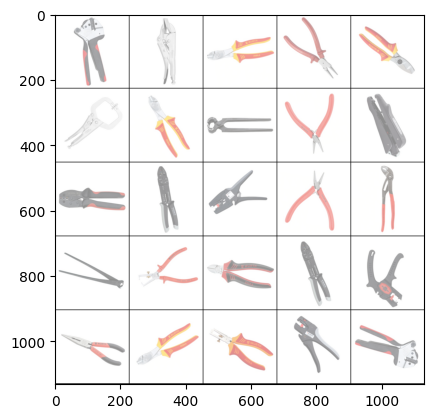

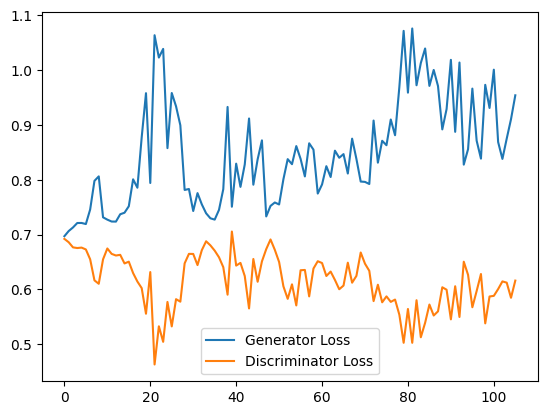

  8%|██████▍                                                                            | 2/26 [01:41<18:55, 47.31s/it]

Epoch 83, step 2160: Generator loss: 1.093780336777369, discriminator loss: 0.47702550888061523


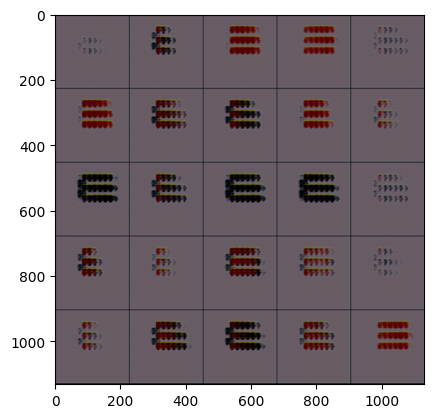

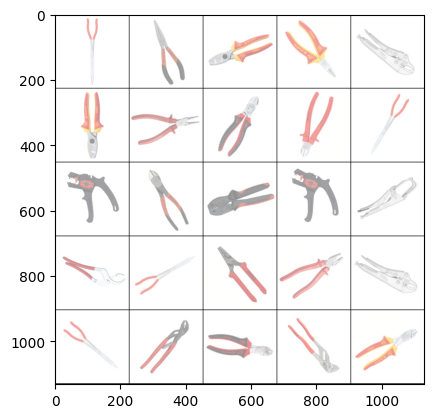

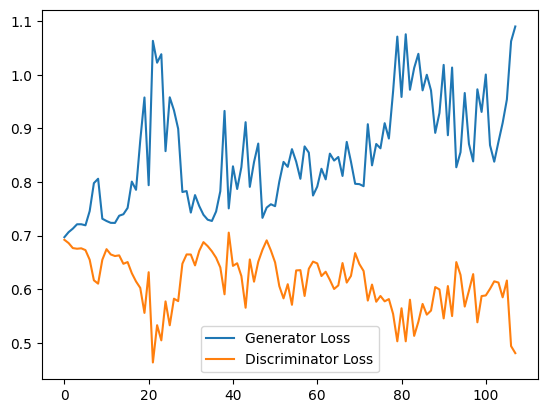

 23%|███████████████████▏                                                               | 6/26 [03:47<11:16, 33.84s/it]

Epoch 84, step 2190: Generator loss: 1.1378901958465577, discriminator loss: 0.4865986227989197


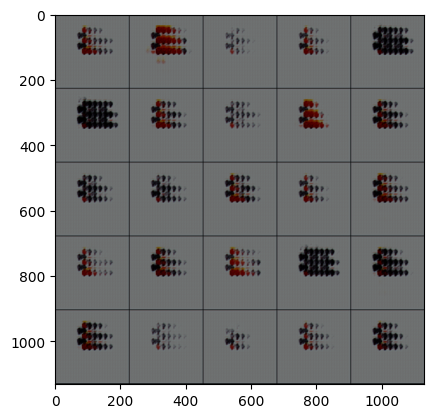

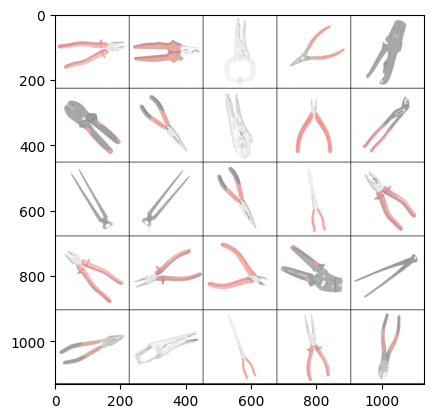

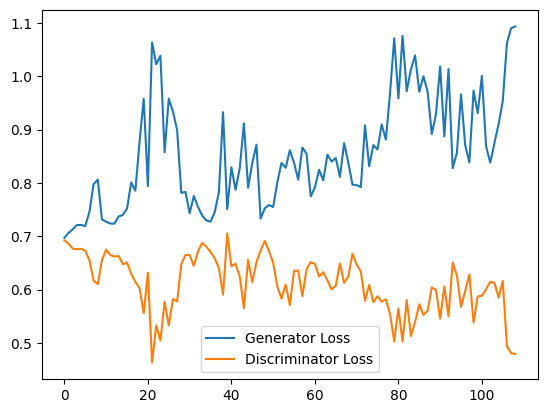

 38%|███████████████████████████████▌                                                  | 10/26 [05:55<08:37, 32.34s/it]

Epoch 85, step 2220: Generator loss: 0.9210084696610769, discriminator loss: 0.5874678353468578


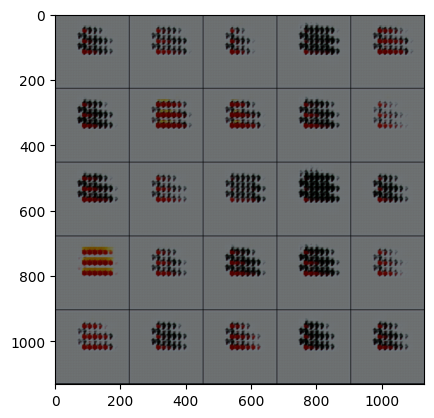

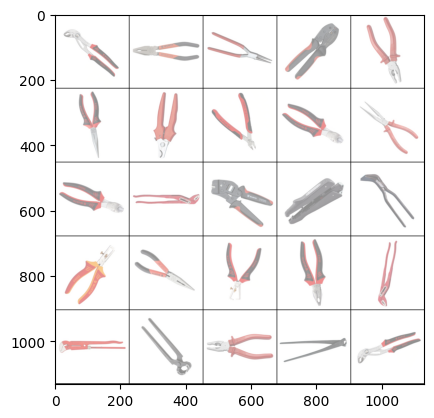

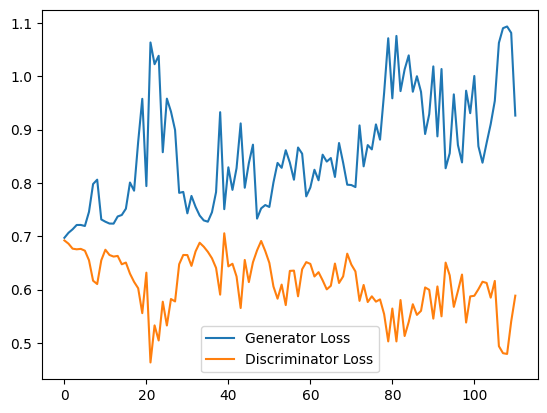

 54%|████████████████████████████████████████████▏                                     | 14/26 [08:00<06:22, 31.83s/it]

Epoch 86, step 2250: Generator loss: 0.8949008762836457, discriminator loss: 0.609165636698405


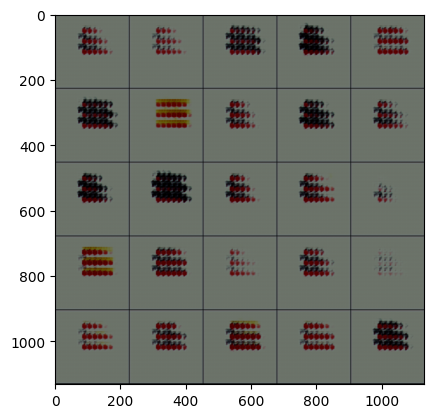

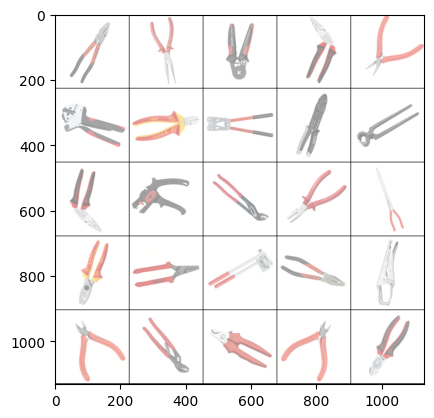

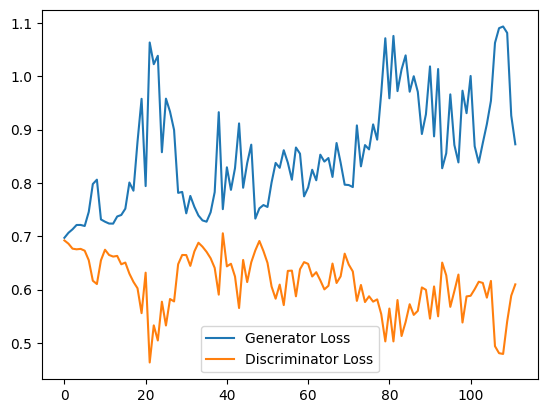

 69%|████████████████████████████████████████████████████████▊                         | 18/26 [10:07<04:12, 31.62s/it]

Epoch 87, step 2280: Generator loss: 0.8967414398988088, discriminator loss: 0.5846398969491323


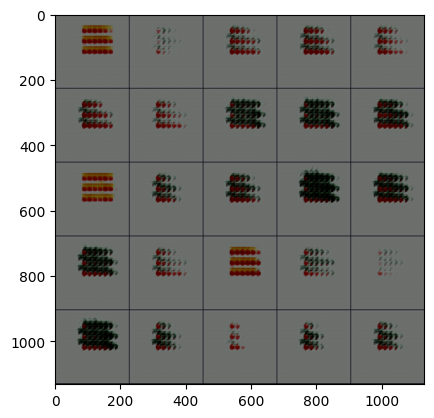

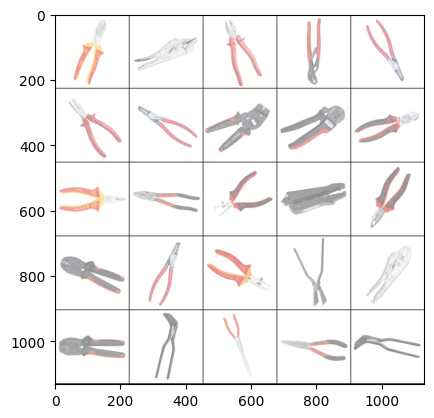

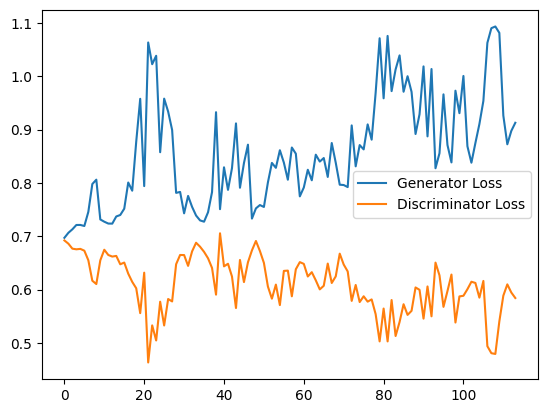

 85%|█████████████████████████████████████████████████████████████████████▍            | 22/26 [12:16<02:06, 31.56s/it]

Epoch 88, step 2310: Generator loss: 0.8919796446959177, discriminator loss: 0.5884730120499929


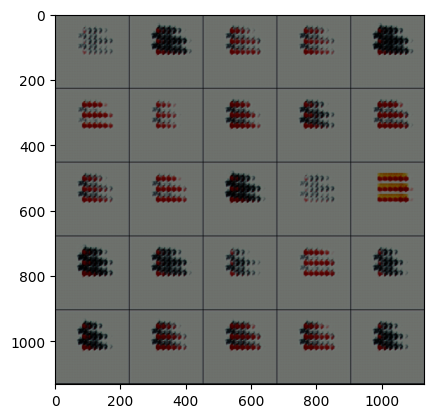

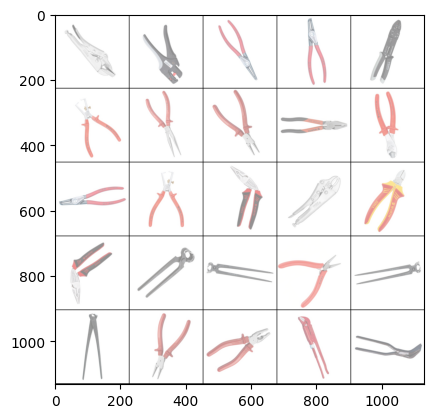

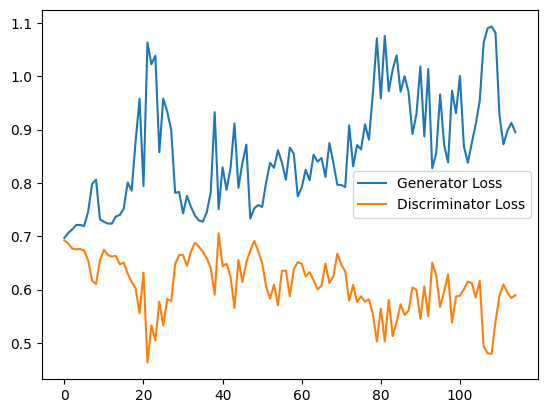

  0%|                                                                                           | 0/26 [00:00<?, ?it/s]

Epoch 90, step 2340: Generator loss: 0.9224943737188975, discriminator loss: 0.5709804614384969


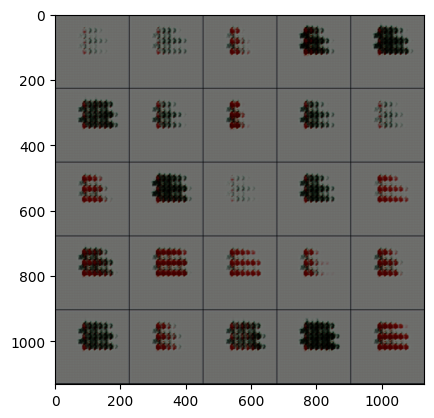

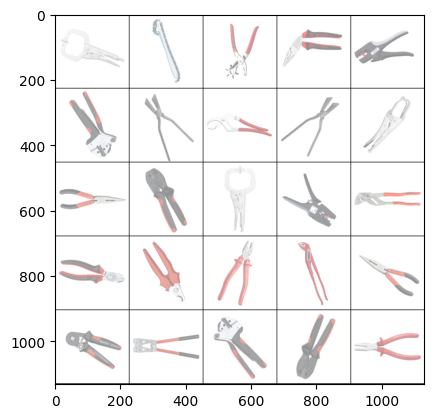

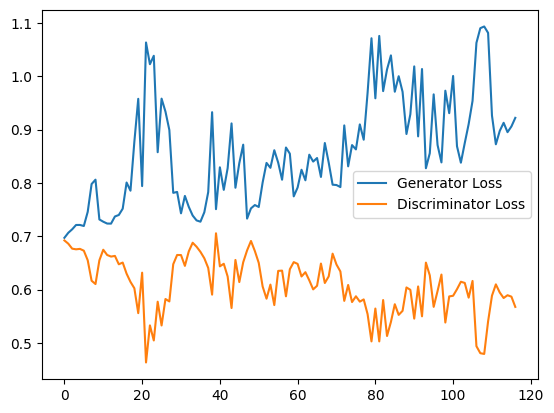

 15%|████████████▊                                                                      | 4/26 [02:41<13:22, 36.50s/it]

Epoch 91, step 2370: Generator loss: 0.9340805828571319, discriminator loss: 0.5712994396686554


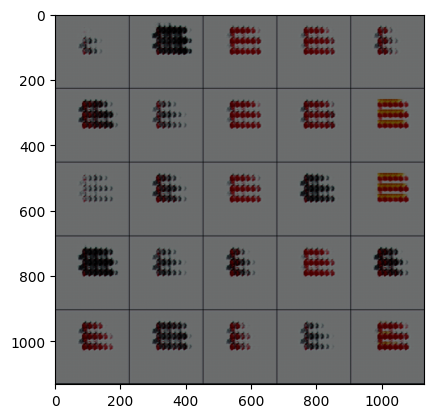

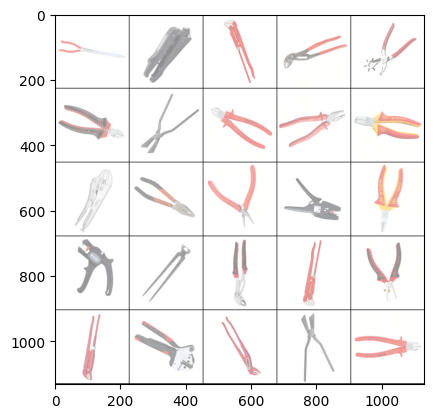

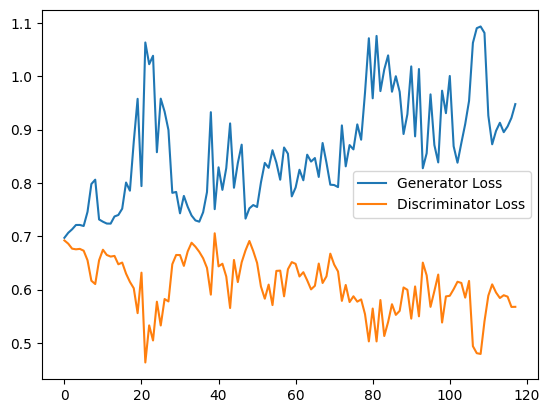

 31%|█████████████████████████▌                                                         | 8/26 [04:43<09:37, 32.11s/it]

Epoch 92, step 2400: Generator loss: 0.9225412130355835, discriminator loss: 0.6038548688093821


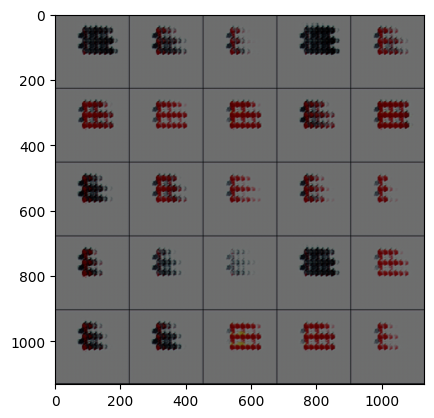

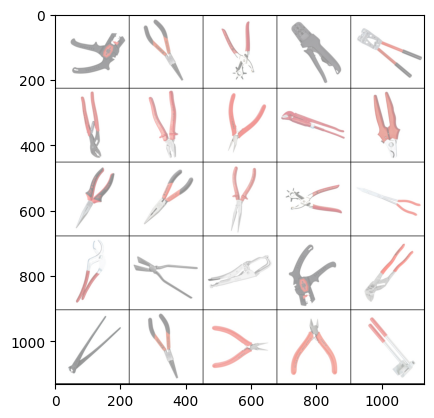

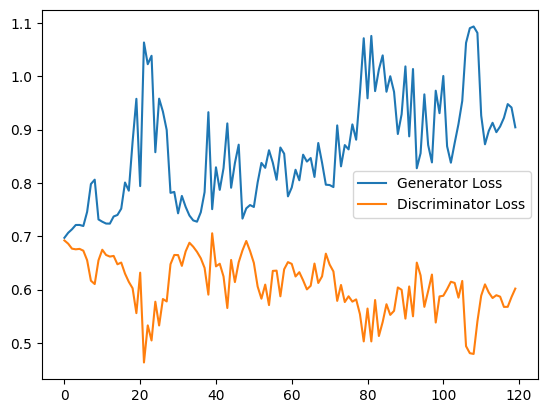

 46%|█████████████████████████████████████▊                                            | 12/26 [06:50<07:20, 31.48s/it]

Epoch 93, step 2430: Generator loss: 1.0221473733584086, discriminator loss: 0.5550842195749283


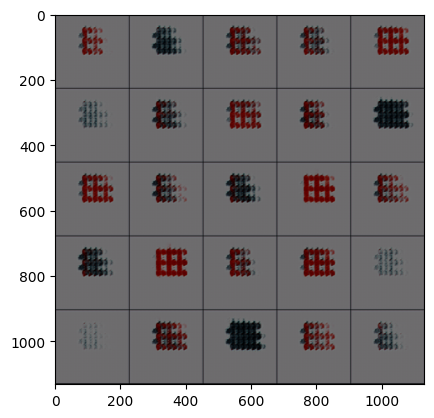

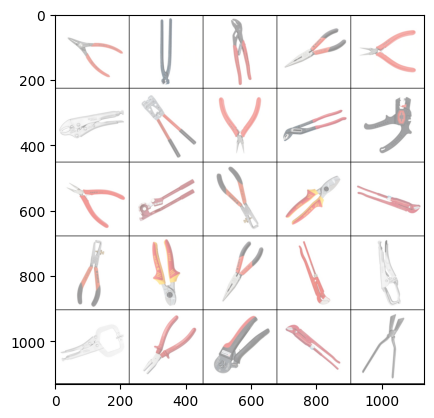

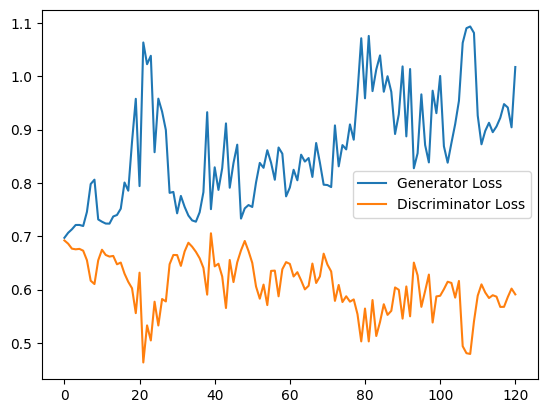

 62%|██████████████████████████████████████████████████▍                               | 16/26 [08:54<05:13, 31.38s/it]

Epoch 94, step 2460: Generator loss: 1.1169724702835082, discriminator loss: 0.46878699163595833


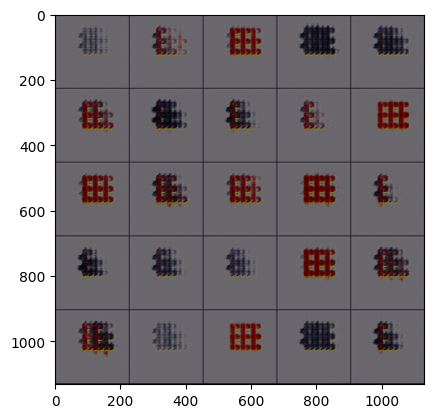

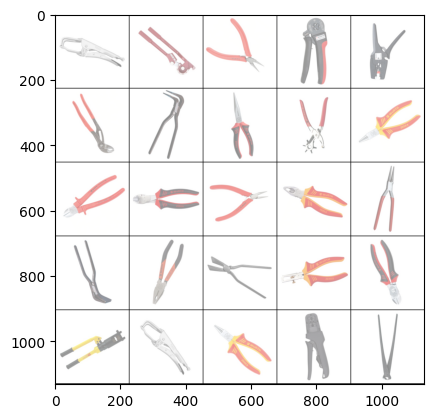

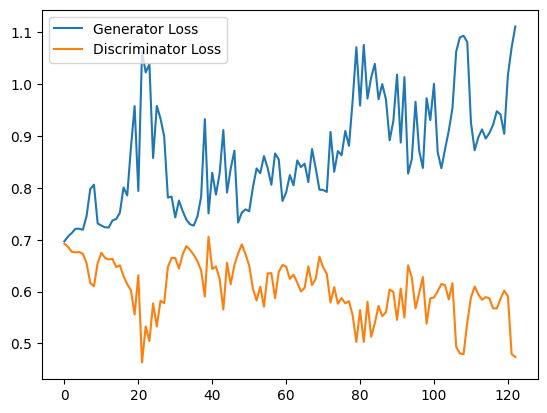

 77%|███████████████████████████████████████████████████████████████                   | 20/26 [11:01<03:06, 31.11s/it]

Epoch 95, step 2490: Generator loss: 1.0852197607358296, discriminator loss: 0.5170324722925822


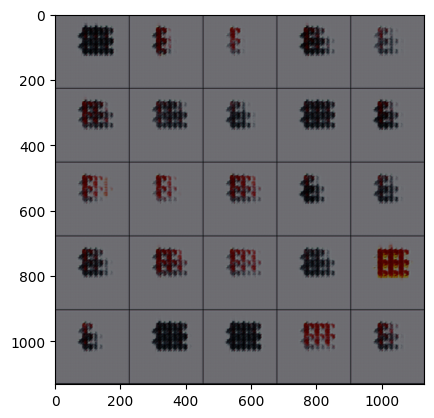

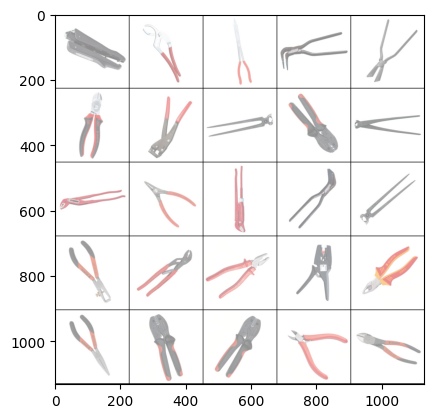

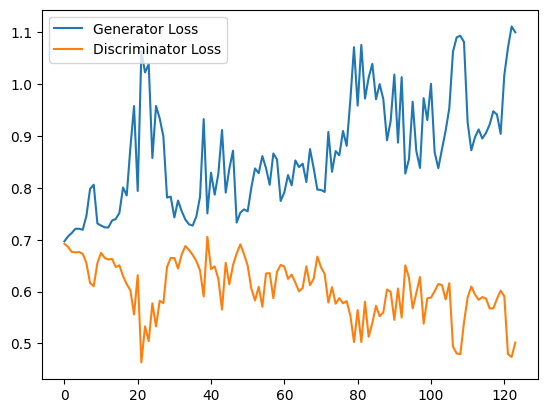

 92%|███████████████████████████████████████████████████████████████████████████▋      | 24/26 [13:09<01:02, 31.16s/it]

Epoch 96, step 2520: Generator loss: 0.9167231460412343, discriminator loss: 0.5918159703413646


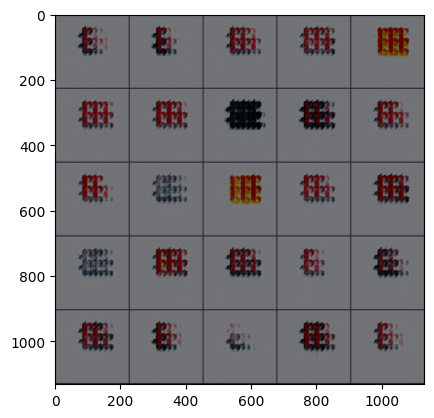

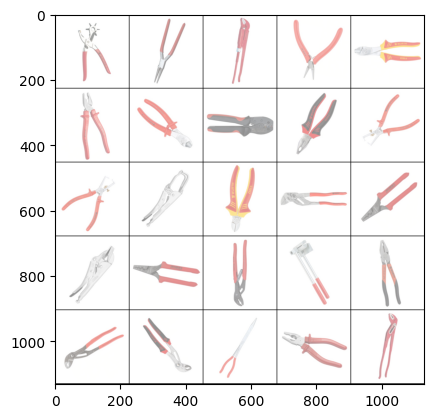

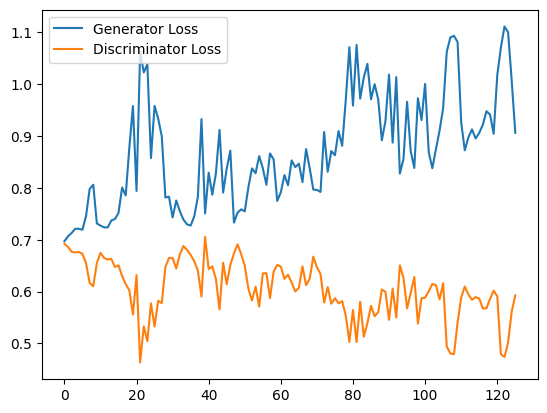

  8%|██████▍                                                                            | 2/26 [01:37<18:19, 45.79s/it]

Epoch 98, step 2550: Generator loss: 0.8985251804192861, discriminator loss: 0.6066498974959056


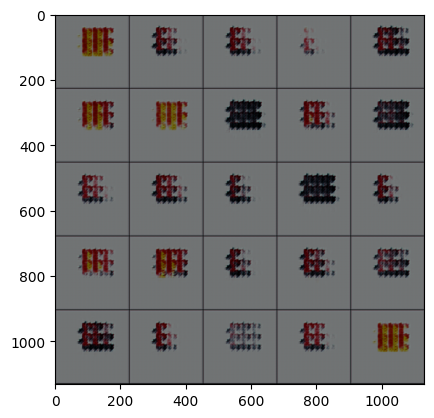

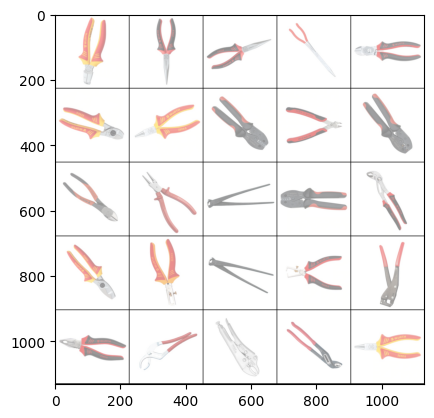

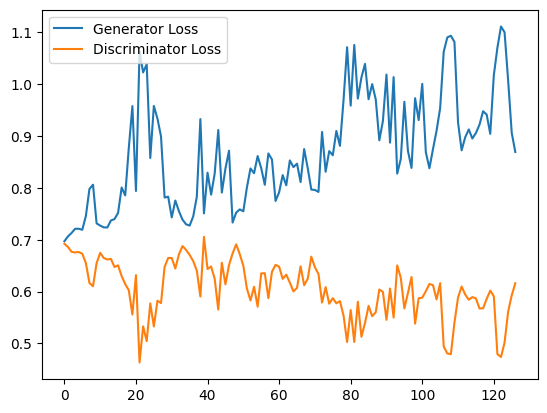

 23%|███████████████████▏                                                               | 6/26 [03:45<11:17, 33.86s/it]

Epoch 99, step 2580: Generator loss: 0.9622965335845948, discriminator loss: 0.5845361808935802


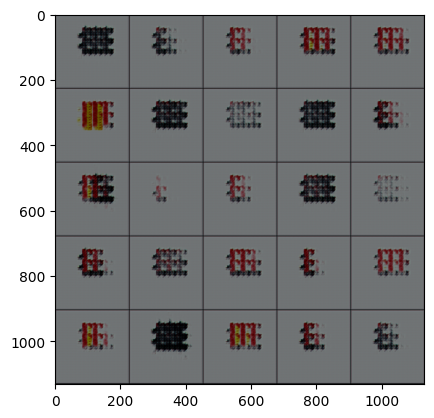

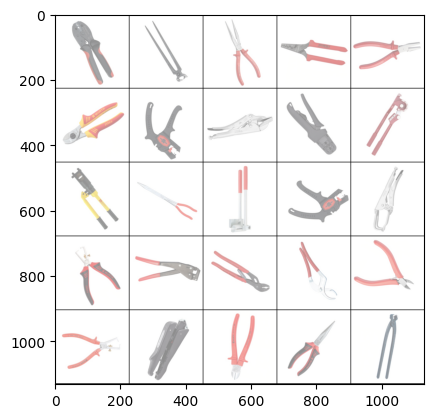

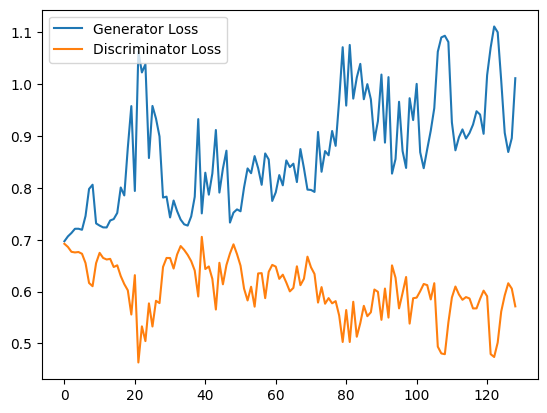

 38%|███████████████████████████████▌                                                  | 10/26 [05:52<08:39, 32.47s/it]

Epoch 100, step 2610: Generator loss: 0.9445814291636149, discriminator loss: 0.5899352153142293


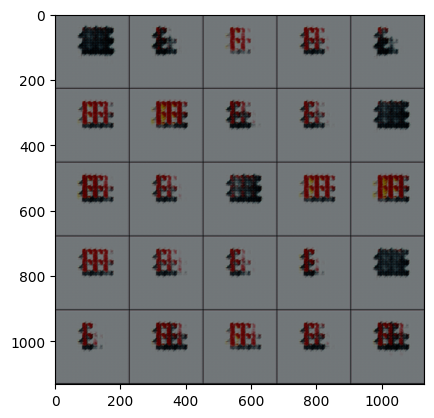

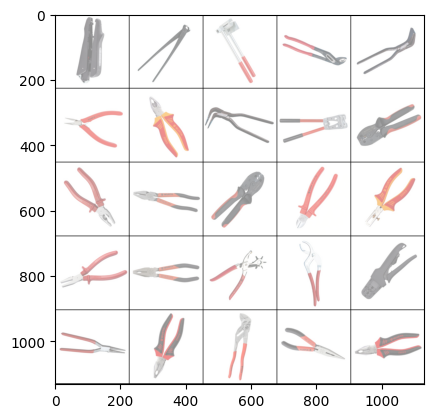

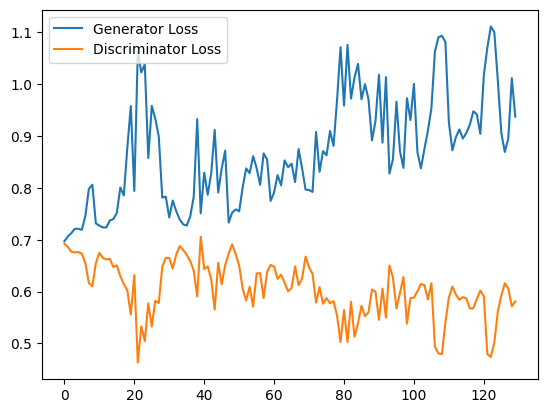

 54%|████████████████████████████████████████████▏                                     | 14/26 [08:03<06:26, 32.23s/it]

Epoch 101, step 2640: Generator loss: 0.897212008635203, discriminator loss: 0.6083533068497976


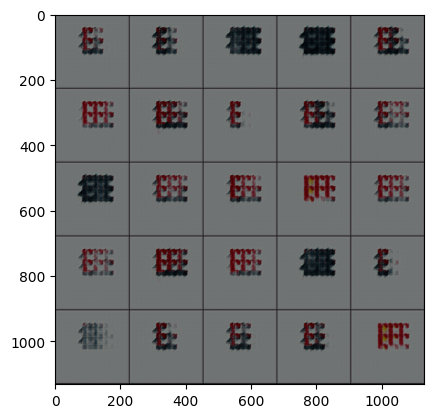

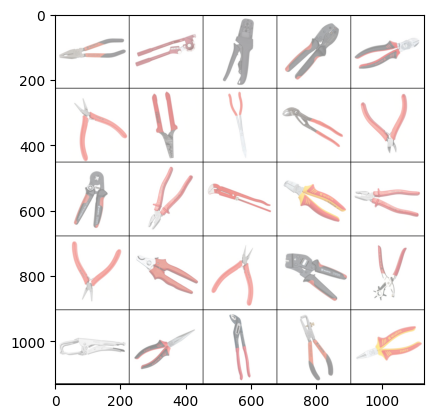

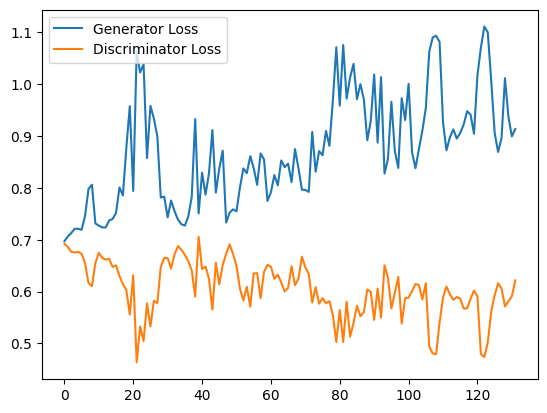

 69%|████████████████████████████████████████████████████████▊                         | 18/26 [10:08<04:15, 31.91s/it]

Epoch 102, step 2670: Generator loss: 0.8530424455801646, discriminator loss: 0.6176657438278198


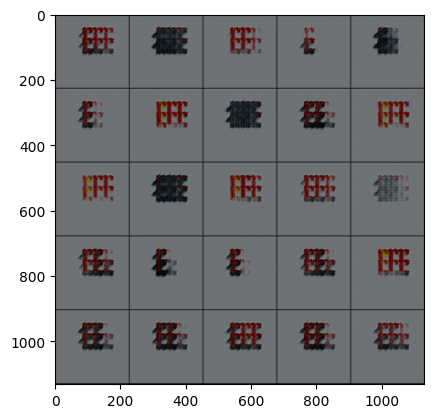

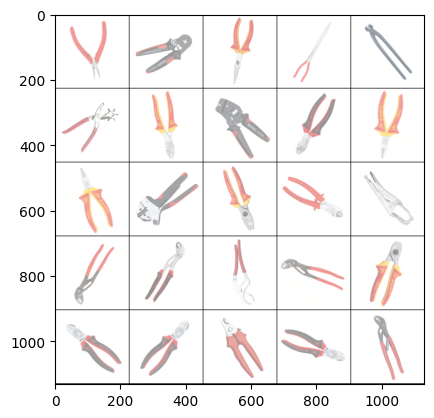

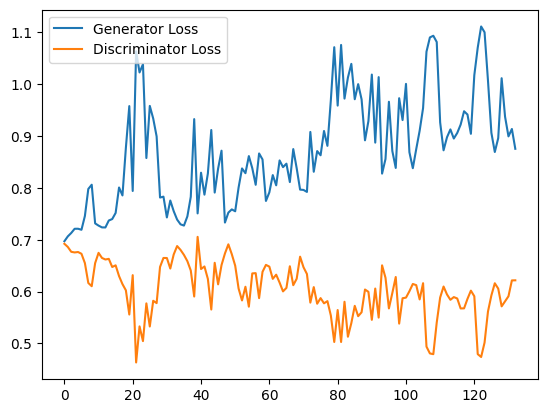

 85%|█████████████████████████████████████████████████████████████████████▍            | 22/26 [12:12<02:06, 31.61s/it]

Epoch 103, step 2700: Generator loss: 0.8768224120140076, discriminator loss: 0.6166536351044972


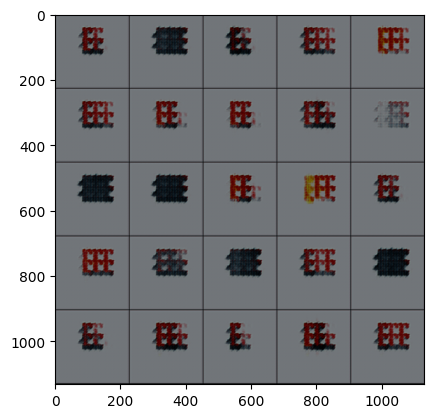

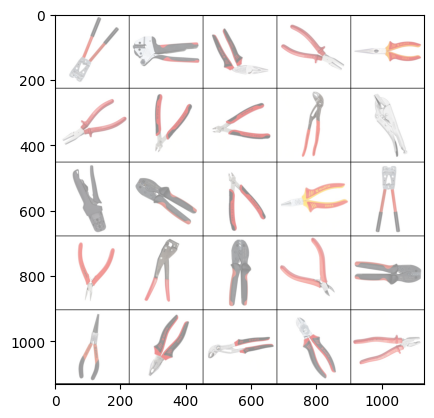

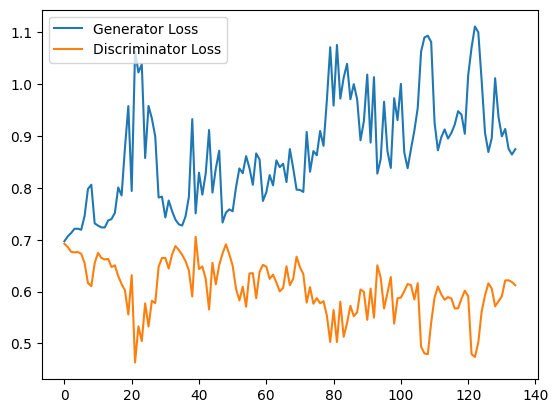

  0%|                                                                                           | 0/26 [00:00<?, ?it/s]

Epoch 105, step 2730: Generator loss: 0.8325723926226298, discriminator loss: 0.6145527561505636


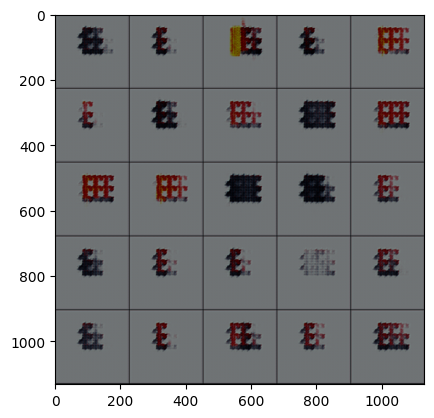

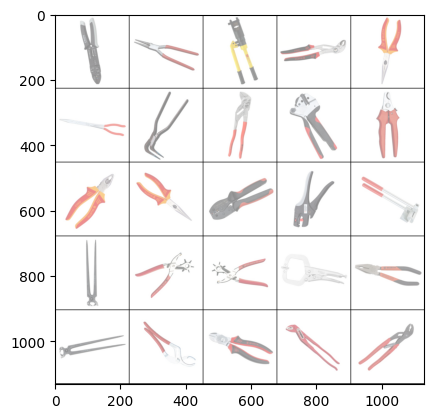

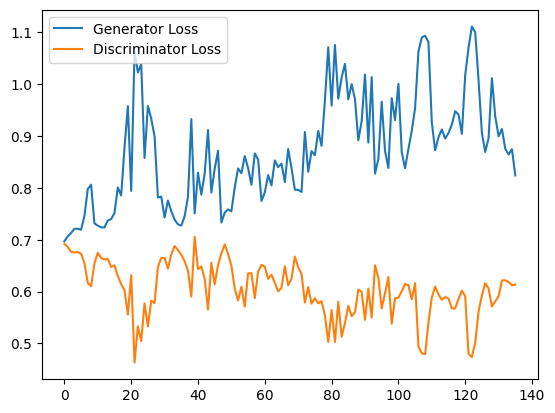

 15%|████████████▊                                                                      | 4/26 [02:42<13:31, 36.89s/it]

Epoch 106, step 2760: Generator loss: 0.8583658854166667, discriminator loss: 0.6200612366199494


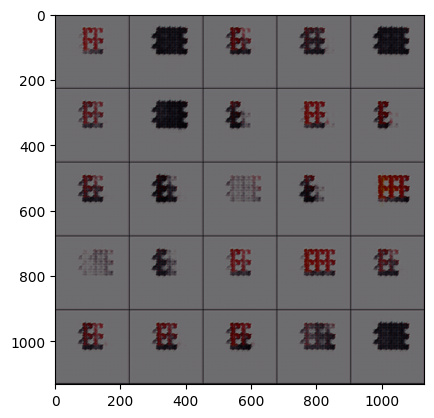

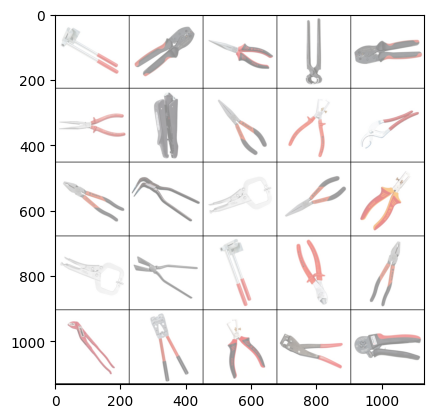

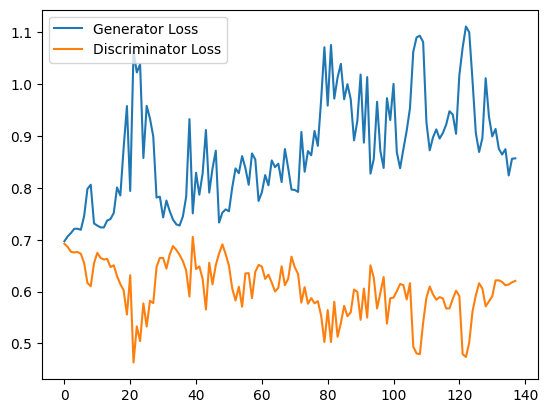

 31%|█████████████████████████▌                                                         | 8/26 [04:57<10:08, 33.80s/it]

Epoch 107, step 2790: Generator loss: 0.83196981549263, discriminator loss: 0.6185783088207245


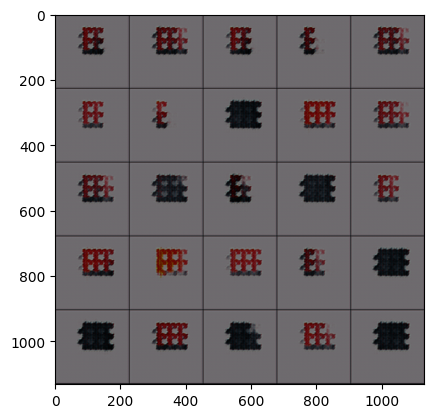

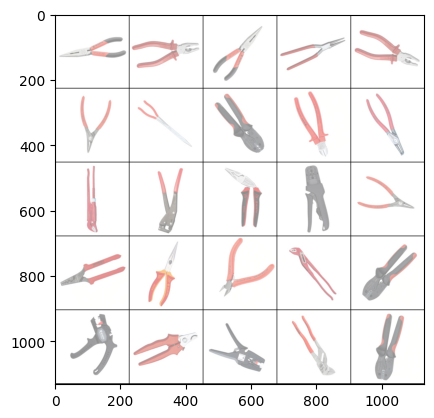

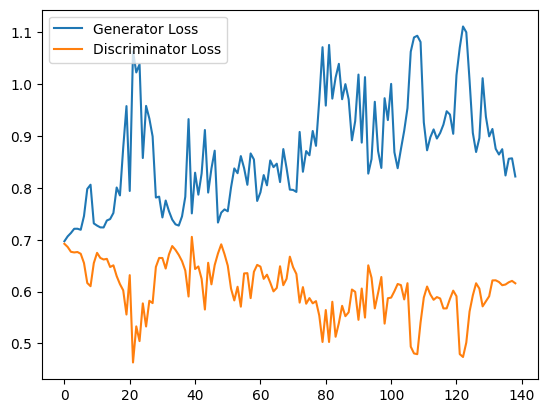

 46%|█████████████████████████████████████▊                                            | 12/26 [07:04<07:39, 32.84s/it]

Epoch 108, step 2820: Generator loss: 0.833876637617747, discriminator loss: 0.629807565609614


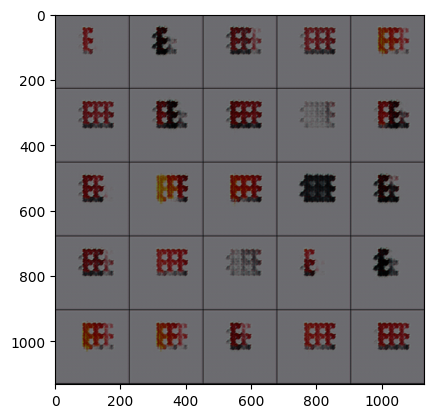

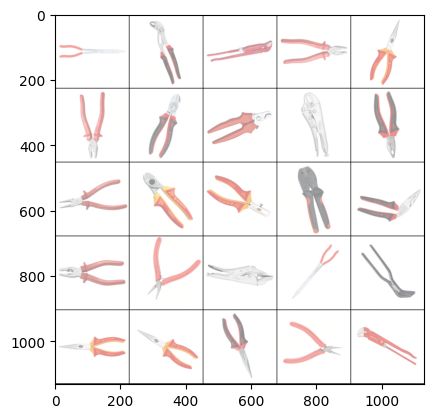

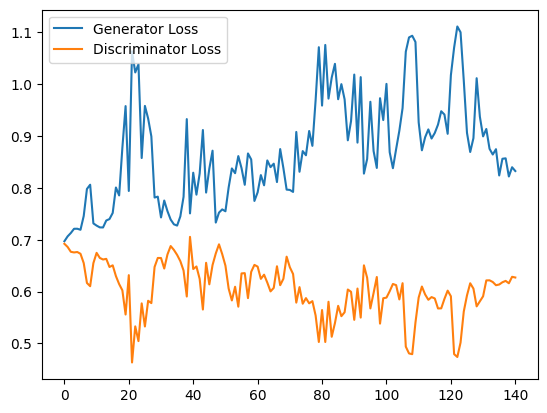

 62%|██████████████████████████████████████████████████▍                               | 16/26 [09:13<05:24, 32.42s/it]

Epoch 109, step 2850: Generator loss: 0.82687353293101, discriminator loss: 0.6297713279724121


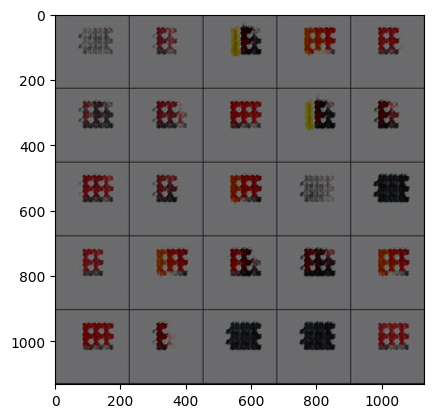

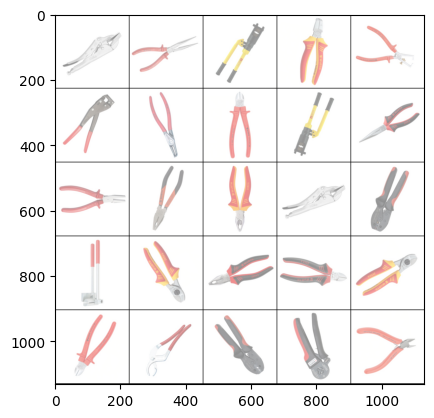

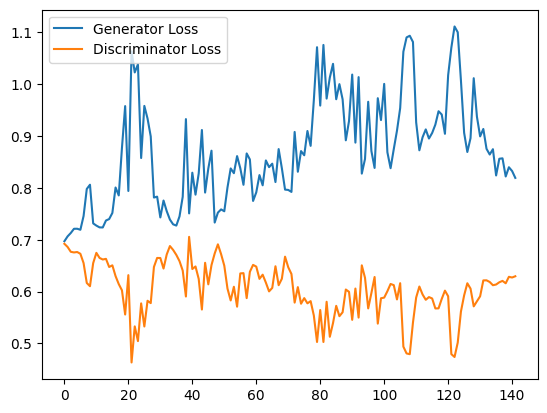

 77%|███████████████████████████████████████████████████████████████                   | 20/26 [11:10<03:11, 31.87s/it]

Epoch 110, step 2880: Generator loss: 0.7920158545176188, discriminator loss: 0.6483816345532735


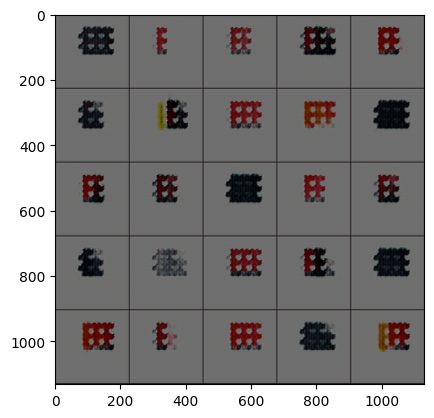

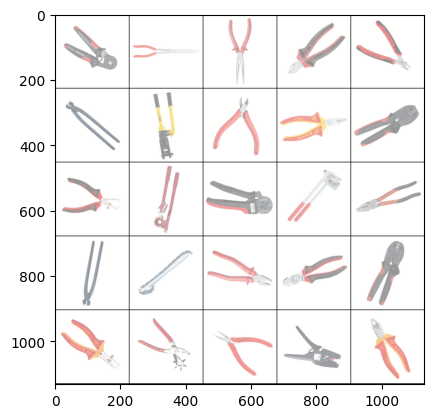

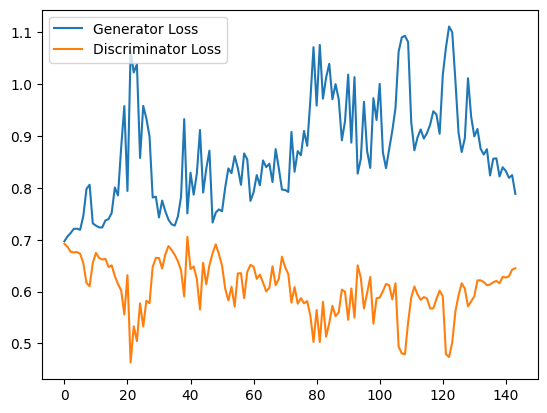

 92%|███████████████████████████████████████████████████████████████████████████▋      | 24/26 [13:38<01:04, 32.25s/it]

Epoch 111, step 2910: Generator loss: 0.8166012664635977, discriminator loss: 0.6338289916515351


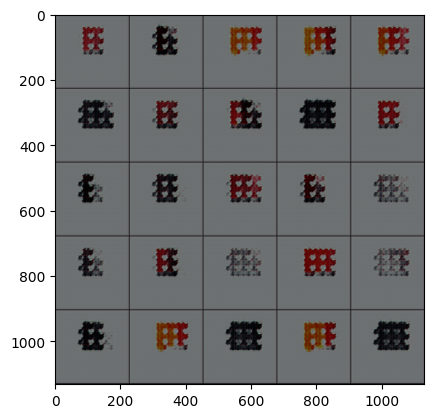

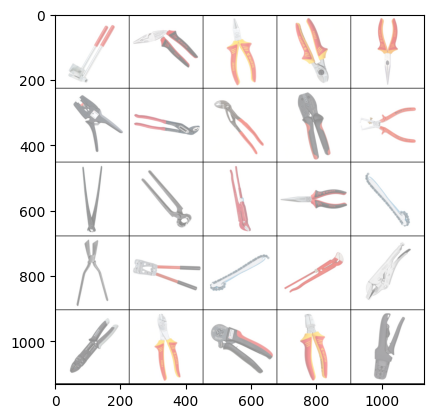

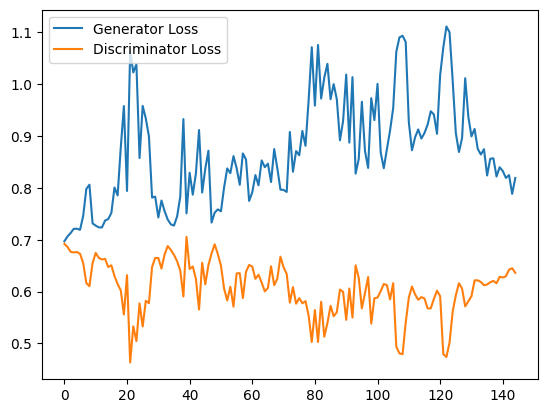

  8%|██████▍                                                                            | 2/26 [01:39<18:44, 46.83s/it]

Epoch 113, step 2940: Generator loss: 0.8022399683793385, discriminator loss: 0.6459373235702515


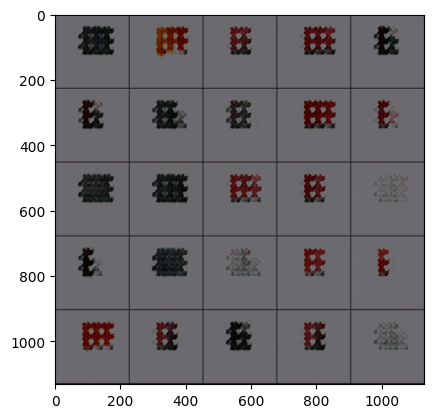

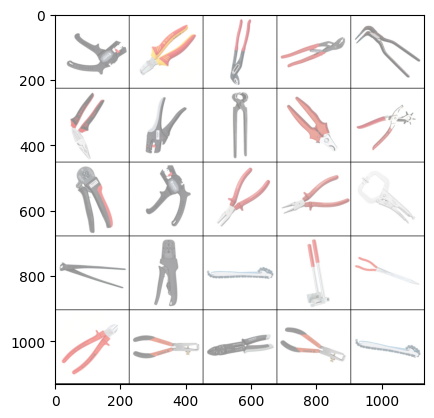

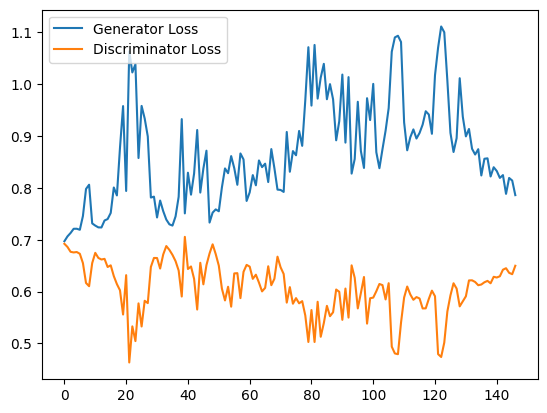

 23%|███████████████████▏                                                               | 6/26 [03:44<11:13, 33.68s/it]

Epoch 114, step 2970: Generator loss: 0.8123128672440847, discriminator loss: 0.6380787948767345


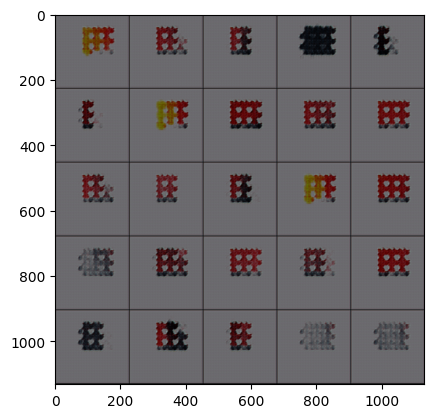

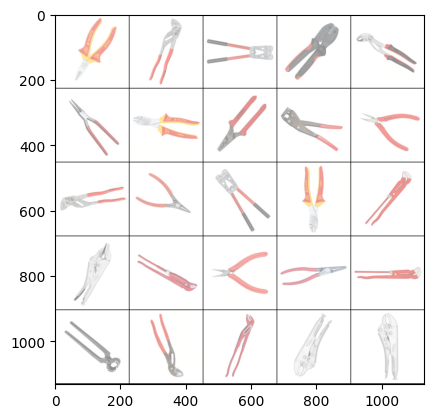

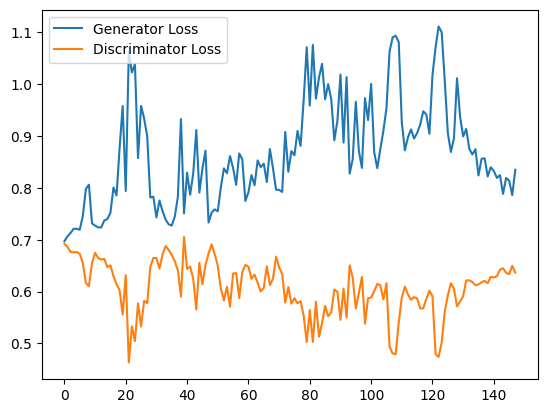

 38%|███████████████████████████████▌                                                  | 10/26 [05:52<08:36, 32.29s/it]

Epoch 115, step 3000: Generator loss: 0.7978569149971009, discriminator loss: 0.6357419649759929


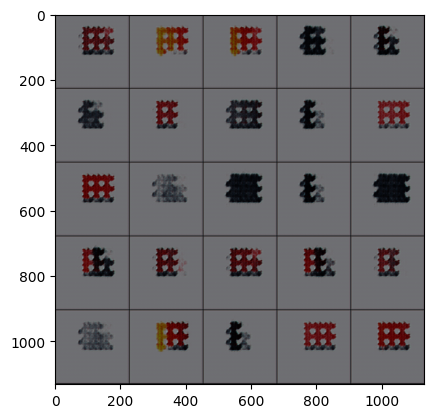

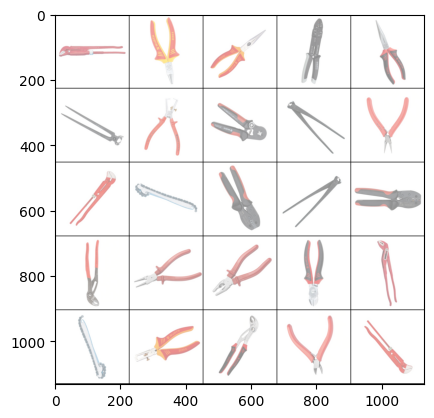

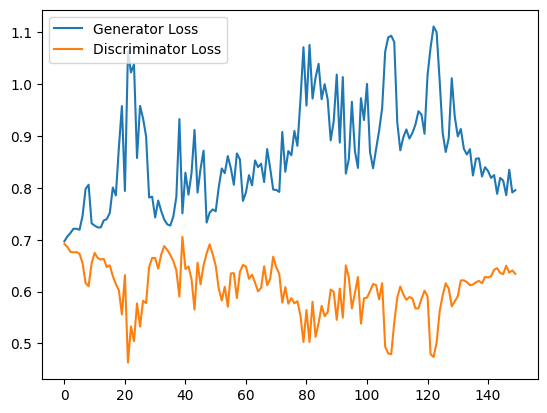

 54%|████████████████████████████████████████████▏                                     | 14/26 [07:57<06:21, 31.77s/it]

Epoch 116, step 3030: Generator loss: 0.8058384458223978, discriminator loss: 0.6238635083039602


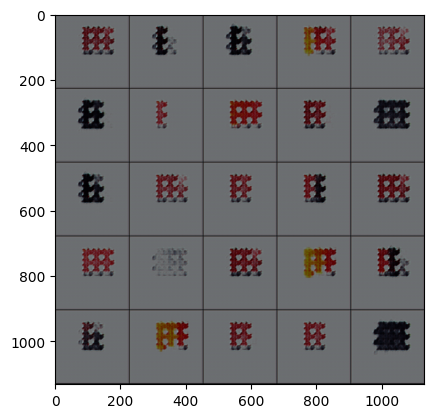

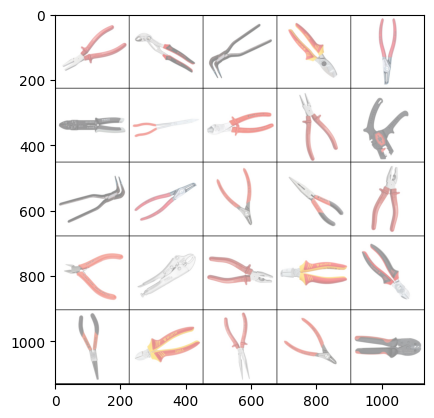

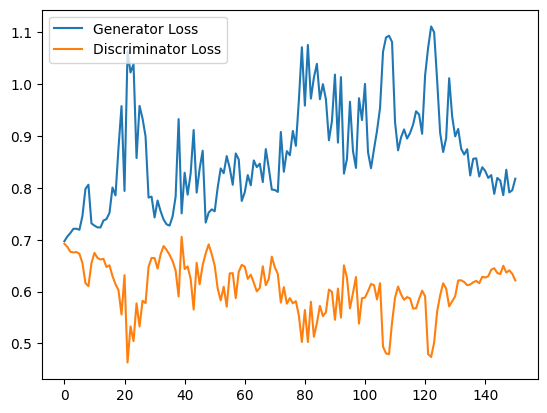

 69%|████████████████████████████████████████████████████████▊                         | 18/26 [10:08<04:14, 31.87s/it]

Epoch 117, step 3060: Generator loss: 0.8384385426839193, discriminator loss: 0.6237283011277517


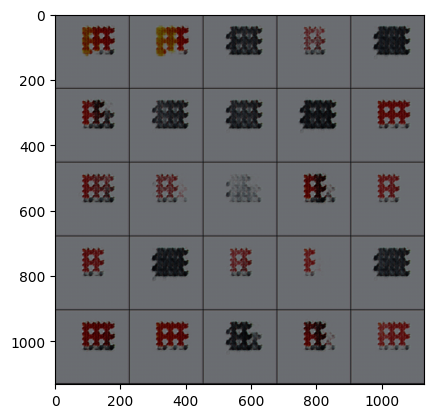

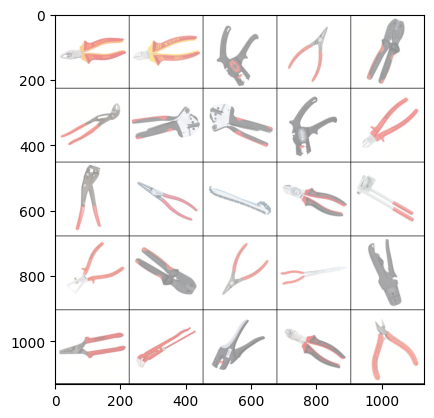

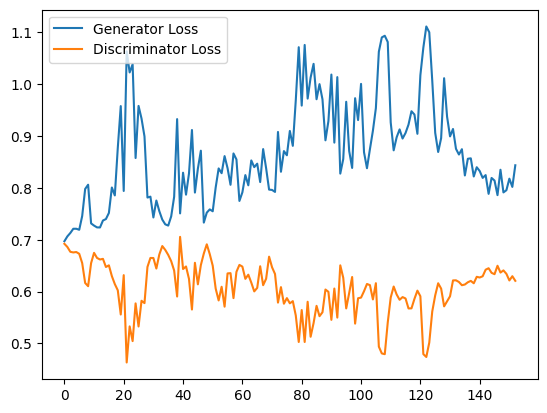

 85%|█████████████████████████████████████████████████████████████████████▍            | 22/26 [12:07<02:05, 31.34s/it]

Epoch 118, step 3090: Generator loss: 0.8077040255069733, discriminator loss: 0.6260303854942322


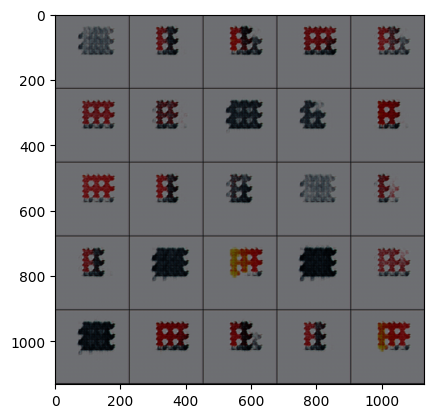

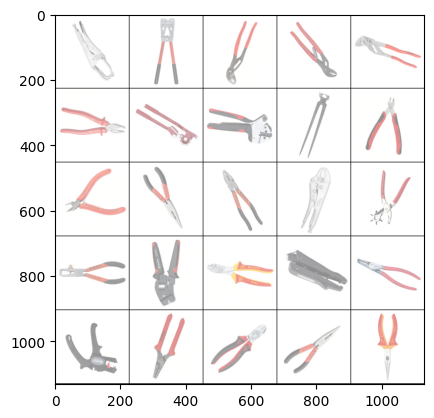

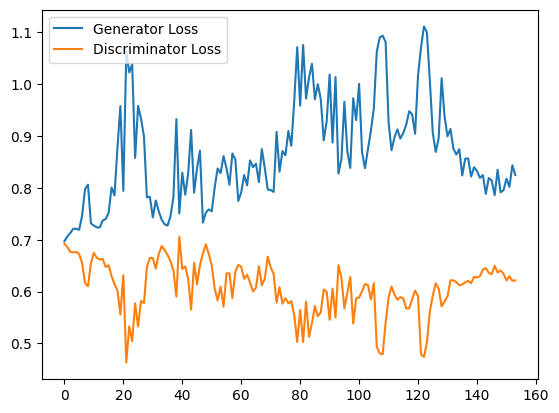

  0%|                                                                                           | 0/26 [00:00<?, ?it/s]

Epoch 120, step 3120: Generator loss: 0.8188848555088043, discriminator loss: 0.6230227371056875


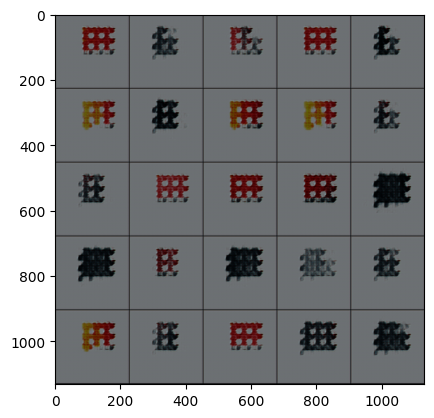

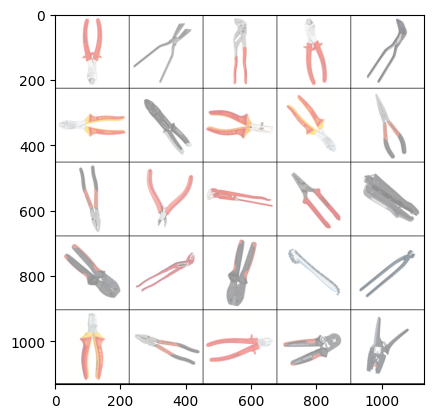

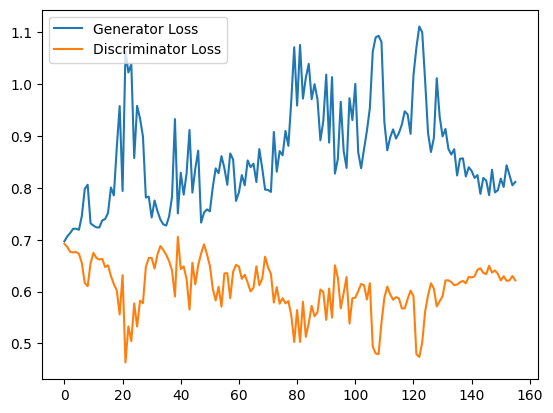

 15%|████████████▊                                                                      | 4/26 [02:40<13:16, 36.21s/it]

Epoch 121, step 3150: Generator loss: 0.8151309569676717, discriminator loss: 0.6301289180914561


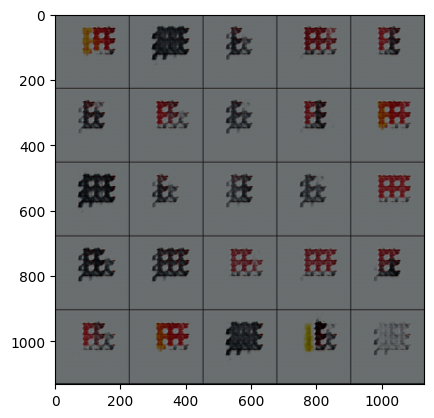

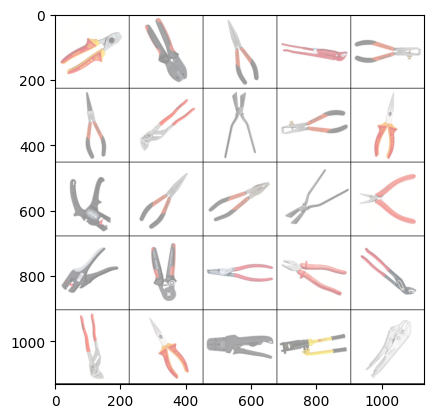

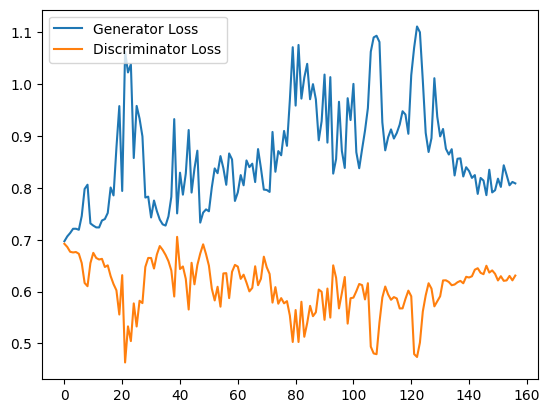

 31%|█████████████████████████▌                                                         | 8/26 [04:48<09:49, 32.74s/it]

Epoch 122, step 3180: Generator loss: 0.8114231447378795, discriminator loss: 0.6307059268156687


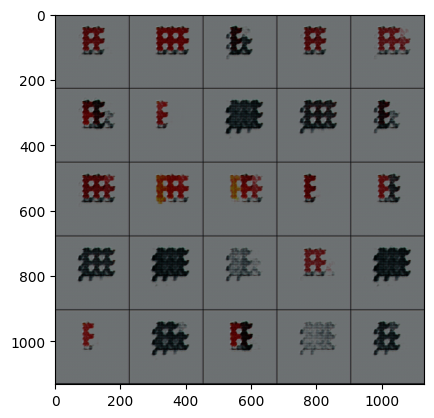

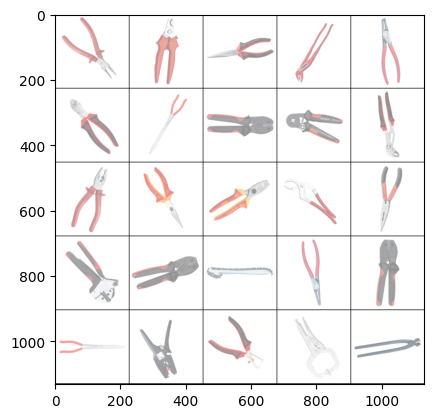

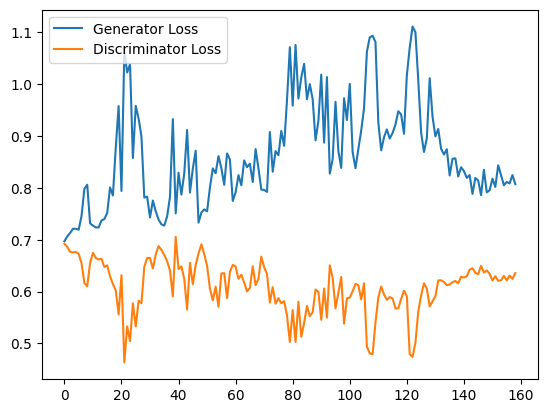

 46%|█████████████████████████████████████▊                                            | 12/26 [06:50<07:22, 31.62s/it]

Epoch 123, step 3210: Generator loss: 0.8081668297449748, discriminator loss: 0.6241079370180765


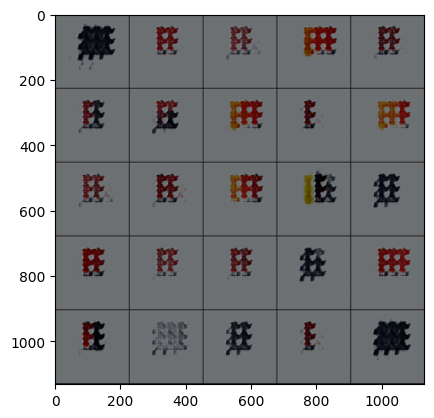

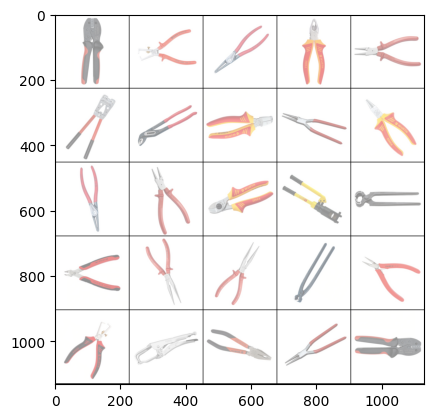

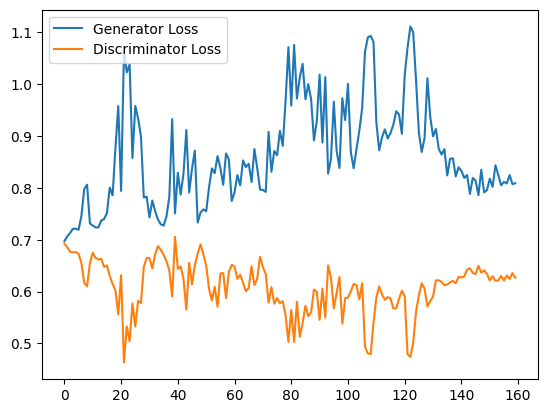

 62%|██████████████████████████████████████████████████▍                               | 16/26 [08:55<05:13, 31.36s/it]

Epoch 124, step 3240: Generator loss: 0.8208824038505554, discriminator loss: 0.6301481783390045


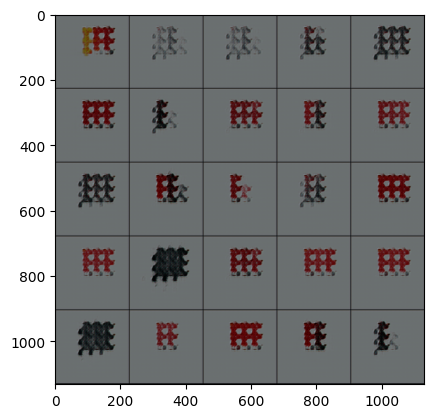

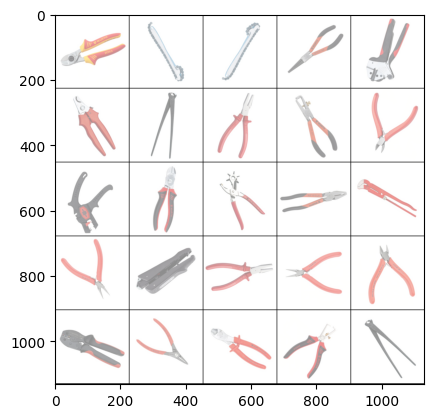

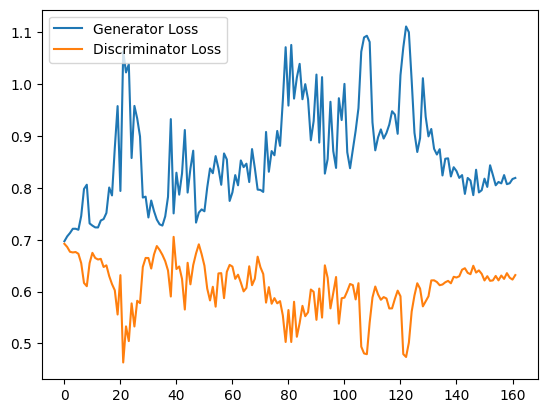

 77%|███████████████████████████████████████████████████████████████                   | 20/26 [10:59<03:07, 31.20s/it]

Epoch 125, step 3270: Generator loss: 0.8131431778271992, discriminator loss: 0.6273712833722432


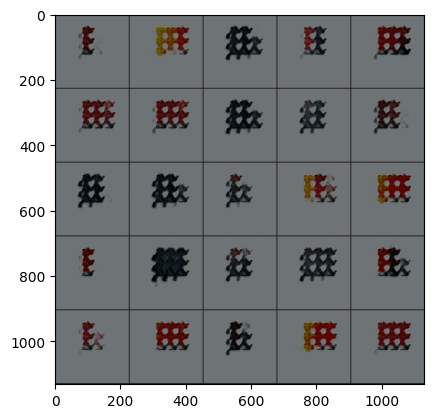

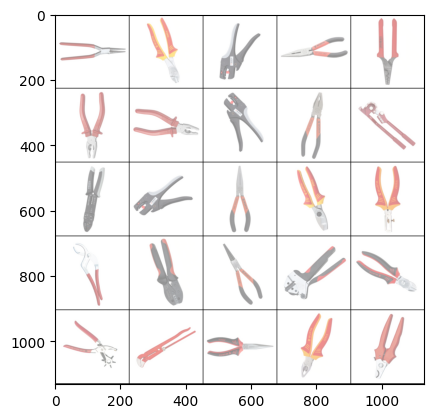

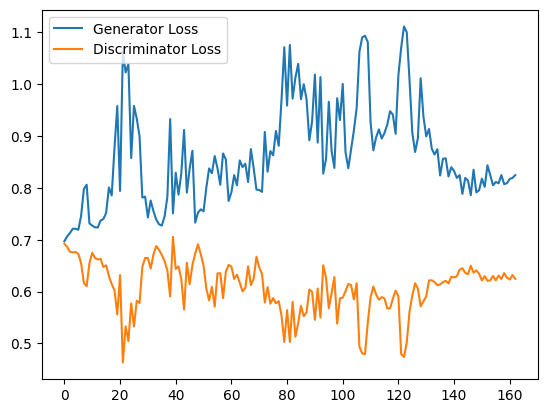

 92%|███████████████████████████████████████████████████████████████████████████▋      | 24/26 [12:57<01:01, 30.84s/it]

Epoch 126, step 3300: Generator loss: 0.8121479590733846, discriminator loss: 0.6236547509829203


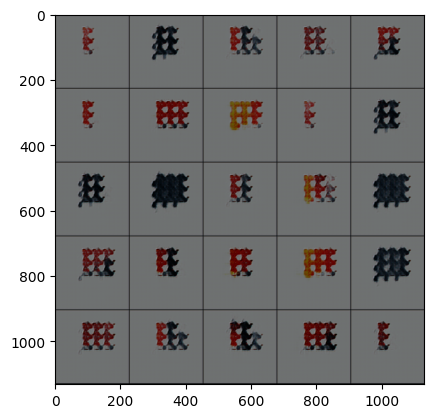

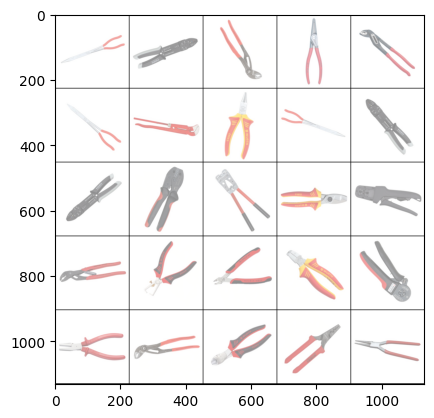

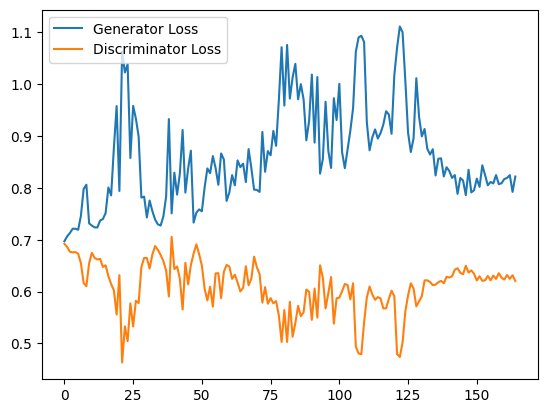

  8%|██████▍                                                                            | 2/26 [01:42<19:03, 47.65s/it]

Epoch 128, step 3330: Generator loss: 0.8217819531758627, discriminator loss: 0.6313648482163747


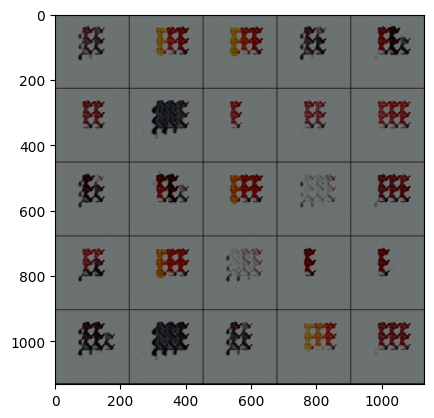

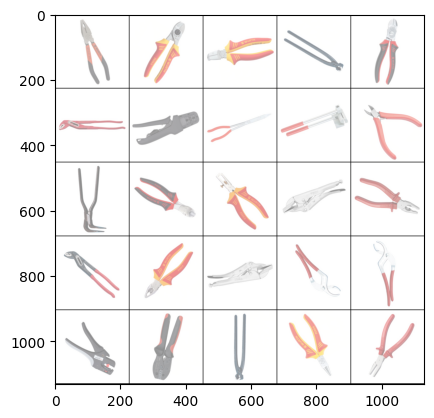

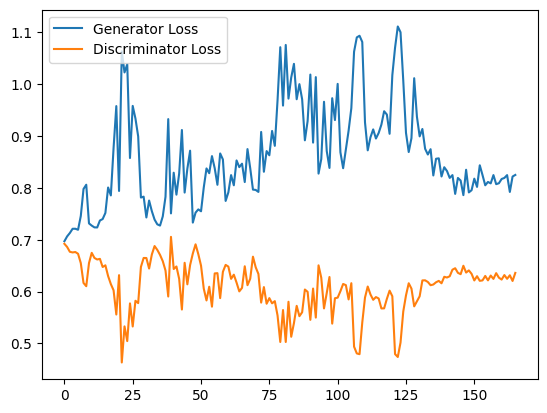

 23%|███████████████████▏                                                               | 6/26 [03:48<11:19, 33.97s/it]

Epoch 129, step 3360: Generator loss: 0.8201477666695912, discriminator loss: 0.6250196238358815


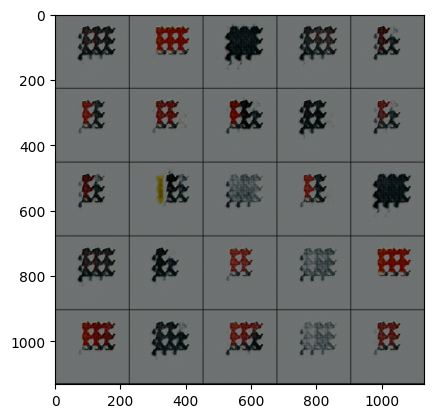

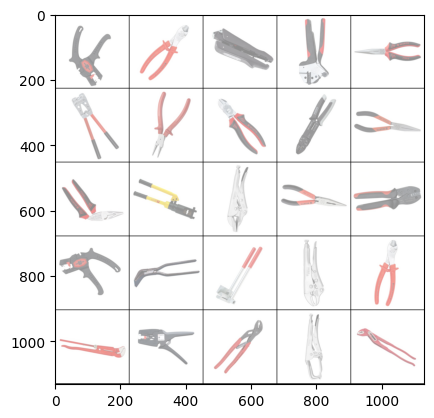

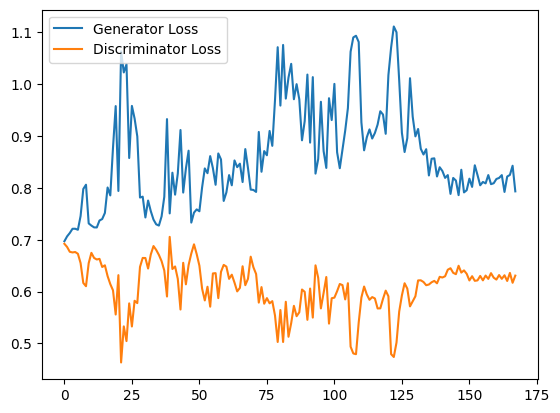

 38%|███████████████████████████████▌                                                  | 10/26 [05:55<08:34, 32.15s/it]

Epoch 130, step 3390: Generator loss: 0.8101040144761403, discriminator loss: 0.6283628861109416


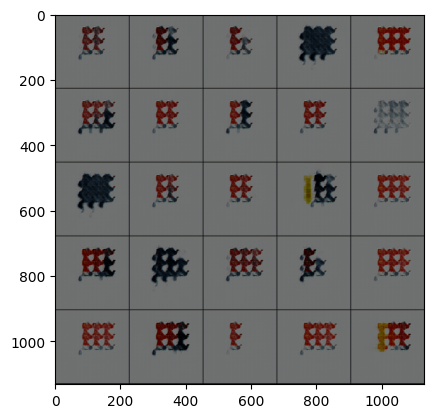

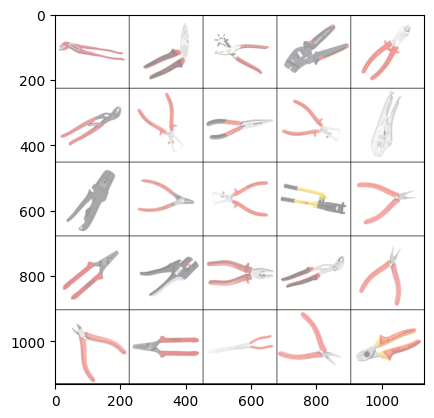

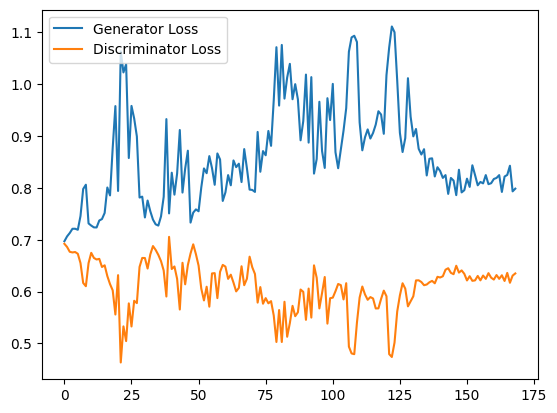

 54%|████████████████████████████████████████████▏                                     | 14/26 [07:59<06:21, 31.76s/it]

Epoch 131, step 3420: Generator loss: 0.8306099096934001, discriminator loss: 0.6343609273433686


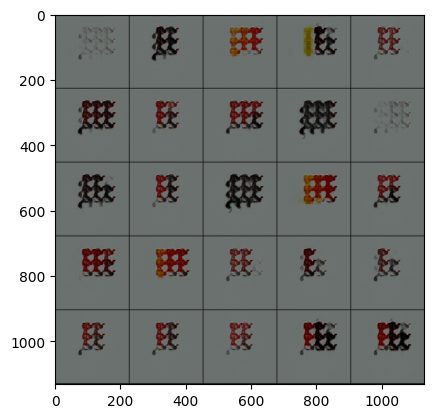

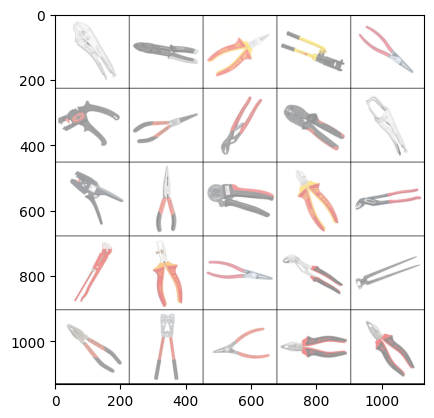

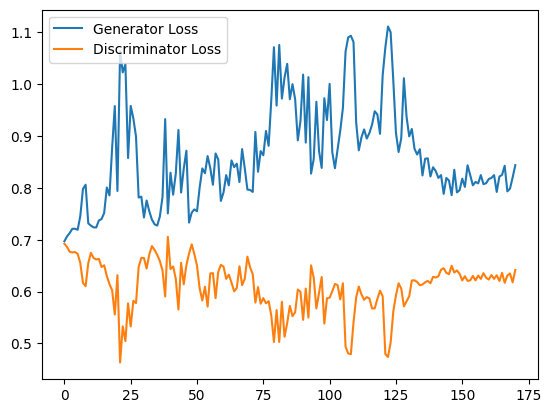

 69%|████████████████████████████████████████████████████████▊                         | 18/26 [10:06<04:13, 31.72s/it]

Epoch 132, step 3450: Generator loss: 0.8100135842959086, discriminator loss: 0.6282783548037211


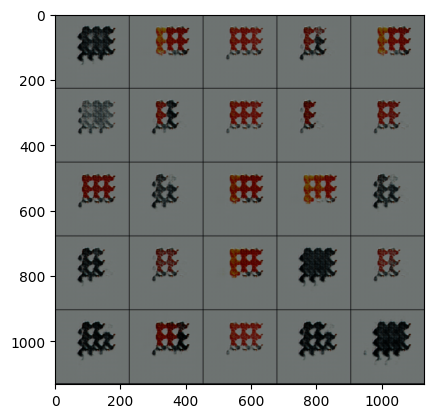

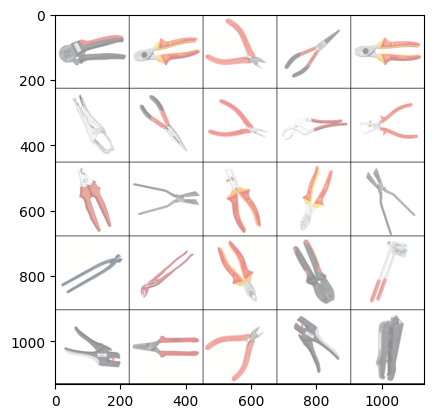

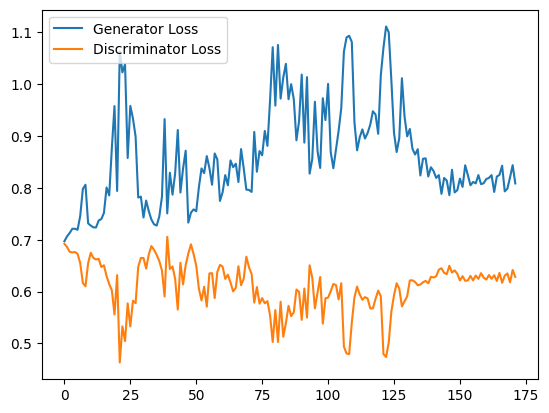

 85%|█████████████████████████████████████████████████████████████████████▍            | 22/26 [12:06<02:04, 31.12s/it]

Epoch 133, step 3480: Generator loss: 0.7916941424210866, discriminator loss: 0.6438152432441712


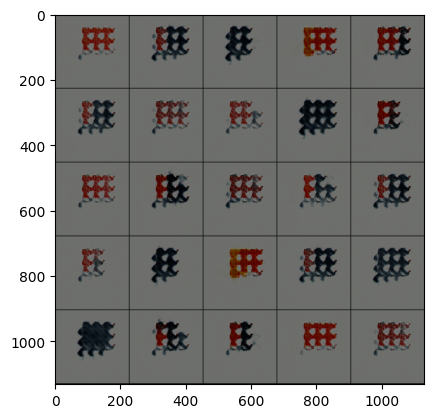

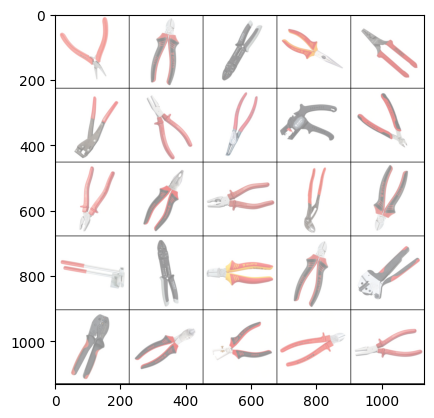

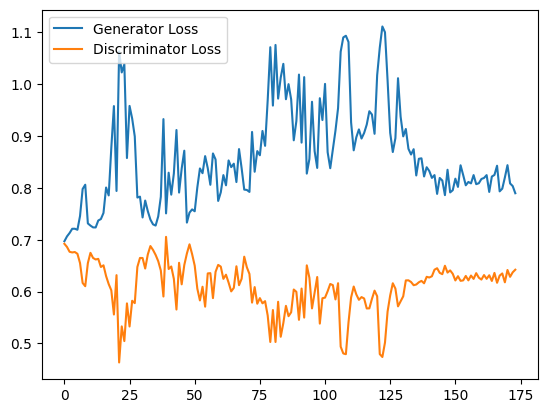

  0%|                                                                                           | 0/26 [00:00<?, ?it/s]

Epoch 135, step 3510: Generator loss: 0.8242932498455048, discriminator loss: 0.6322473208109538


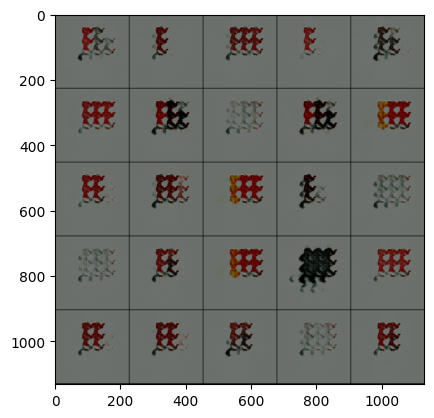

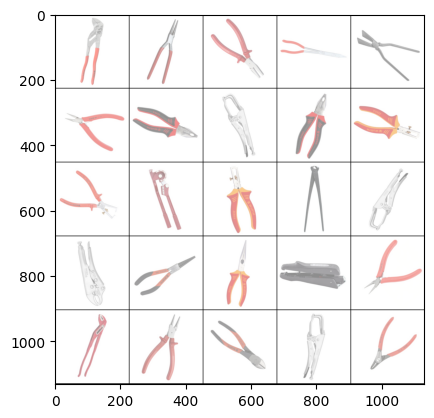

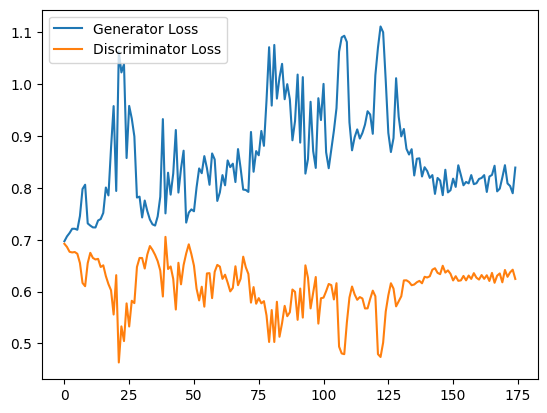

 15%|████████████▊                                                                      | 4/26 [02:43<13:20, 36.38s/it]

Epoch 136, step 3540: Generator loss: 0.8142223358154297, discriminator loss: 0.6262573381265004


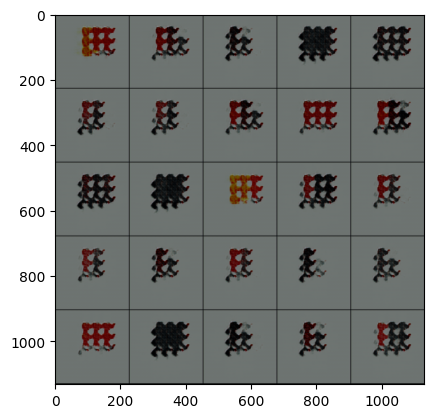

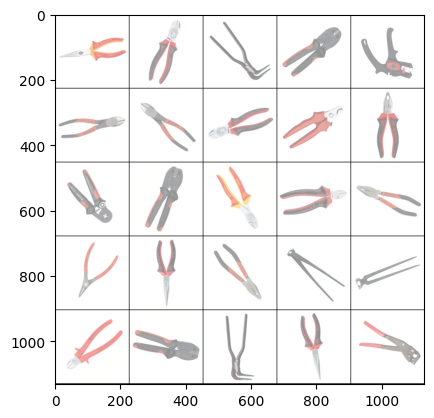

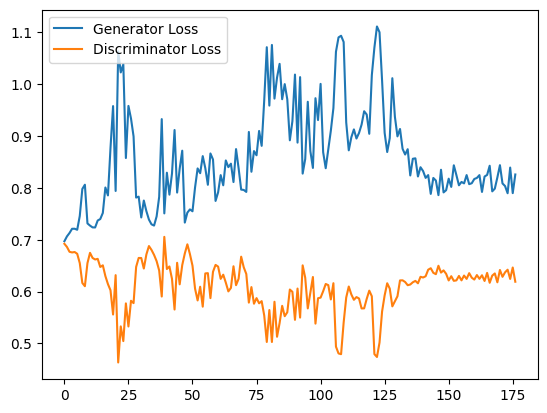

 31%|█████████████████████████▌                                                         | 8/26 [04:46<09:38, 32.13s/it]

Epoch 137, step 3570: Generator loss: 0.7838811973730723, discriminator loss: 0.6525798837343851


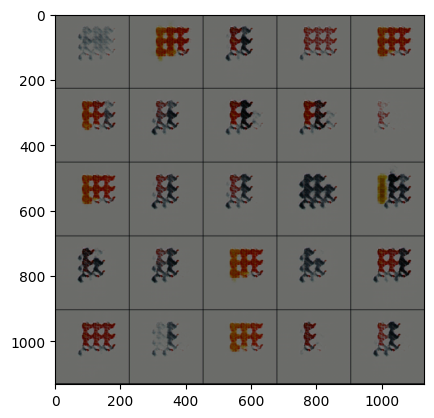

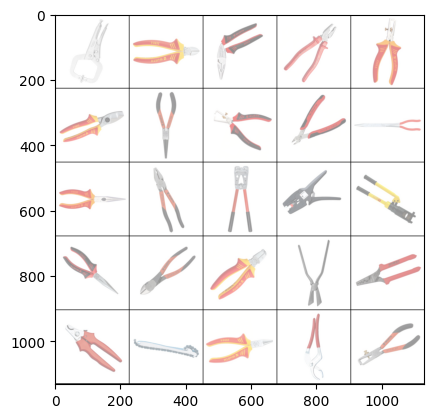

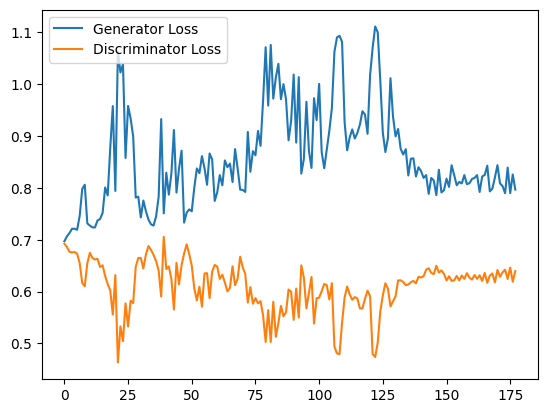

 46%|█████████████████████████████████████▊                                            | 12/26 [06:52<07:20, 31.44s/it]

Epoch 138, step 3600: Generator loss: 0.8452122370402019, discriminator loss: 0.6177143375078837


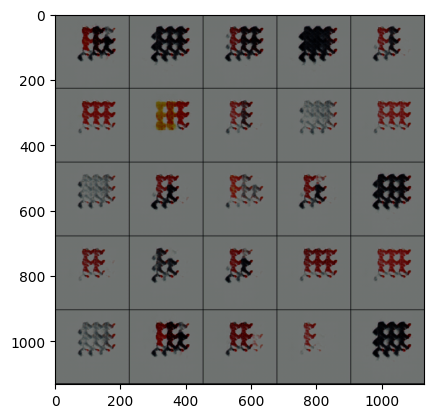

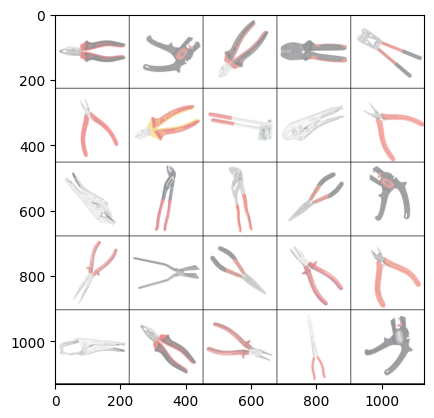

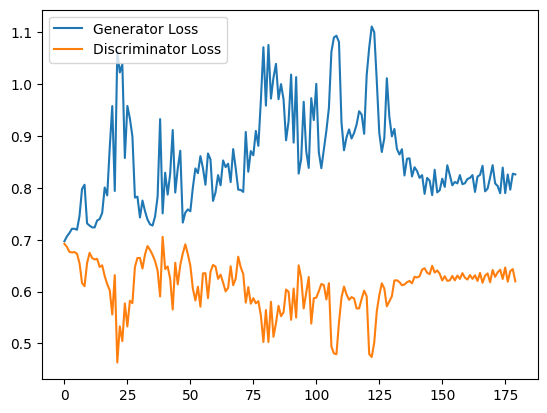

 62%|██████████████████████████████████████████████████▍                               | 16/26 [08:56<05:11, 31.19s/it]

Epoch 139, step 3630: Generator loss: 0.779704354206721, discriminator loss: 0.6486821591854095


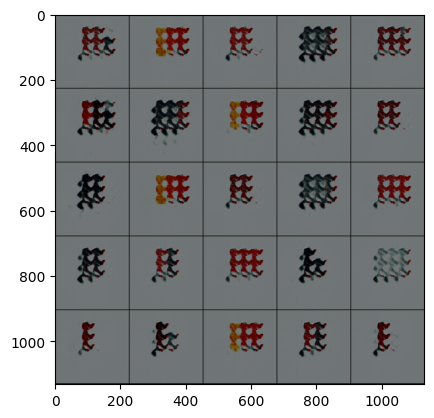

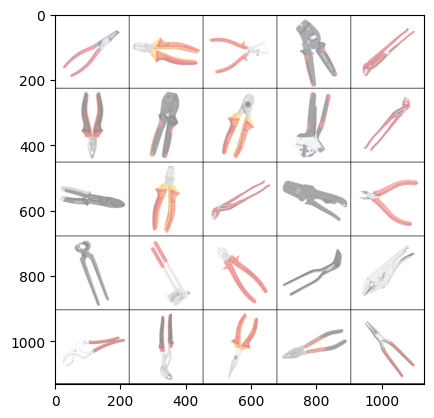

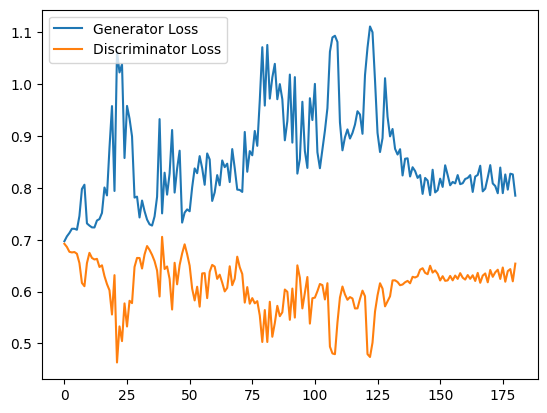

 77%|███████████████████████████████████████████████████████████████                   | 20/26 [11:11<03:07, 31.25s/it]

Epoch 140, step 3660: Generator loss: 0.796878973642985, discriminator loss: 0.6408205608526866


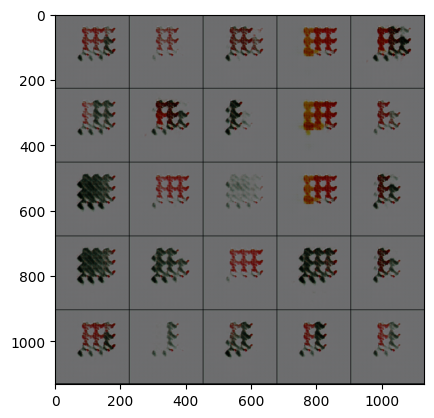

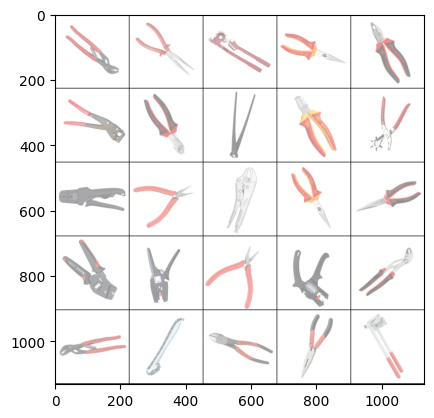

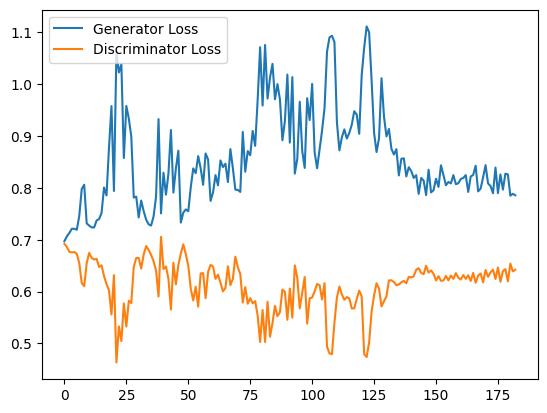

 92%|███████████████████████████████████████████████████████████████████████████▋      | 24/26 [13:08<01:02, 31.23s/it]

Epoch 141, step 3690: Generator loss: 0.8330494741598765, discriminator loss: 0.6212631861368815


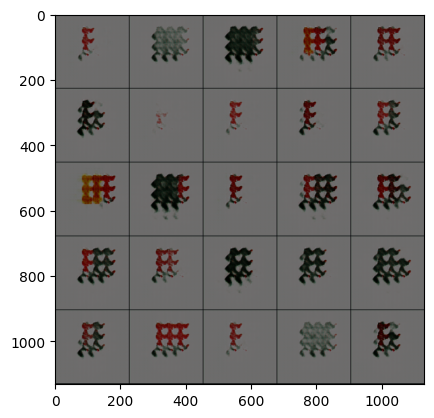

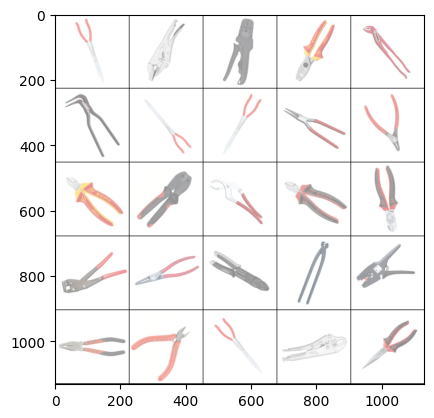

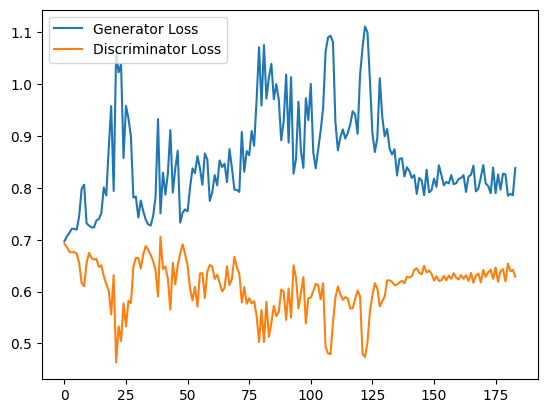

  8%|██████▍                                                                            | 2/26 [01:40<18:42, 46.76s/it]

Epoch 143, step 3720: Generator loss: 0.7893247524897258, discriminator loss: 0.6497749765714009


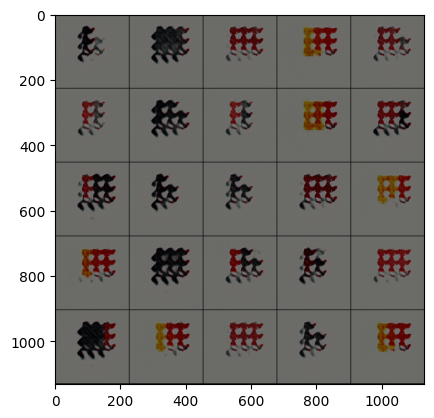

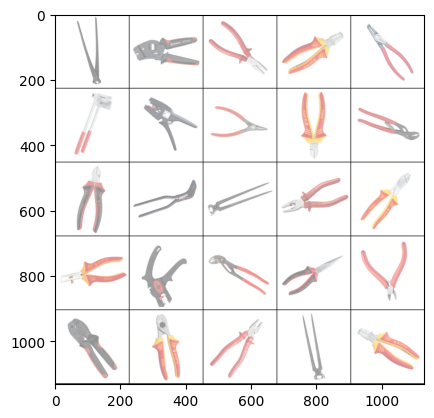

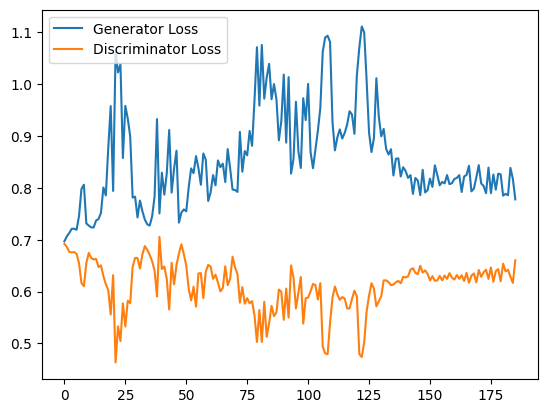

 23%|███████████████████▏                                                               | 6/26 [03:50<11:25, 34.26s/it]

Epoch 144, step 3750: Generator loss: 0.8140735328197479, discriminator loss: 0.6415516455968221


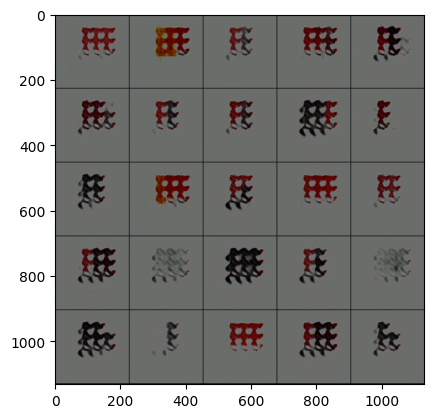

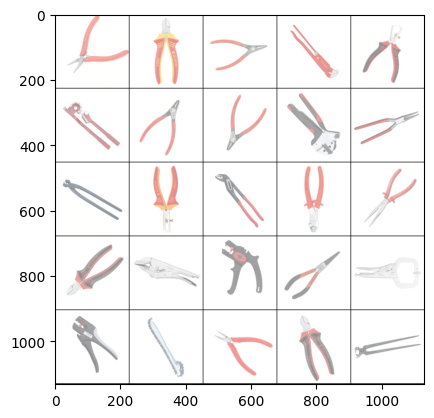

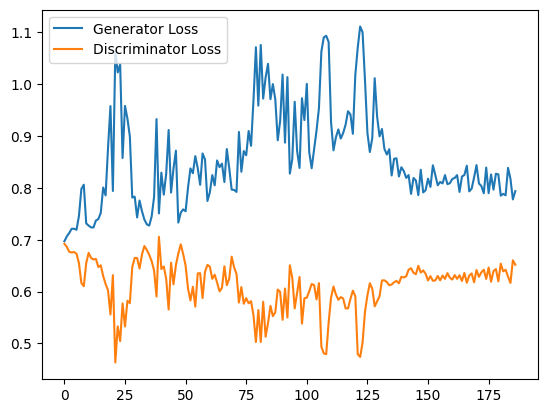

 38%|███████████████████████████████▌                                                  | 10/26 [06:04<08:45, 32.83s/it]

Epoch 145, step 3780: Generator loss: 0.8035619537035624, discriminator loss: 0.6259316325187683


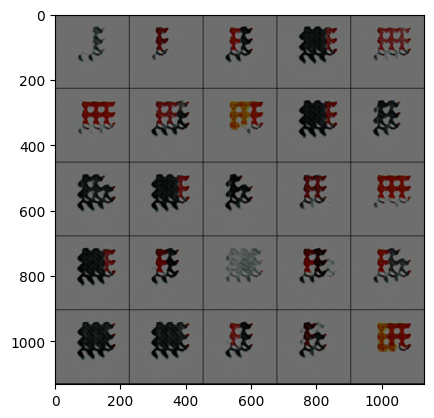

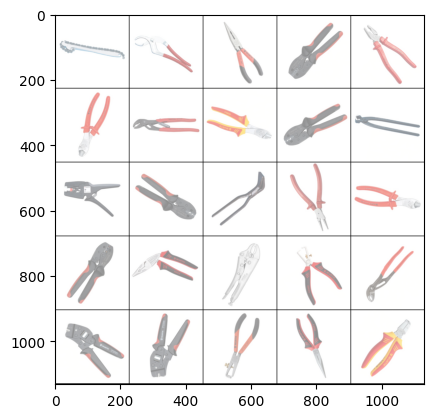

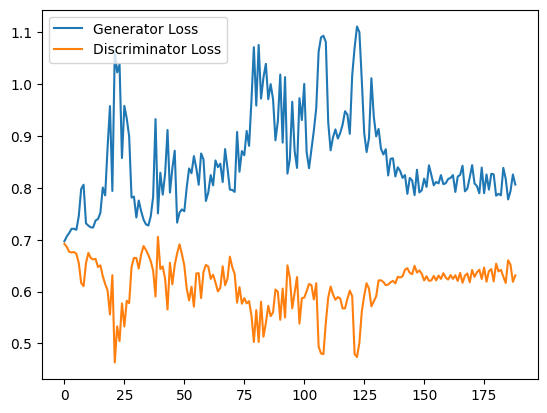

 54%|████████████████████████████████████████████▏                                     | 14/26 [08:06<06:28, 32.38s/it]

Epoch 146, step 3810: Generator loss: 0.7756884177525838, discriminator loss: 0.6454413414001465


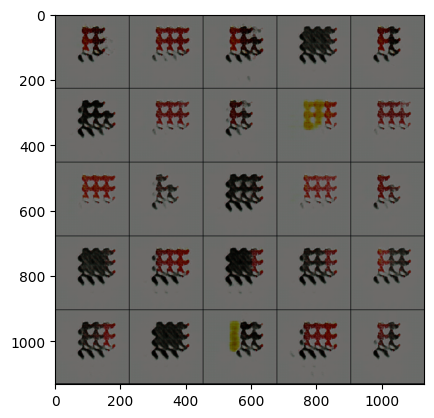

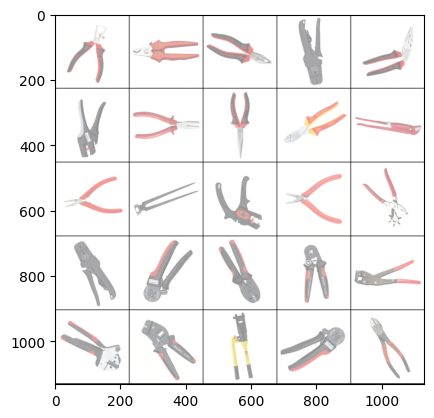

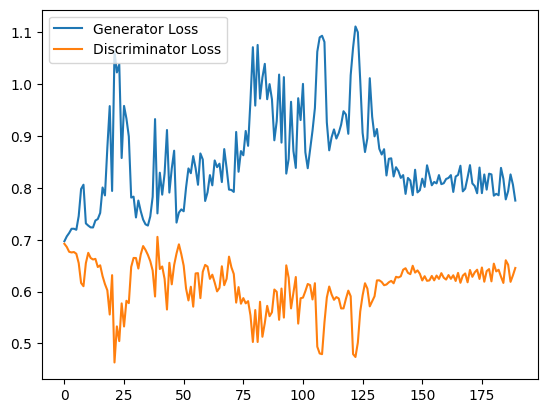

 69%|████████████████████████████████████████████████████████▊                         | 18/26 [10:19<04:19, 32.48s/it]

Epoch 147, step 3840: Generator loss: 0.8236526330312093, discriminator loss: 0.6270357112089793


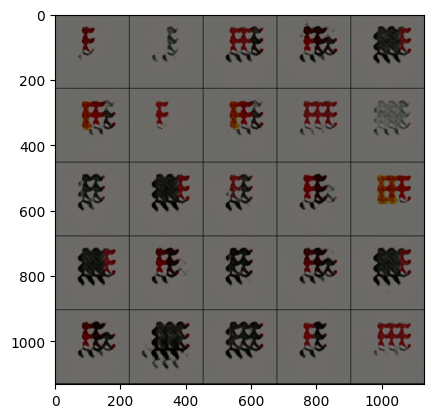

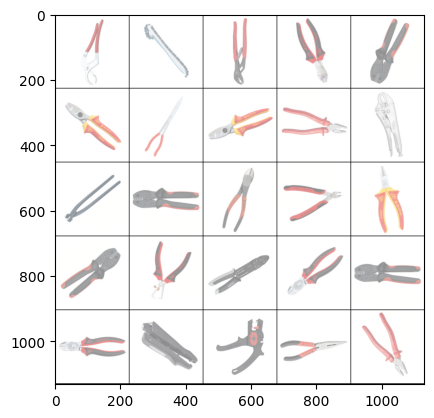

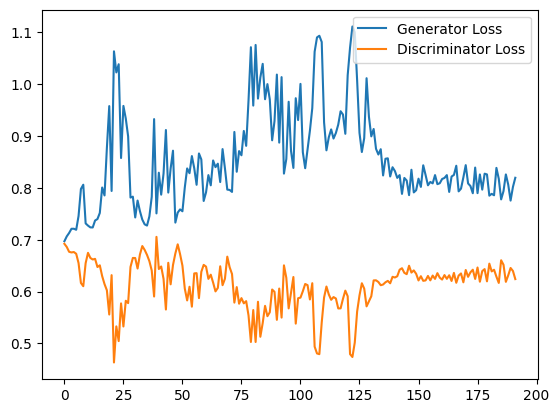

 85%|█████████████████████████████████████████████████████████████████████▍            | 22/26 [12:38<02:10, 32.58s/it]

Epoch 148, step 3870: Generator loss: 0.7915065248807271, discriminator loss: 0.6451533873875935


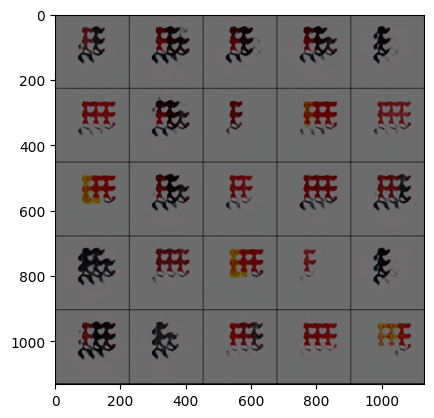

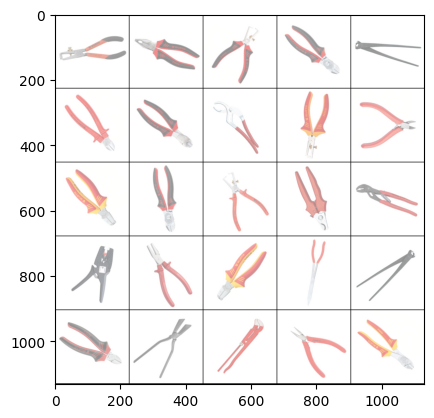

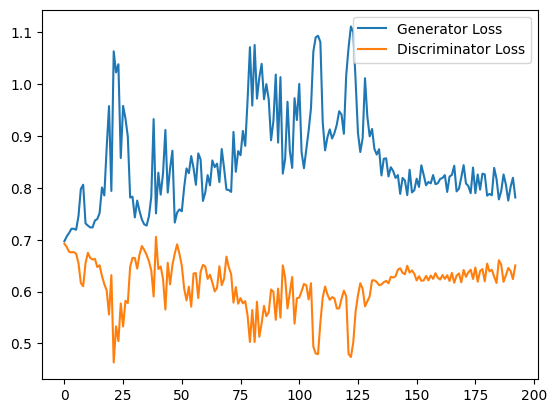

100%|██████████████████████████████████████████████████████████████████████████████████| 26/26 [14:15<00:00, 32.92s/it]


In [15]:
cur_step = 0
generator_losses = []
discriminator_losses = []

noise_and_labels = False
fake = False

fake_image_and_labels = False
real_image_and_labels = False
disc_fake_pred = False
disc_real_pred = False

for epoch in range(n_epochs):
    # Dataloader returns the batches and the labels
    for real, labels in tqdm(dataloader):
        cur_batch_size = len(real)
        # Flatten the batch of real images from the dataset
        real = real.to(device)
        #print("real.shape = ", real.shape)
        #print("labels.shape = ", labels.shape)
        

        one_hot_labels = get_one_hot_labels(labels.to(device), n_classes)
        #print("one_hot_labels.shape = ", one_hot_labels.shape)
        #print("one_hot_labels[:, :, None, None].shape = ", one_hot_labels[:, :, None, None].shape)
        image_one_hot_labels = one_hot_labels[:, :, None, None]
        image_one_hot_labels = image_one_hot_labels.repeat(1, 1, 224, 224)
        #print("image_one_hot_labels.shape = ", image_one_hot_labels.shape)

        ### Update discriminator ###
        # Zero out the discriminator gradients
        disc_opt.zero_grad()
        # Get noise corresponding to the current batch_size 
        fake_noise = get_noise(cur_batch_size, z_dim, device=device)
        
        noise_and_labels = combine_vectors(fake_noise, one_hot_labels)
        #print("fake_noise.shape = ", fake_noise.shape)
        #print("one_hot_labels.shape = ", one_hot_labels.shape)
        #print("noise_and_labels.shape = ", noise_and_labels.shape)
        fake = gen(noise_and_labels)
        #print("fake.shape = ", fake.shape)
        
        # Make sure that enough images were generated
        assert len(fake) == len(real)
        # Check that correct tensors were combined
        assert tuple(noise_and_labels.shape) == (cur_batch_size, fake_noise.shape[1] + one_hot_labels.shape[1])
        # It comes from the correct generator
        #assert tuple(fake.shape) == (len(real), 1, 28, 28)
        assert tuple(fake.shape) == (len(real), 3, 224, 224)
        
        fake_image_and_labels = combine_vectors(fake, image_one_hot_labels)
        real_image_and_labels = combine_vectors(real, image_one_hot_labels)
        disc_fake_pred = disc(fake_image_and_labels.detach())
        disc_real_pred = disc(real_image_and_labels)
        
        disc_fake_loss = criterion(disc_fake_pred, torch.zeros_like(disc_fake_pred))
        disc_real_loss = criterion(disc_real_pred, torch.ones_like(disc_real_pred))
        disc_loss = (disc_fake_loss + disc_real_loss) / 2
        disc_loss.backward(retain_graph=True)
        disc_opt.step() 

        # Keep track of the average discriminator loss
        discriminator_losses += [disc_loss.item()]

        ### Update generator ###
        # Zero out the generator gradients
        gen_opt.zero_grad()

        fake_image_and_labels = combine_vectors(fake, image_one_hot_labels)
        
        disc_fake_pred = disc(fake_image_and_labels)
        gen_loss = criterion(disc_fake_pred, torch.ones_like(disc_fake_pred))
        gen_loss.backward()
        gen_opt.step()

        # Keep track of the generator losses
        generator_losses += [gen_loss.item()]
        #
        #print(cur_step, display_step)
        if cur_step % display_step == 0 and cur_step > 0:
            gen_mean = sum(generator_losses[-display_step:]) / display_step
            disc_mean = sum(discriminator_losses[-display_step:]) / display_step
            print(f"Epoch {epoch}, step {cur_step}: Generator loss: {gen_mean}, discriminator loss: {disc_mean}")
            show_tensor_images(fake)
            show_tensor_images(real)
            step_bins = 20
            x_axis = sorted([i * step_bins for i in range(len(generator_losses) // step_bins)] * step_bins)
            num_examples = (len(generator_losses) // step_bins) * step_bins
            plt.plot(
                range(num_examples // step_bins), 
                torch.Tensor(generator_losses[:num_examples]).view(-1, step_bins).mean(1),
                label="Generator Loss"
            )
            plt.plot(
                range(num_examples // step_bins), 
                torch.Tensor(discriminator_losses[:num_examples]).view(-1, step_bins).mean(1),
                label="Discriminator Loss"
            )
            plt.legend()
            plt.show()
        elif cur_step == 0:
            print("It's working")
        cur_step += 1

### Save

In [17]:
# Save the generator and discriminator states
torch.save(gen.state_dict(), 'wgan_generator.pth')
torch.save(disc.state_dict(), 'wgan_discriminator.pth')

## Exploration
You can do a bit of exploration now!

In [18]:
gen = gen.eval()

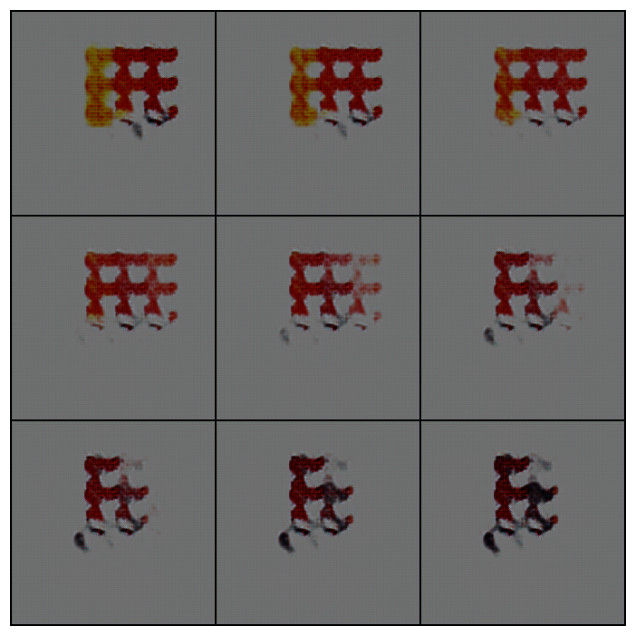

In [19]:
import math

n_interpolation = 9
interpolation_noise = get_noise(1, z_dim, device=device).repeat(n_interpolation, 1)

def interpolate_class(first_number, second_number):
    first_label = get_one_hot_labels(torch.Tensor([first_number]).long(), n_classes)
    second_label = get_one_hot_labels(torch.Tensor([second_number]).long(), n_classes)

    # Calculate the interpolation vector between the two labels
    percent_second_label = torch.linspace(0, 1, n_interpolation)[:, None]
    interpolation_labels = first_label * (1 - percent_second_label) + second_label * percent_second_label

    # Combine the noise and the labels
    noise_and_labels = combine_vectors(interpolation_noise, interpolation_labels.to(device))
    fake = gen(noise_and_labels)
    show_tensor_images(fake, num_images=n_interpolation, nrow=int(math.sqrt(n_interpolation)), show=False)


start_plot_number = 1 # Choose the start digit
end_plot_number = 5 # Choose the end digit

plt.figure(figsize=(8, 8))
interpolate_class(start_plot_number, end_plot_number)
_ = plt.axis('off')

#### Changing the Noise Vector

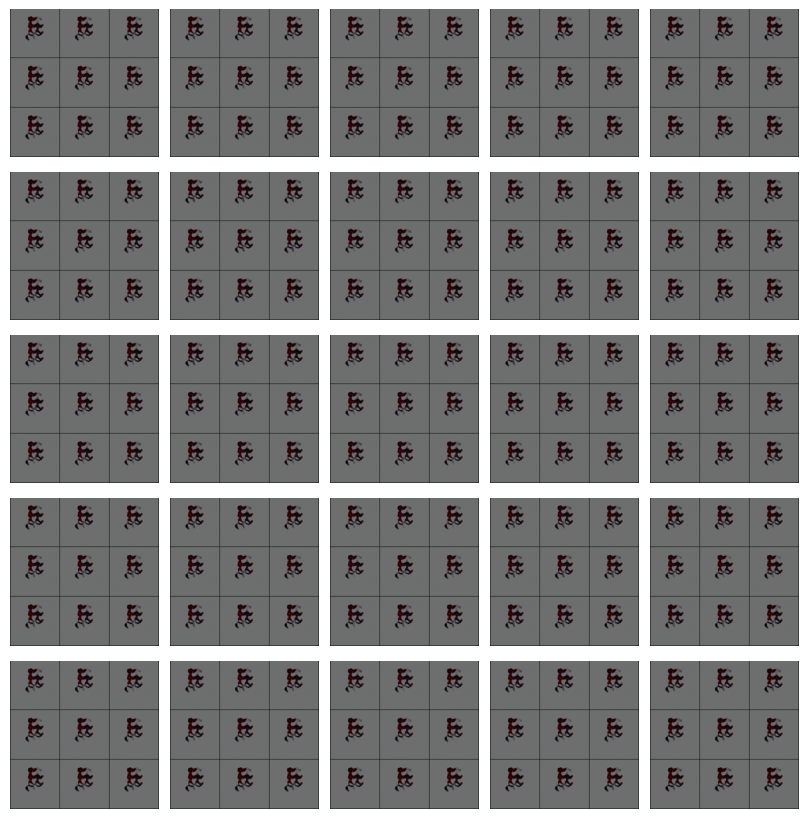

In [20]:
n_interpolation = 9

interpolation_label = get_one_hot_labels(torch.Tensor([5]).long(), n_classes).repeat(n_interpolation, 1).float()

def interpolate_noise(first_noise, second_noise):
    # This time you're interpolating between the noise instead of the labels
    percent_first_noise = torch.linspace(0, 1, n_interpolation)[:, None].to(device)
    interpolation_noise = first_noise * percent_first_noise + second_noise * (1 - percent_first_noise)

    # Combine the noise and the labels again
    noise_and_labels = combine_vectors(interpolation_noise, interpolation_label.to(device))
    fake = gen(noise_and_labels)
    show_tensor_images(fake, num_images=n_interpolation, nrow=int(math.sqrt(n_interpolation)), show=False)

# Generate noise vectors to interpolate between
n_noise = 5 # Choose the number of noise examples in the grid
plot_noises = [get_noise(1, z_dim, device=device) for i in range(n_noise)]
plt.figure(figsize=(8, 8))
for i, first_plot_noise in enumerate(plot_noises):
    for j, second_plot_noise in enumerate(plot_noises):
        plt.subplot(n_noise, n_noise, i * n_noise + j + 1)
        interpolate_noise(first_plot_noise, second_plot_noise)
        plt.axis('off')
plt.subplots_adjust(top=1, bottom=0, left=0, right=1, hspace=0.1, wspace=0)
plt.show()
plt.close()